In [1]:
import sys

sys.path.append('../../../common_code')
from PostProcessingScripts import * 
from formation_channels import * 
import astropy.stats

from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

##########
# define colors for formation channels 
channelColorDict = {'classic':'#118AB2', 'stable B no CEE':'orange',  'immediate CE': '#EF476F'  , r'double-core CE':'#073B4C', 'other':'gray', 'vi':'cyan', 'vii':'#FFD166'}
List_formationchannelOptions = ['All',  'classic',  'stable B no CEE',  'immediate CE',  r'double-core CE', 'vi', 'vii', 'other']
ind_formationchannelOptions = [7,  1, 2, 3, 4, 5, 6, 0]
dictFormationChannelIndex =  {List_formationchannelOptions[i]: ind_formationchannelOptions[i] for i in range(len(List_formationchannelOptions))}

channelColorDict_lighter = {'classic':adjust_lightness(color='#118AB2', amount=1.6),'stable B no CEE':adjust_lightness(color='orange', amount=1.4), 'immediate CE':adjust_lightness(color='#EF476F', amount=1.2),\
                            r'double-core CE':adjust_lightness(color='#073B4C', amount=1.8), 'other':adjust_lightness(color='gray', amount=1.5),  'vi':adjust_lightness(color='cyan', amount=1.5), 'vii':adjust_lightness(color='#FFD166', amount=1.2)}
channelList = ['classic', 'stable B no CEE', 'vii',  'immediate CE',  r'double-core CE', 'other'] #, 'vi']
#######


In [2]:
def obtain_redshiftsruns(pathData = '/Volumes/SimonsFoundation/DataDCO/'):
    BPSmodelName='B'
    DCOtype='BNS'
    path_ = '/Volumes/SimonsFoundation/DataDCO/' + alphabetDirDict[BPSmodelName] +'/'
    path  = path_ + 'COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    fdata = h5.File(path, 'r')
    redshifts = fdata['redshifts']['redshift'][...].squeeze()
    fdata.close()
    return redshifts 





adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run 
print('available redshifts:', redshifts_runs) 


available redshifts: [0.19230769 0.57692308 0.96153846 1.34615385 1.73076923 2.11538462
 2.5        2.88461538 3.26923077 3.65384615 4.03846154 4.42307692
 4.80769231 5.19230769 5.57692308 5.96153846 6.34615385 6.73076923
 7.11538462 7.5        7.88461538 8.26923077 8.65384615 9.03846154
 9.42307692 9.80769231]


In [3]:
# s1 = pd.Series(['a', 'b'])
# s2 = pd.Series(['c', 'd'])
# A = pd.concat([s1, s2], axis=1)

# print(A)

In [4]:
import pandas as pd

def create_pd_metallicity_xparam(DCOtype='BHNS', BPSmodelName='A', pathData='/Volumes/SimonsFoundation/DataDCO/', quantile_values=[0.5, 0.25, 0.75]):
    """
    whichplot='rate', 'ratio'
    
    """

    pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
    redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
    adjustedChannelList = ['classic', 'stable B no CEE']#, 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    fdata = h5.File(full_data_path,'r')     # read in data 
    
    # get the delay time in Gyr 
    param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
    channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()
    metallicities = fdata['doubleCompactObjects']['Metallicity1'][...].squeeze()
    weights_ =  fdata['doubleCompactObjects']['weight'][...].squeeze()
    #     param_x = np.log10(param_x)
    

    
    nZ = len(np.unique(metallicities))
    fc_data = np.zeros((nZ, 1)) # create empty dataset for metallicities
    fc_data[:,0] = np.unique(metallicities)  # fill with metallicity data 
    df = pd.DataFrame(fc_data, columns=["metallicity"])
    print(len(df["metallicity"]),  ' = 53?')

    for nrC, Channel in enumerate(adjustedChannelList): 
        # obtain fc_mask for the requested channel name 
        ind_wanted = dictFormationChannelIndex[Channel]
        mask_MRR = (channels==ind_wanted)
        print('at Channel ', Channel)
#         for ind_q, quantile in enumerate(quantiles):
        data_to_add = np.zeros((nZ, len(quantile_values)))
        data_to_add[:] = np.nan # start with nan values so that we do not plot datapoint if it doesnt exist 
        column_names = [Channel + ' q_' + str(quantile_values[i]) for i in range(len(quantile_values))] # creates array with header names 

        for ind_Z, Zvalue in enumerate(np.unique(metallicities)):
            mask_ZZ = metallicities[mask_MRR]==Zvalue
            if len(weights_[mask_MRR][mask_ZZ])>10:            
                data_to_add[ind_Z] = weighted_quantile(values=param_x[mask_MRR][mask_ZZ], quantiles=quantile_values, sample_weight=weights_[mask_MRR][mask_ZZ])
                
            
#         print('old df', df)
        df_to_add = pd.DataFrame(data_to_add, columns=column_names)
#         print('to add df', df_to_add)
        df = pd.concat([df, df_to_add], axis=1)
#         print('new df', df)

    # always close the dataset
    fdata.close()

    return df

DCOtype='BHNS'
BPSmodelName='A'
quantile_values=[0.5, 0.25, 0.75]

df = create_pd_metallicity_xparam(quantile_values=quantile_values, BPSmodelName=BPSmodelName, DCOtype=DCOtype)






53  = 53?
at Channel  classic
at Channel  stable B no CEE


In [ ]:
print(df["metallicity"].values)

at BPS model  A

at DCOtype = BBH
51  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.1267933  0.14314915 0.13567654 0.12403931 0.12997068 0.13774206
 0.14758958 0.15905574 0.16338895 0.16778032 0.17357527 0.1790218
 0.18368276 0.18849072 0.18703138 0.18836411 0.18478115 0.18279276
 0.18468174 0.17841333 0.17351482 0.17725682 0.19840883 0.21548918
 0.2215621  0.2314229  0.24315504 0.26013312 0.27270209 0.3012555
 0.33901279 0.41672747 0.45596848 0.45794098 0.43669437 0.33313992
 0.30752317 0.39498754 0.49726532 0.72964127 1.18800814 1.77879282
 1.67870621 1.23142947 1.43818112 1.56931077 1.31335427        nan
        nan        nan        nan]


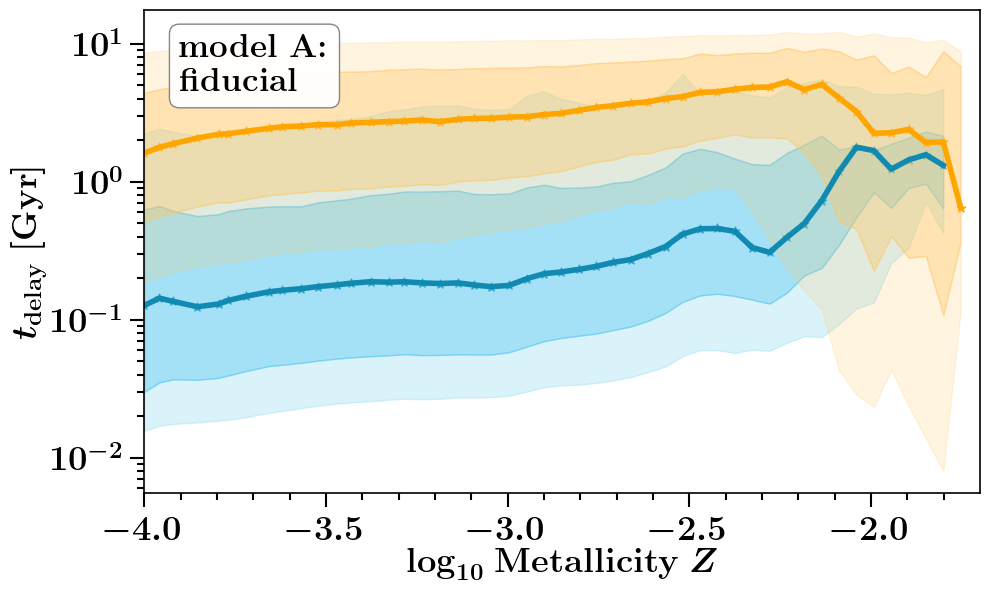

at BPS model  B

at DCOtype = BBH
52  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.06055938 0.07227297 0.07703728 0.07763737 0.08043613 0.08267077
 0.09044637 0.09752438 0.10101404 0.1072657  0.1120107  0.1185504
 0.12229252 0.12937328 0.13286509 0.13598619 0.13667279 0.13894376
 0.1381907  0.13317887 0.13250835 0.13363542 0.14352438 0.15249473
 0.16027025 0.16940462 0.17777343 0.19210176 0.20337624 0.22749237
 0.24693628 0.26901778 0.29394013 0.31740818 0.33290709 0.3060982
 0.25191487 0.28696236 0.45608537 0.70504795 1.13922977 1.76751456
 1.66245381 1.2394334  1.47545762 1.50008358 2.10127489        nan
        nan        nan        nan 4.52274748]


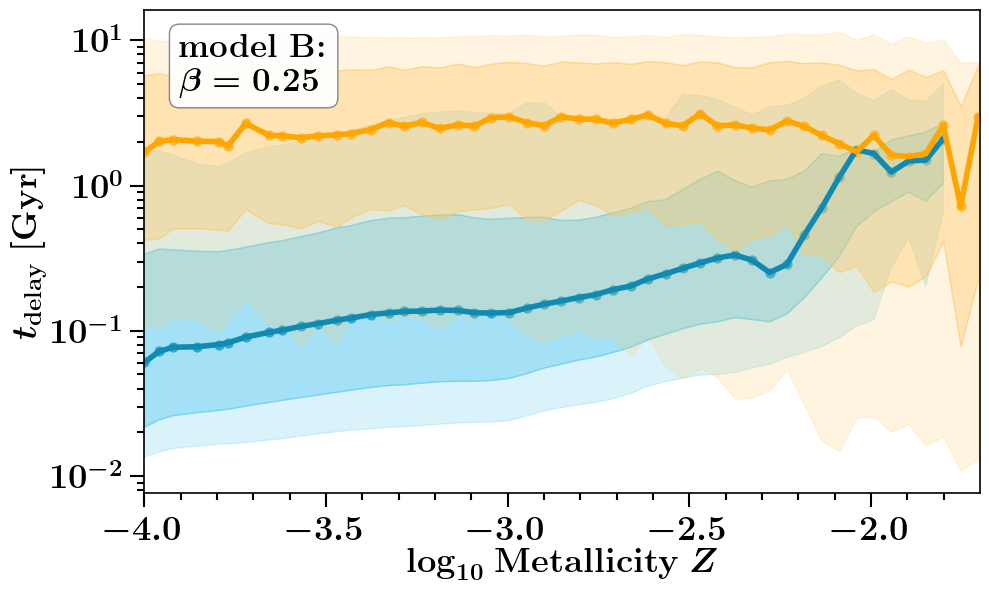

at BPS model  C

at DCOtype = BBH
52  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.083707   0.10025999 0.10660329 0.1031801  0.10861623 0.11173851
 0.12466464 0.13781396 0.14437933 0.15283339 0.16014615 0.16516879
 0.16979182 0.17587547 0.17847184 0.17321802 0.17751251 0.18659348
 0.20257778 0.20672897 0.20687048 0.20557728 0.21556337 0.18973958
 0.17328523 0.16016575 0.15019541 0.14263943 0.14535749 0.14916491
 0.15721172 0.20208489 0.24606644 0.24743494 0.2264755  0.21591273
 0.16276437 0.17700847 0.3174656  0.78552821 1.19202612 1.78846486
 1.68358273 1.25097384 1.46011355 1.62744447 3.15366467        nan
        nan        nan        nan        nan]


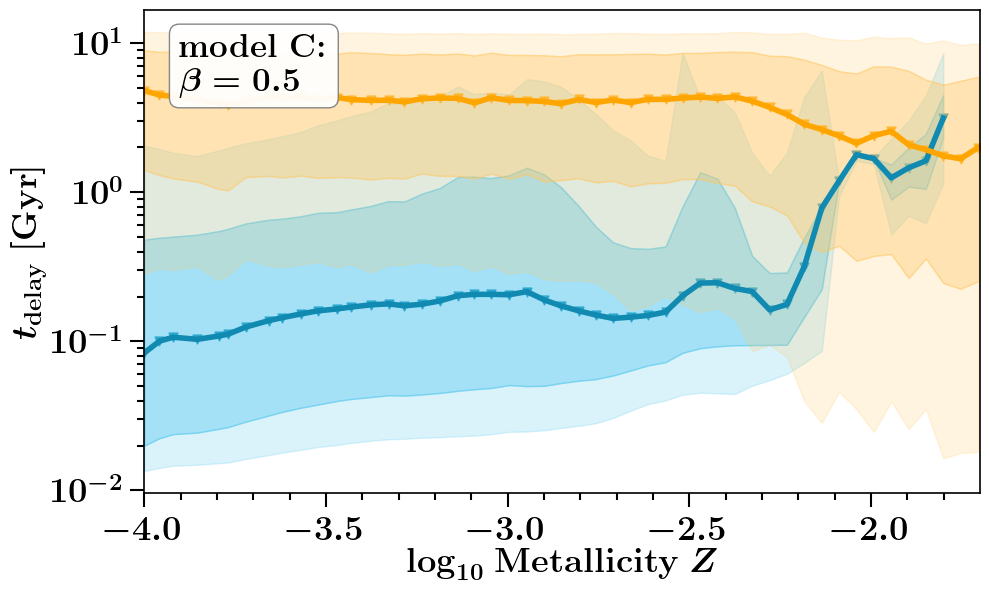

at BPS model  D

at DCOtype = BBH
51  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.19749974 0.21361598 0.20603274 0.18623108 0.18317587 0.18936371
 0.21653914 0.23519378 0.24800928 0.26250991 0.27618781 0.29013538
 0.29335182 0.30095816 0.30397925 0.28891632 0.28446713 0.28139103
 0.30167453 0.29503556 0.286503   0.30823856 0.40939098 0.45112912
 0.48373322 0.4680198  0.35990632 0.23439372 0.16343734 0.13085932
 0.10666885 0.207849   1.26363847 1.52484225 0.75985558 0.30159338
 0.15708139 0.22403944 0.49448845 0.80115718 1.1923566  1.78980363
 1.68465758 1.27349616 1.43014276 1.60857404 1.22232358 1.18065127
        nan        nan        nan]


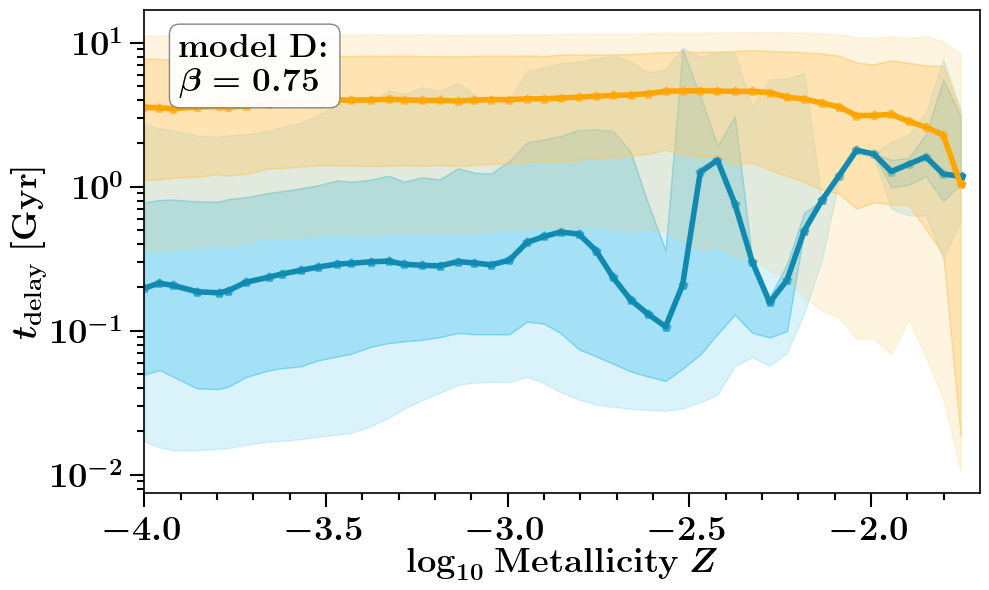

at BPS model  E

at DCOtype = BBH
51  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.12801825 0.14053004 0.13420819 0.12097086 0.13128272 0.13492471
 0.1487396  0.16057609 0.16480011 0.16867372 0.17539524 0.17939769
 0.18605045 0.19250496 0.19203948 0.18582931 0.18733223 0.18708285
 0.18458363 0.18145472 0.17793454 0.18018247 0.19856353 0.2191099
 0.22410735 0.23768912 0.24920321 0.26608185 0.28470816 0.30787841
 0.35608237 0.42652545 0.47125757 0.4872992  0.44828241 0.33206562
 0.29452036 0.40594584 0.4955052  0.7313979  1.18734414 1.78075547
 1.67446111 1.23182644 1.43294821 1.32671541 1.64049493        nan
        nan        nan        nan]


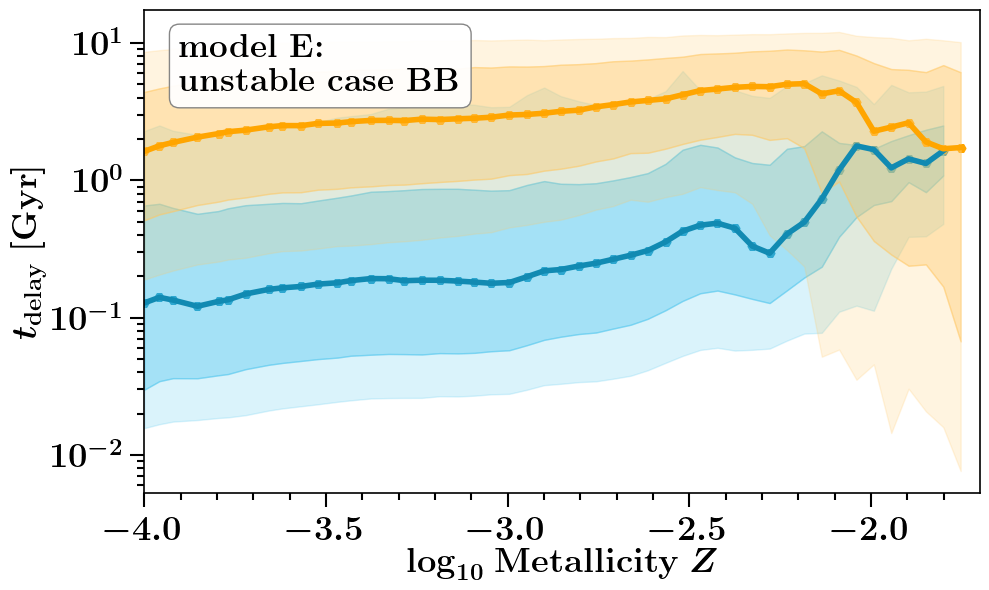

at BPS model  F

at DCOtype = BBH
52  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.09433039 0.10395601 0.10320228 0.09737514 0.10468234 0.10813996
 0.12068598 0.12783342 0.13389777 0.13609397 0.14033815 0.14607113
 0.14951153 0.15536349 0.16065879 0.15535733 0.15384056 0.15966399
 0.15783771 0.16528886 0.16607892 0.17248837 0.19121751 0.20939906
 0.21885997 0.24139845 0.26359983 0.26310978 0.30247104 0.33055016
 0.34612219 0.42801782 0.4522041  0.43431983 0.53109677 0.52998025
 0.61284242 0.78956105 0.80690483 1.03416442 1.19412348 1.50295353
 0.87056848 0.25864492 0.28387641 0.34798775 0.46221147 0.57048925
 1.15004363 1.47648711        nan        nan]


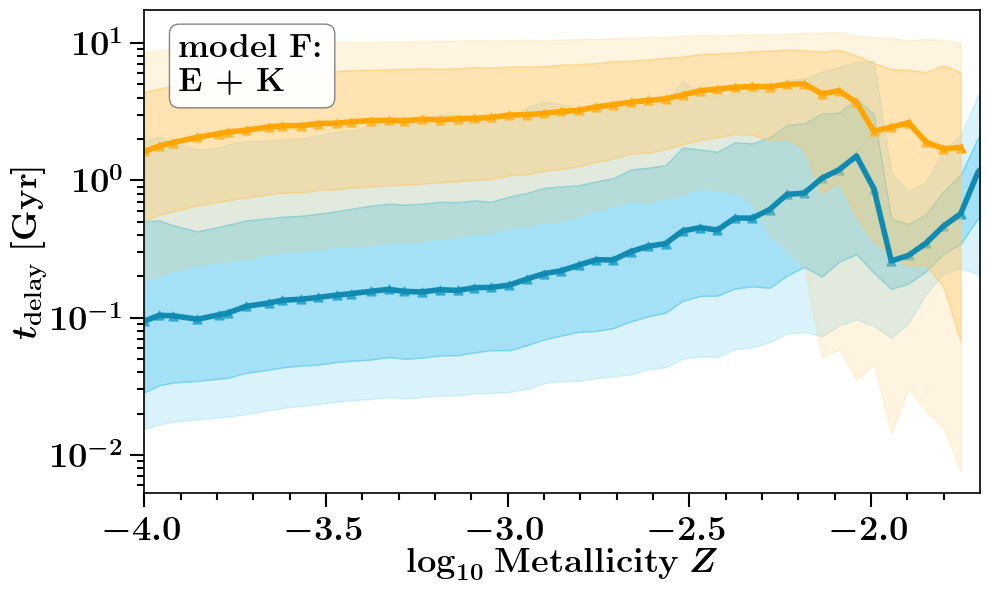

at BPS model  G

at DCOtype = BBH
50  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.02913384 0.02478667 0.01841456 0.01980599 0.01789066 0.01912056
 0.01925498 0.01830328 0.02139339 0.02712601 0.03231659 0.0367595
 0.04031987 0.04479437 0.04757403 0.05079584 0.05297266 0.0560219
 0.06013527 0.05887616 0.0616796  0.06467743 0.06248985 0.06699194
 0.06928205 0.07176192 0.07263484 0.07275642 0.07497153 0.07408489
 0.07943805 0.07922235 0.07411633 0.06915487 0.09060804 0.13230064
 0.20461318 0.28634912 0.20164876 0.17645512 0.18331638 0.19146532
 0.24615561 2.38843139 0.82992655 0.48924181 0.49623297 0.63052245
        nan        nan]


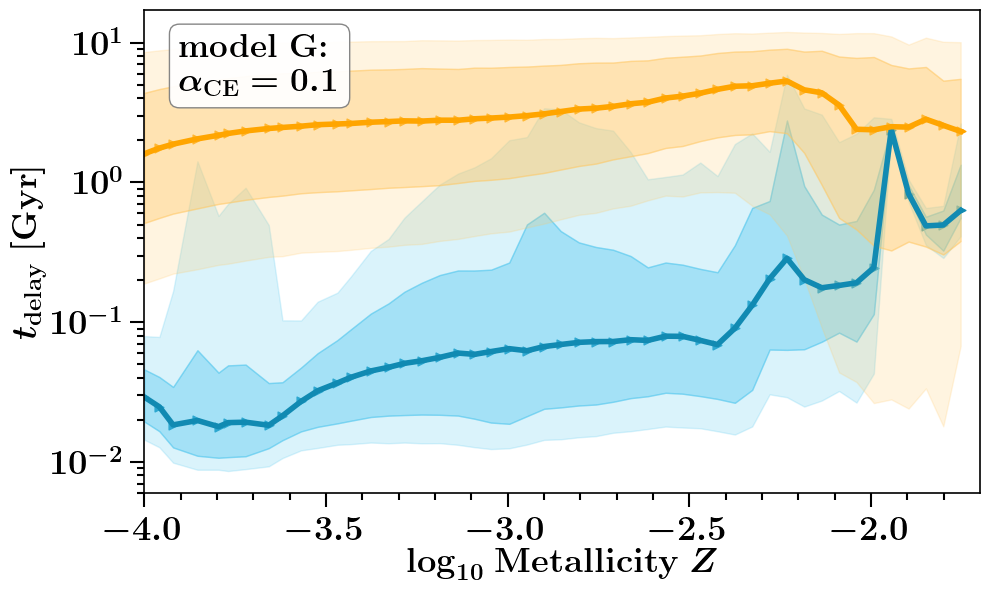

at BPS model  H

at DCOtype = BBH
49  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.07025509 0.06498479 0.05415405 0.05254864 0.05242172 0.05430716
 0.05367885 0.05760818 0.06022464 0.06204078 0.06248257 0.06643405
 0.07031181 0.07521051 0.08337638 0.08758203 0.09339074 0.10323511
 0.11210374 0.11714557 0.11387277 0.11444992 0.13912043 0.14463533
 0.15677068 0.16169142 0.16035693 0.16145416 0.16752421 0.16559241
 0.16184996 0.16877001 0.16743986 0.13209065 0.14137429 0.11945908
 0.14505369 0.13787174 0.14886899 0.20487699 0.1277223  0.11891174
 0.1122256  0.09539942 0.11169789 0.11023122        nan        nan
        nan]


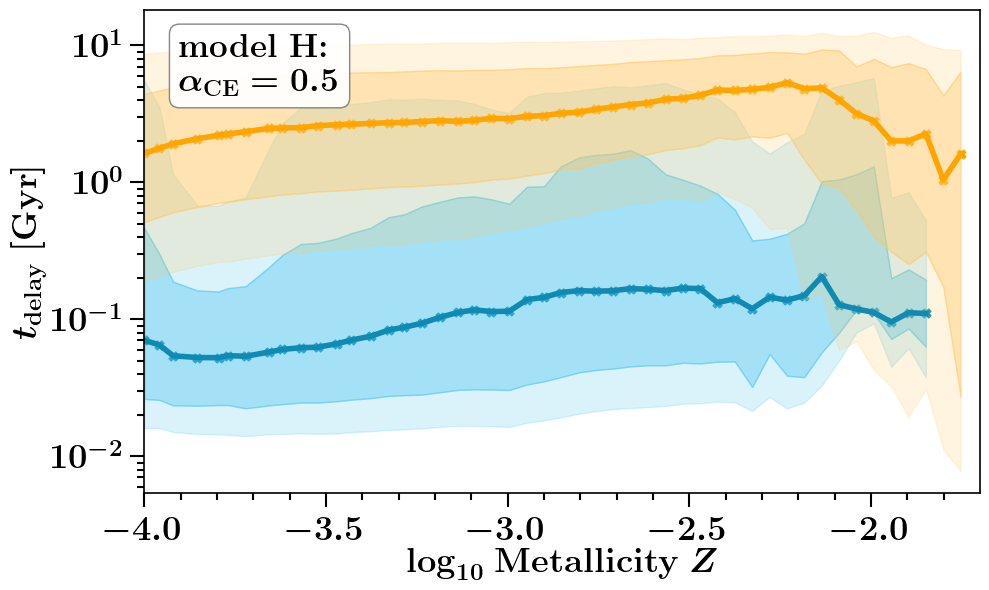

at BPS model  I

at DCOtype = BBH
49  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.28759749 0.40872771 0.49798412 0.55082634 0.61053537 0.62321318
 0.7266426  0.83162373 0.84779029 0.92345344 0.95608803 0.99480927
 0.99524427 1.01175798 0.98440354 0.97653816 0.9396659  0.96077208
 0.97460215 0.97190715 0.98964576 1.00016124 1.10215338 1.17688636
 1.21969952 1.31892723 1.32831815 1.4245217  1.49024537 1.68365038
 1.82926561 2.00690737 2.17157046 2.2143997  2.14442524 2.10425515
 2.12865953 2.32773546 2.92003754 2.7162958  2.33196098 2.25703858
 2.35615382 4.42183676 4.90313424 2.34668815        nan        nan
        nan]


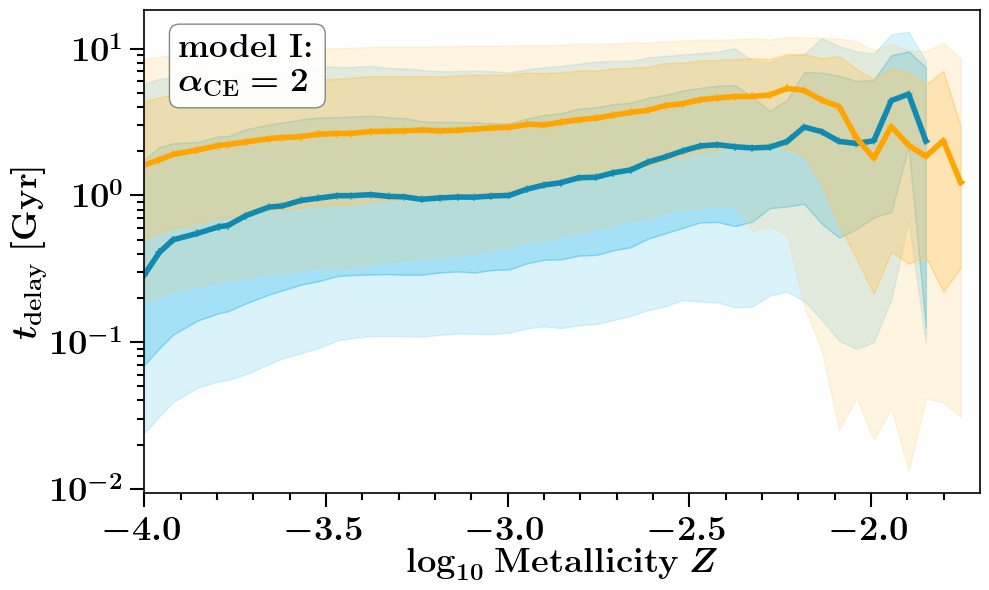

at BPS model  J

at DCOtype = BBH
49  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [3.37053959 3.57203105 3.84204428 3.83180589 3.70523734 3.62886787
 3.71650916 4.02515485 3.68952899 3.91355648 3.80379425 3.85899121
 3.93167168 3.85960574 4.22924223 3.79397222 3.94637985 4.20681424
 4.07445991 4.08168199 4.22069922 4.1312604  4.06392552 4.00628512
 3.59279356 3.72685056 3.18048897 3.14410107 2.80299377 2.39383215
 2.19190804 2.13213245 2.01295264 1.87659218 1.78701716 1.6519466
 1.50218236 1.31598679 0.82972483 2.14505154 1.50614554 2.47842172
        nan        nan        nan        nan        nan        nan
        nan]


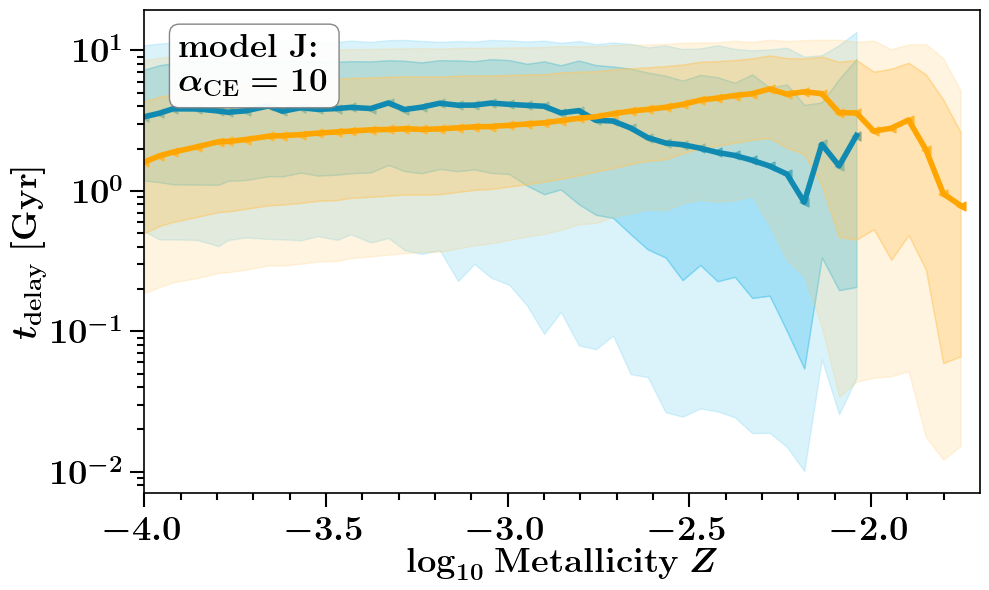

at BPS model  K

at DCOtype = BBH
52  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.09831013 0.11071553 0.10842392 0.10219062 0.10763843 0.11169168
 0.12421712 0.1330162  0.13594525 0.13739185 0.14573509 0.15135631
 0.15231569 0.15496533 0.16199936 0.15872385 0.15774026 0.16296329
 0.16485655 0.16879754 0.16884739 0.17957006 0.19345437 0.21530258
 0.22062725 0.24251625 0.27462169 0.26092646 0.29972368 0.32833983
 0.34080548 0.41413937 0.43575253 0.43083404 0.51659488 0.51381069
 0.59557227 0.81733033 0.90746083 0.91718569 1.22841388 1.26537046
 0.86248993 0.2607837  0.28418701 0.34815132 0.47377874 0.60036413
 1.0303431  1.10497739 1.61183694        nan]


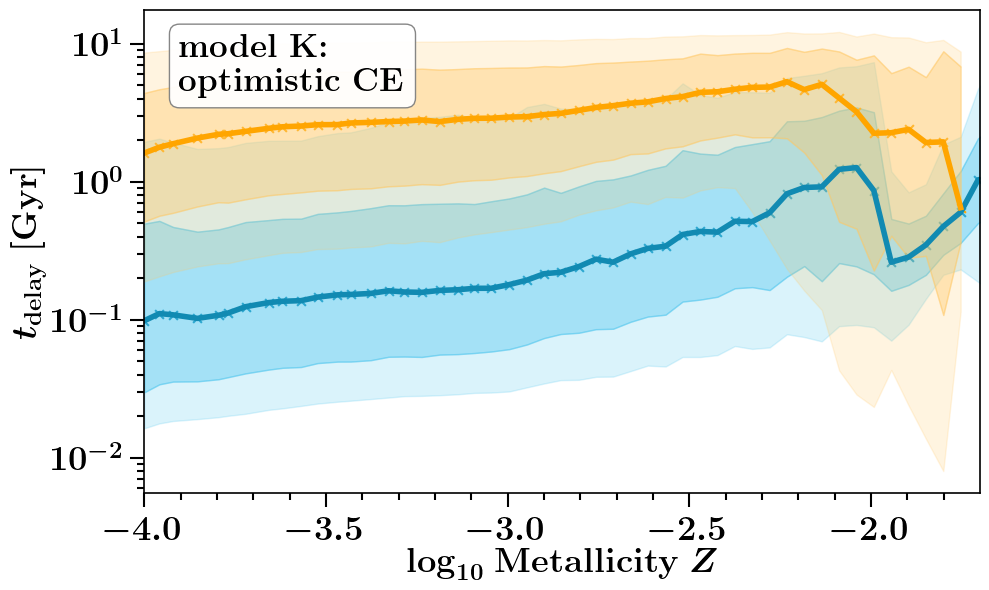

at BPS model  L

at DCOtype = BBH
53  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.11016746 0.12449138 0.12686233 0.1228379  0.13278271 0.13690862
 0.1503444  0.16332942 0.16333518 0.16541756 0.16739941 0.16795718
 0.1662654  0.1632047  0.15933341 0.15032987 0.14566098 0.13799684
 0.13462988 0.12713164 0.11963135 0.1170852  0.13003394 0.13504221
 0.13931199 0.14463942 0.15045251 0.15558647 0.15720544 0.16844335
 0.19497452 0.23341392 0.24558641 0.23537859 0.17686434 0.16247629
 0.16602639 0.1908058  0.30222422 0.77037222 1.19318282 1.79067259
 1.68094508 1.10623795 1.02949056 0.84544123 0.73257335 0.59443059
 0.59296721 0.81143031 1.32768329 1.78578332 1.7401951 ]


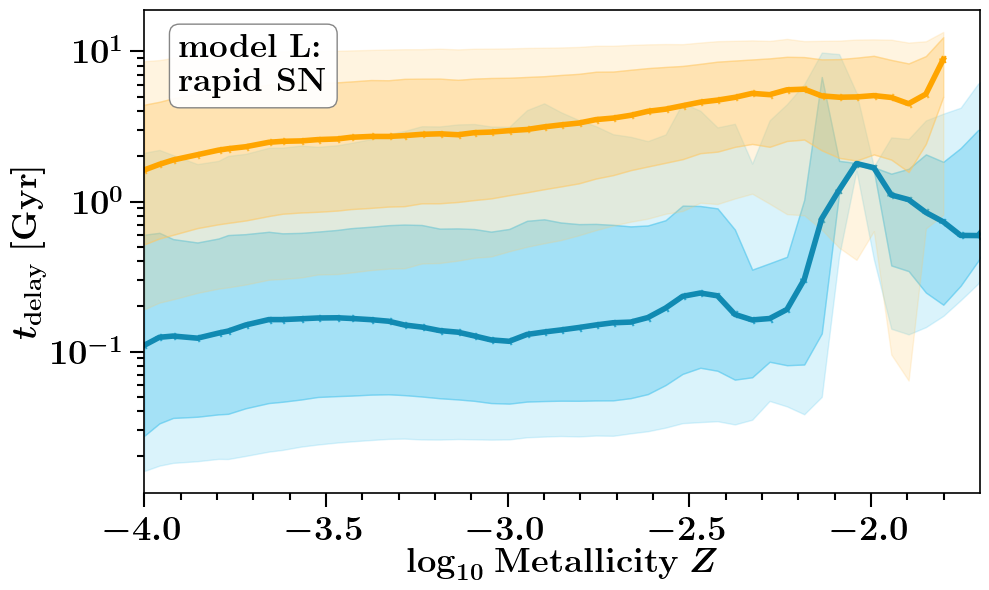

at BPS model  M

at DCOtype = BBH
51  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.1332244  0.14476083 0.14356925 0.1310959  0.13623777 0.14404225
 0.15483261 0.1666771  0.17013677 0.17505386 0.18067004 0.18569247
 0.18884206 0.19513549 0.19552559 0.19342825 0.1964751  0.19212067
 0.19240215 0.18862394 0.18558211 0.1908183  0.20968371 0.23014199
 0.23849772 0.24584366 0.26039929 0.27646429 0.29212226 0.32199524
 0.36314469 0.4281684  0.46284081 0.47321415 0.44513945 0.37033192
 0.38137294 0.45250302 0.49774281 0.68761181 1.03995371 1.23314288
 1.33496733 1.32331694 1.32107621 1.48917463 1.80956698 1.34298895
        nan        nan        nan]


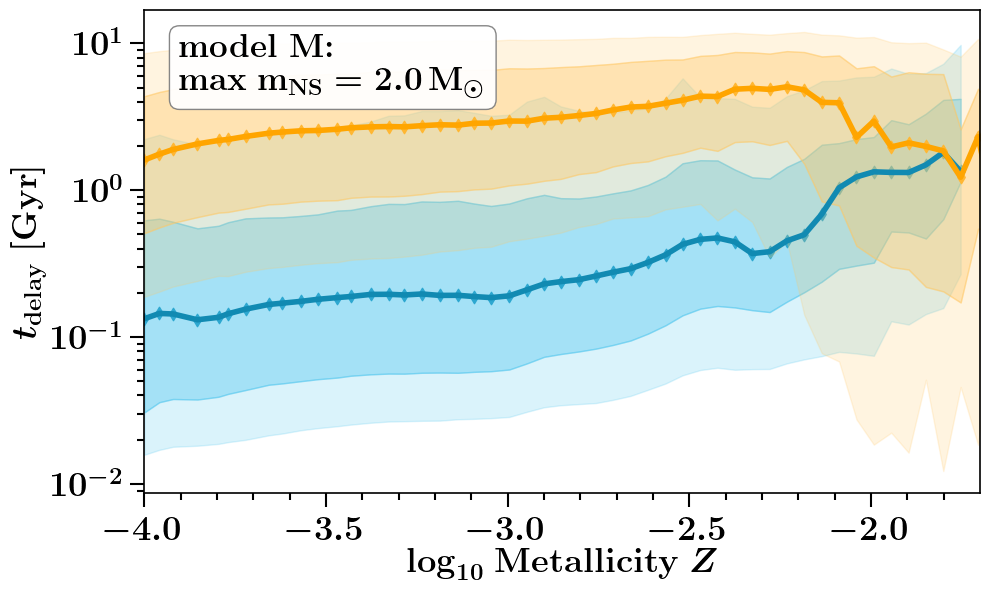

at BPS model  N

at DCOtype = BBH
51  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.12284675 0.13902652 0.13286694 0.12071444 0.12747759 0.13480528
 0.14536487 0.15768461 0.16388055 0.16699042 0.17221704 0.1780637
 0.18066773 0.18872084 0.18776742 0.18547119 0.18739678 0.18149188
 0.18153845 0.17470488 0.16810151 0.17346426 0.19387751 0.21218478
 0.21578422 0.23010514 0.23993255 0.25457809 0.26774996 0.29567755
 0.34300761 0.43259377 0.46715095 0.48434696 0.45853888 0.31009612
 0.25872077 0.31126561 0.49396563 0.71749344 1.19116543 1.78935437
 1.68185112 1.24754647 1.42254508 1.35619007 1.35539793        nan
        nan        nan        nan]


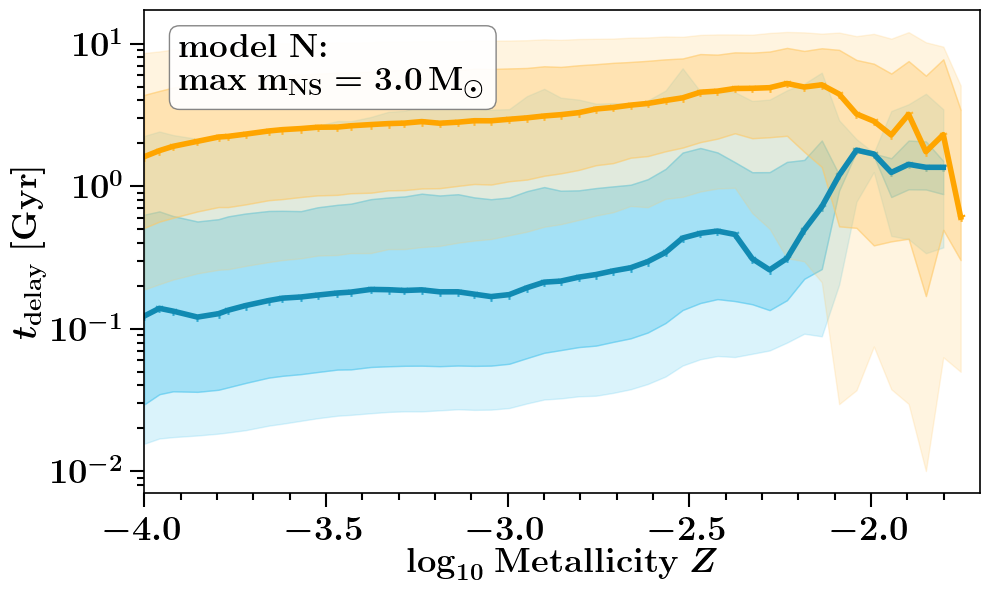

at BPS model  O

at DCOtype = BBH
51  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.11180336 0.1267494  0.12260328 0.11326146 0.12484603 0.13144135
 0.13955466 0.15660835 0.16125516 0.16743056 0.17451459 0.17998577
 0.1819594  0.19030701 0.18870615 0.19032866 0.18652417 0.18316798
 0.18190388 0.17766291 0.17455381 0.17871769 0.19850037 0.21310046
 0.21961457 0.23148539 0.24300846 0.25963568 0.27212837 0.3012555
 0.33901275 0.41672744 0.45596846 0.45794097 0.43669442 0.33313985
 0.30752315 0.39498739 0.49726531 0.72964173 1.18800814 1.77879282
 1.67870621 1.23143868 1.43817831 1.56931201 1.31335326        nan
        nan        nan        nan]


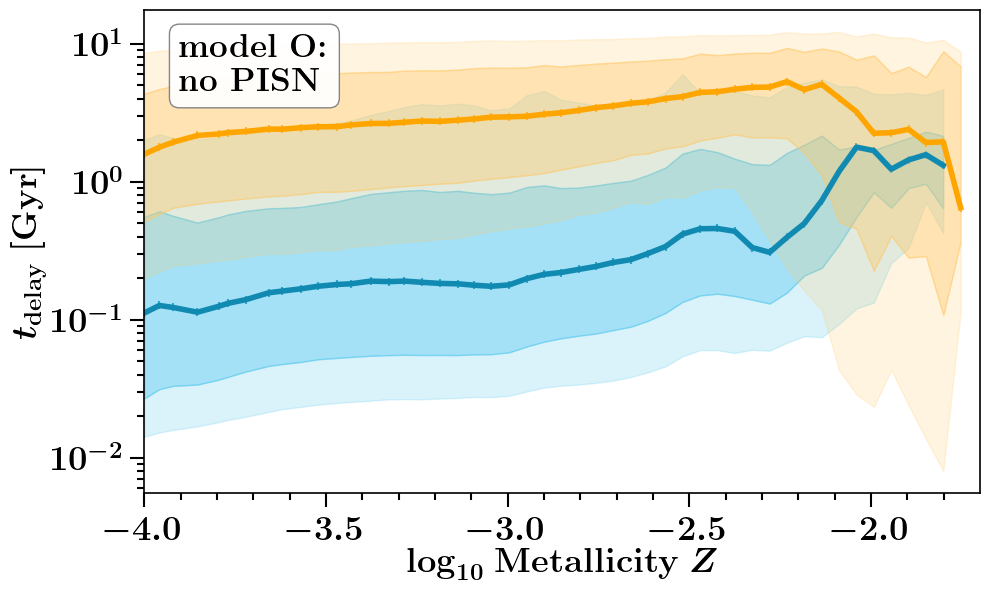

at BPS model  P

at DCOtype = BBH
53  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.11965603 0.14304001 0.1445405  0.13167885 0.13947107 0.14746414
 0.15883011 0.16547225 0.16481712 0.16646939 0.16944955 0.17465445
 0.17506425 0.17765966 0.17826241 0.1733138  0.1718025  0.17103149
 0.17067928 0.17138099 0.170795   0.17585534 0.19596018 0.21129439
 0.21455192 0.22697739 0.2378855  0.25078265 0.27189918 0.29770145
 0.32952521 0.38979116 0.43463792 0.47075598 0.48680641 0.46089378
 0.50408433 0.59452423 0.66326638 0.78685207 1.15798304 1.75581033
 1.62838999 1.16358495 1.15886824 1.30969285 1.40067112 2.2600469
 2.17813891 3.80773529 5.28350622 4.1594268         nan]


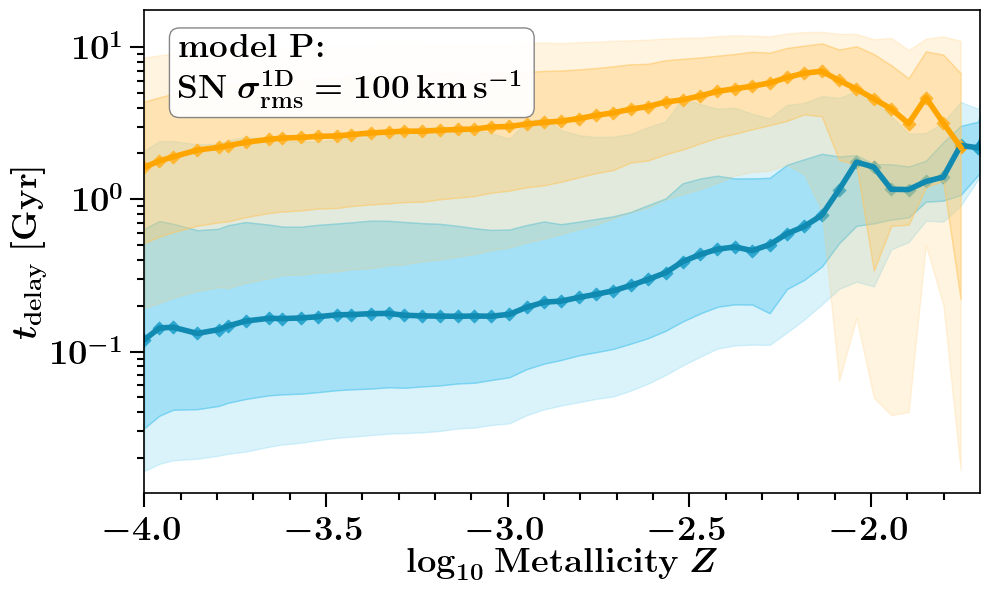

at BPS model  Q

at DCOtype = BBH
53  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.11225261 0.13314573 0.13792937 0.13310508 0.13935927 0.14574994
 0.15735418 0.16054784 0.15979194 0.15956803 0.16223851 0.16673616
 0.16642224 0.16597263 0.16561798 0.16428754 0.16181789 0.16219459
 0.16521479 0.16331208 0.164073   0.17265582 0.19367033 0.21673184
 0.21797215 0.22590959 0.23468302 0.24923515 0.27183893 0.29437952
 0.33459157 0.39909951 0.4590123  0.51181301 0.54020873 0.5353301
 0.54571394 0.66709318 0.70896946 0.78576721 1.00776038 1.45249748
 1.50971968 0.9855049  0.91323323 0.93638811 1.24926305 1.64264237
 2.25890271 3.29043443 4.70098909 6.31369434 6.12815386]


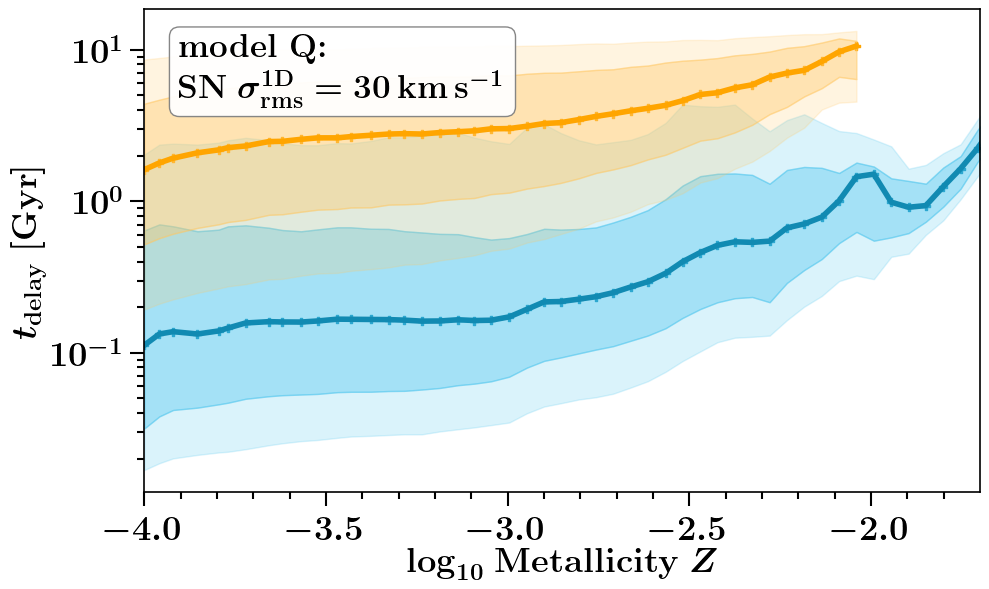

at BPS model  R

at DCOtype = BBH
53  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.11060832 0.13272175 0.13588761 0.13123313 0.14167777 0.14641189
 0.15697487 0.15977912 0.15924972 0.15791088 0.16104711 0.16402342
 0.16471621 0.16462582 0.16200421 0.15902799 0.15783876 0.15773656
 0.16108815 0.16032459 0.16194826 0.17014336 0.19398953 0.21521018
 0.22050997 0.22691366 0.2365361  0.25294753 0.27232906 0.30427598
 0.34803823 0.43044472 0.50042388 0.56651009 0.6114595  0.57909547
 0.60137415 0.70159519 0.75297312 0.80644429 1.05742725 1.49933304
 1.5318452  0.95677138 0.88959456 0.958313   1.21162178 1.5278672
 2.20972078 3.16861584 4.51890464 6.48253045 5.30262621]


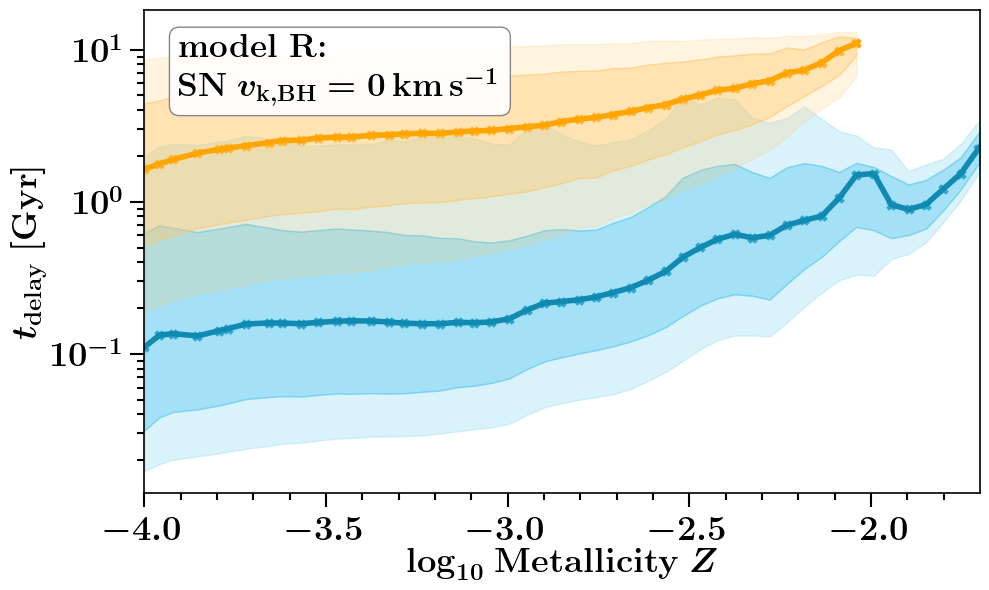

at BPS model  S

at DCOtype = BBH
53  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.12663115 0.13824652 0.13533178 0.12229298 0.12891559 0.13616719
 0.14377749 0.15350724 0.15643328 0.15674638 0.16233454 0.16517542
 0.16895685 0.17058321 0.17429417 0.17777938 0.17244328 0.16928171
 0.1713134  0.16014929 0.15661409 0.15929098 0.17292069 0.18891203
 0.19065313 0.1967291  0.20271834 0.21050252 0.21925517 0.2384203
 0.2709476  0.30430913 0.31428426 0.31998906 0.30925005 0.25053664
 0.24333579 0.30232364 0.35281132 0.44316966 0.6061508  0.86174051
 0.77519992 0.61549561 0.54420258 0.48141192 0.48261404 0.45643843
 0.47414432 0.45151068 0.51883735 0.53411109 0.37626224]


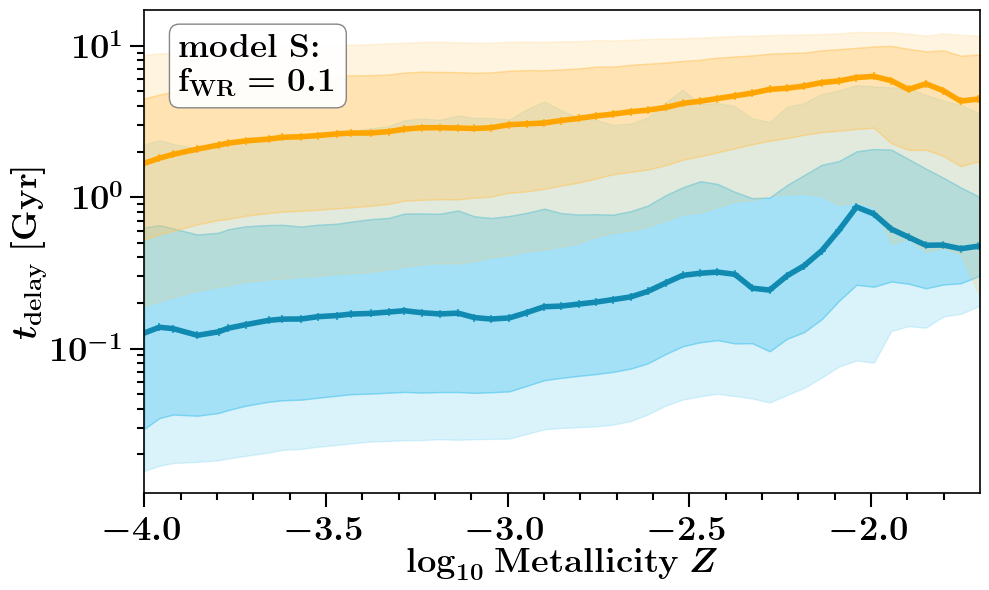

at BPS model  T

at DCOtype = BBH
41  = 53?
at Channel  classic
at Channel  stable B no CEE
median ref time;  [0.12742444 0.14272561 0.13848922 0.13394566 0.14120631 0.1484863
 0.15634269 0.17350438 0.1804921  0.19019833 0.20030737 0.20807444
 0.21760512 0.22807832 0.23175943 0.23819849 0.24200685 0.24582138
 0.25456197 0.24808109 0.25148275 0.27050913 0.30770095 0.33159449
 0.36041642 0.41031738 0.44829008 0.51068348 0.5583177  0.6066072
 0.7408297  0.82833379 0.79931346 0.84960796 0.55154181        nan
        nan        nan        nan        nan        nan]


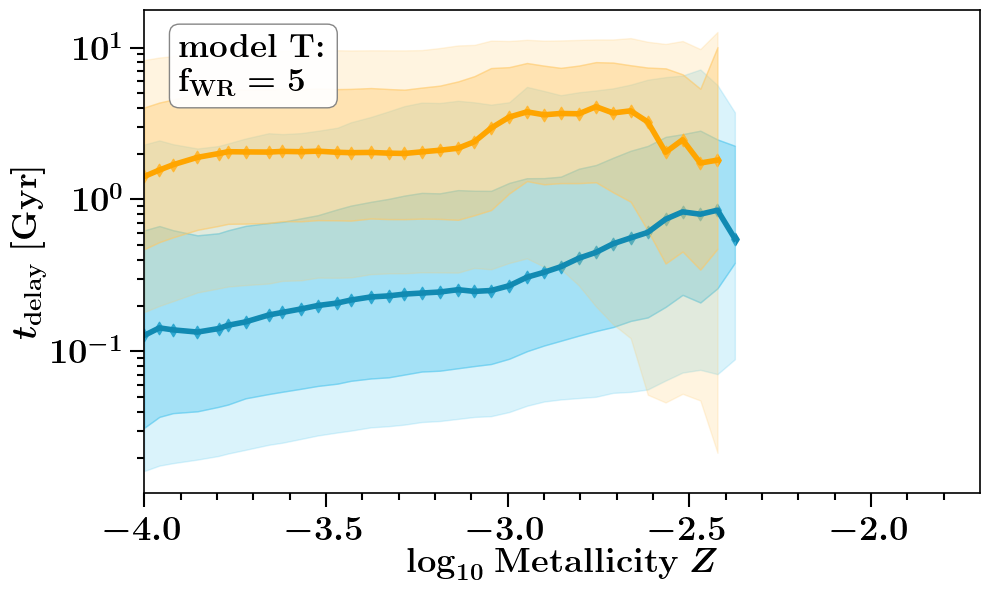

In [5]:









def plot_formation_channels_metallicity_xparam_for_quantiles(axe='None', DCOtype='BHNS', BPS_models_to_run_list=['A'], 
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False, \
                                              add_model_label=True, quantile_values=[0.5, 0.25, 0.75]):
    
    
    adjustedChannelList = ['classic', 'stable B no CEE']#, 'vii', 'immediate CE',  r'double-core CE', 'other']

    for ind_bps, BPSmodelName in enumerate(BPS_models_to_run_list):
        df = create_pd_metallicity_xparam(quantile_values=quantile_values, BPSmodelName=BPSmodelName, DCOtype=DCOtype)
        metallicities = df["metallicity"]
        
        
        norm_classic_tdelay = df['classic q_0.5'].values
        print('median ref time; ', norm_classic_tdelay)
        # plot the channel 
        for nrC, Channel in enumerate(adjustedChannelList): 
            c_FC = channelColorDict[Channel]
            colors_lighter_FC =  channelColorDict_lighter[Channel]
            
            column_names = [Channel + ' q_' + str(quantile_values[i]) for i in range(len(quantile_values))] # creates array with header names 
            qvalues = [df[column_names[i]] for i in range(len(quantile_values))]
            
            axe.scatter(np.log10(metallicities), qvalues[0].values, color=c_FC, marker=dictMarkerShape[BPSmodelName], s=40) #/norm_classic_tdelay
            axe.plot(   np.log10(metallicities), qvalues[0].values, color=c_FC, lw=4) #, ls=linestyles_mssfrind[ind_mssfr_zind])
            
            axe.fill_between(np.log10(metallicities), y1=qvalues[1], y2=qvalues[0], color=colors_lighter_FC, alpha=0.5)
            axe.fill_between(np.log10(metallicities), y1=qvalues[0], y2=qvalues[2], color=colors_lighter_FC, alpha=0.5)
            
            axe.fill_between(np.log10(metallicities), y1=qvalues[3], y2=qvalues[1], color=colors_lighter_FC, alpha=0.2)
            axe.fill_between(np.log10(metallicities), y1=qvalues[2], y2=qvalues[4], color=colors_lighter_FC, alpha=0.2)
                
    xlabel = r'$\log_{10}$ \textbf{Metallicity} $Z$'
    ylabel = r'$t_{\rm{delay}} \ [\rm{Gyr}]$'
    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)

    
    axe.set_xlim(-4,-1.7)
    axe.set_yscale('log')
    
    
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'\textbf{model %s:}'%(BPSmodelName) +'\n' + alphabetPhysicalNameDict[BPSmodelName], xy=(0.042, .95),\
                 xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
                zorder=1E10)
            
            
    return axe


###
quantile_values=[0.5, 0.25, 0.75, 0.1, 0.9 ]
DCOTypeList = ['BBH']
whichQuantity = 'median'
###

for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
# for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]): # do all of them 
#     color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)
    BPS_models_to_run_list=[BPSmodelName]
#     BPS_models_to_run_list = BPSnameslist
    for DCOtype in DCOTypeList: #'BNS', 'BHNS', 
        print()
        print('at DCOtype =', DCOtype)


        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,6), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



        ax = plot_formation_channels_metallicity_xparam_for_quantiles(axe=ax, DCOtype=DCOtype, BPS_models_to_run_list=BPS_models_to_run_list,\
                                                              pathData=pathData,\
                                                            mask_specific_mssfr=None,\
                                                         whichQuantity=whichQuantity, value_for_fraction=False, add_model_label=True, quantile_values=quantile_values) 



        
        
        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
        plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.png', transparent=False, dpi=300)
        plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.pdf', transparent=True)
        plt.show()
        plt.close()



##  generalize to any xparam 

In [30]:


def create_pd_metallicity_from_xparam(DCOtype='BHNS', BPSmodelName='A', pathData='/Volumes/SimonsFoundation/DataDCO/', quantile_values=[0.5, 0.25, 0.75], xparam='log10_t_delay'):
    """
    whichplot='rate', 'ratio'
    
    """

    pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
    redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
    if DCOtype=='BBH':
        adjustedChannelList = ['classic', 'stable B no CEE'] #, 'vii', 'immediate CE',  r'double-core CE', 'other']
    elif DCOtype=='BHNS':
        adjustedChannelList = ['classic', 'stable B no CEE', 'immediate CE'] #,  r'double-core CE', 'other']
    if DCOtype=='BNS':
        adjustedChannelList = ['classic',   r'double-core CE'] #, 'other']
#     adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
    print('running for channels', adjustedChannelList)
    
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    fdata = h5.File(full_data_path,'r')     # read in data 
    
#     print('running xparam:', xparam)
    
    massCO_ZAMSM1 = fdata['doubleCompactObjects']['M1'][...].squeeze()
    massCO_ZAMSM2 = fdata['doubleCompactObjects']['M2'][...].squeeze()
    # M1 will be the most massive, M2 the least massive compact object. 
    massCO_LVKM1, massCO_LVKM2 = obtainM1BHandM2BHassymetric(m1=fdata['doubleCompactObjects']['M1'][...].squeeze(), m2=fdata['doubleCompactObjects']['M2'][...].squeeze()) 
    MassRatioCO_LVK = massCO_LVKM2/massCO_LVKM1
    
    # make this a dictionary instead !!
    if xparam=='chirp_mass_LVK':
        param_x = chirpmass(massCO_LVKM1, massCO_LVKM2)
    elif xparam=='mass_tot':
        param_x = massCO_LVKM1 + massCO_LVKM2
    elif xparam=='mass_ratio_LVK':
        param_x = MassRatioCO_LVK
    elif xparam=='mass_1_LVK':
        param_x = massCO_LVKM1
    elif xparam=='mass_2_LVK':
        param_x = massCO_LVKM2
    elif xparam=='log10_t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
        param_x = np.log10(param_x)
    elif xparam=='t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
    elif xparam=='M1ZAMS':
        param_x = fdata['doubleCompactObjects']['M1ZAMS'][...].squeeze()
    elif xparam=='M2ZAMS':
        param_x = fdata['doubleCompactObjects']['M2ZAMS'][...].squeeze()
    elif xparam=='qZAMS':
        param_x = fdata['doubleCompactObjects']['M2ZAMS'][...].squeeze() / fdata['doubleCompactObjects']['M1ZAMS'][...].squeeze()
    elif xparam=='separationInitial':
        param_x = fdata['doubleCompactObjects']['separationInitial'][...].squeeze()
    # get the parameter to plot of interest 
#     param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
    

    
    channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()
    metallicities = fdata['doubleCompactObjects']['Metallicity1'][...].squeeze()
    weights_ =  fdata['doubleCompactObjects']['weight'][...].squeeze()
    #     param_x = np.log10(param_x)
    

    
    nZ = len(np.unique(metallicities))
    fc_data = np.zeros((nZ, 1)) # create empty dataset for metallicities
    fc_data[:,0] = np.unique(metallicities)  # fill with metallicity data 
    df = pd.DataFrame(fc_data, columns=["metallicity"])

    for nrC, Channel in enumerate(adjustedChannelList): 
        # obtain fc_mask for the requested channel name 
        ind_wanted = dictFormationChannelIndex[Channel]
        mask_MRR = (channels==ind_wanted)
#         print('at Channel ', Channel)
#         for ind_q, quantile in enumerate(quantiles):
        data_to_add = np.zeros((nZ, len(quantile_values)))
        data_to_add[:] = np.nan # start with nan values so that we do not plot datapoint if it doesnt exist 
        column_names = [Channel + ' q_' + str(quantile_values[i]) for i in range(len(quantile_values))] # creates array with header names 

        for ind_Z, Zvalue in enumerate(np.unique(metallicities)):
            mask_ZZ = metallicities[mask_MRR]==Zvalue
            if len(weights_[mask_MRR][mask_ZZ])>10:            
                data_to_add[ind_Z] = weighted_quantile(values=param_x[mask_MRR][mask_ZZ], quantiles=quantile_values, sample_weight=weights_[mask_MRR][mask_ZZ])
                
        df_to_add = pd.DataFrame(data_to_add, columns=column_names)
        df = pd.concat([df, df_to_add], axis=1)

    # always close the dataset
    fdata.close()

    return df




def plot_formation_channels_metallicity_from_xparam_for_quantiles(axe='None', DCOtype='BHNS', BPS_models_to_run_list=['A'], 
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False, \
                                              add_model_label=True, quantile_values=[0.5, 0.25, 0.75], xparam='log10_t_delay'):
    
#     print('running xparam:', xparam)
#     print()
    
    
    
    if DCOtype=='BBH':
        adjustedChannelList = ['classic', 'stable B no CEE'] #, 'vii', 'immediate CE',  r'double-core CE', 'other']
    elif DCOtype=='BHNS':
        adjustedChannelList = ['classic', 'stable B no CEE', 'immediate CE'] #,  r'double-core CE', 'other']
    if DCOtype=='BNS':
        adjustedChannelList = ['classic',   r'double-core CE'] #, 'other']
    print('running for channels', adjustedChannelList)
#     adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']

    for ind_bps, BPSmodelName in enumerate(BPS_models_to_run_list):
        df = create_pd_metallicity_from_xparam(quantile_values=quantile_values, BPSmodelName=BPSmodelName, DCOtype=DCOtype, xparam=xparam)
        metallicities = df["metallicity"]
        
        
#         norm_classic_tdelay = df['classic q_0.5'].values
#         print('median ref time; ', norm_classic_tdelay)
        # plot the channel 
        for nrC, Channel in enumerate(adjustedChannelList): 
            c_FC = channelColorDict[Channel]
            colors_lighter_FC =  channelColorDict_lighter[Channel]
            
            column_names = [Channel + ' q_' + str(quantile_values[i]) for i in range(len(quantile_values))] # creates array with header names 
            qvalues = [df[column_names[i]] for i in range(len(quantile_values))]
            
            axe.scatter(np.log10(metallicities), qvalues[0].values, color=c_FC, marker=dictMarkerShape[BPSmodelName], s=40) #/norm_classic_tdelay
            axe.plot(   np.log10(metallicities), qvalues[0].values, color=c_FC, lw=4) #, ls=linestyles_mssfrind[ind_mssfr_zind])
            
            axe.fill_between(np.log10(metallicities), y1=qvalues[1], y2=qvalues[0], color=colors_lighter_FC, alpha=0.5)
            axe.fill_between(np.log10(metallicities), y1=qvalues[0], y2=qvalues[2], color=colors_lighter_FC, alpha=0.5)
            
            axe.fill_between(np.log10(metallicities), y1=qvalues[3], y2=qvalues[1], color=colors_lighter_FC, alpha=0.2)
            axe.fill_between(np.log10(metallicities), y1=qvalues[2], y2=qvalues[4], color=colors_lighter_FC, alpha=0.2)
    
    

    xlabel = r'$\log_{10}$ \textbf{Metallicity} $Z$'
    
    if xparam=='chirp_mass_LVK':
        ylabel = r'$\mathcal{M}_{\rm{c}} \ [M_{\odot}]$'
    elif xparam=='mass_tot':
        ylabel = r'$\rm{M}_{\rm{tot}} \ [M_{\odot}]$'
    elif xparam=='mass_ratio_LVK':
        ylabel = r'$q$'
    elif xparam=='mass_1_LVK':
        ylabel = r'$m_1 [M_{\odot}]$'
    elif xparam=='mass_2_LVK':
        ylabel = r'$m_2 [M_{\odot}]$'
    elif xparam=='log10_t_delay':
        ylabel = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
    elif xparam=='t_delay':
        ylabel = r'$t_{\rm{delay}} \ [\rm{Gyr}]$'
    elif xparam=='M1ZAMS':
        ylabel = r'$\rm{M}_{\rm{ZAMS, 1}} \ [M_{\odot}]$'
    elif xparam=='M2ZAMS':
        ylabel = r'$\rm{M}_{\rm{ZAMS, 2}} \ [M_{\odot}]$'
    elif xparam=='qZAMS':
        ylabel = r'${q}_{\rm{ZAMS}} $'
    elif xparam=='separationInitial':
        ylabel = r'${a}_{\rm{ZAMS}} [\rm{AU}] $'      
    
#     ylabel = r'$t_{\rm{delay}} \ [\rm{Gyr}]$'
    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)
    # set metallicity range
    axe.set_xlim(-4,-1.7)
    
    if xparam in ['t_delay', 'separationInitial']:
        axe.set_yscale('log')
    
    
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'\textbf{model %s:}'%(BPSmodelName) +'\n' + alphabetPhysicalNameDict[BPSmodelName], xy=(0.042, .95),\
                 xycoords='axes fraction', fontsize = fs-6, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
                zorder=1E10)  
#     bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
#     axe.annotate(r'\textbf{%s}'%(DCOtype), xy=(0.042, .95),\
#                  xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
#                 zorder=1E10)
            
            
    return axe



at xparam  qZAMS
at BPS model  A
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


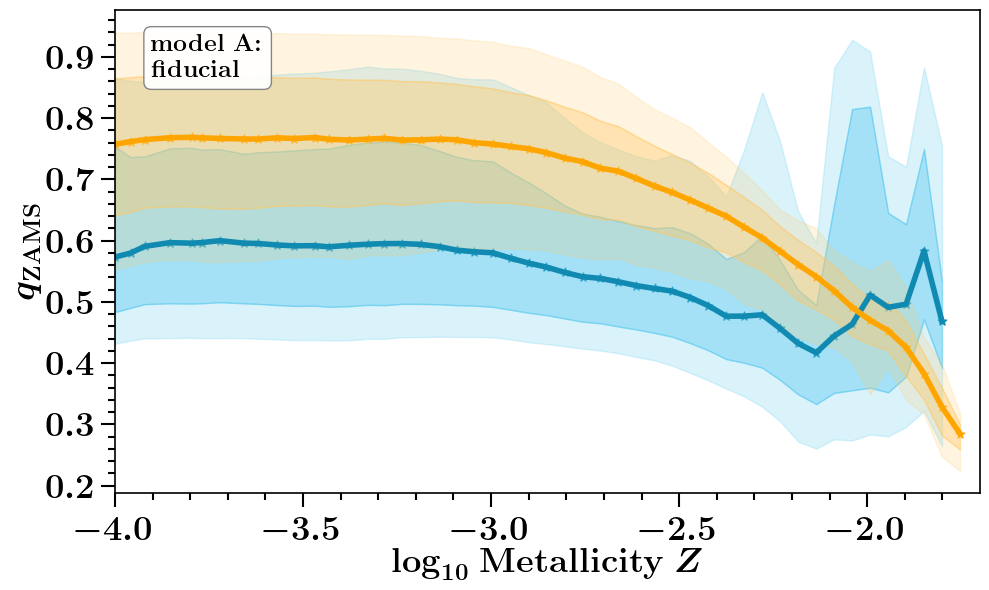


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


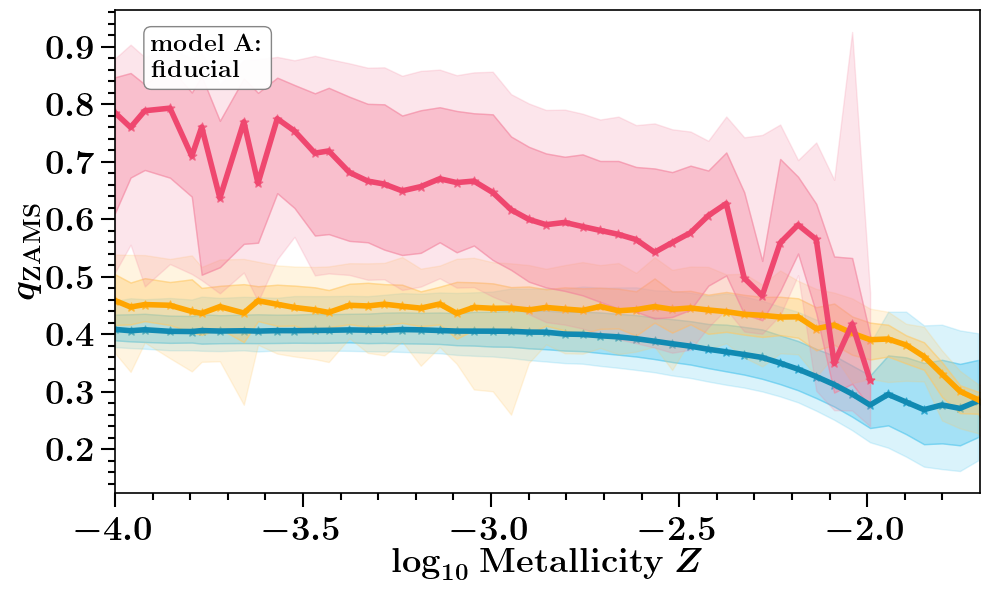


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


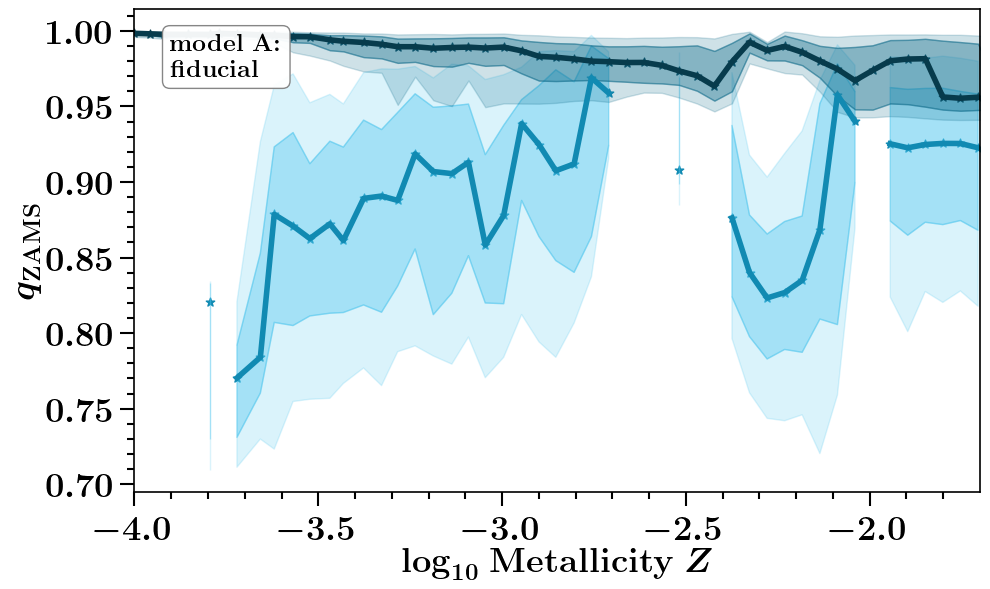


at BPS model  B
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


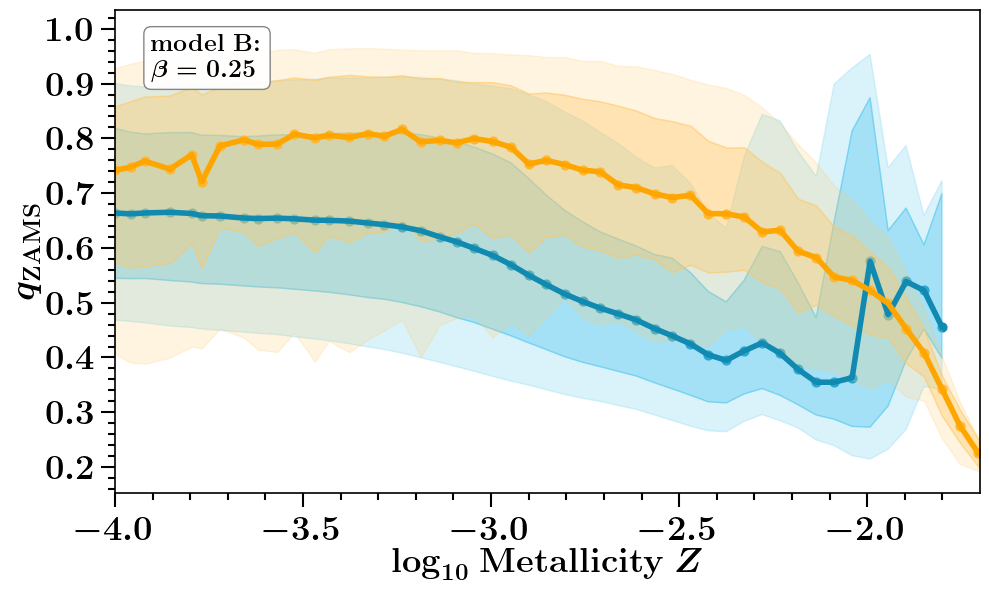


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


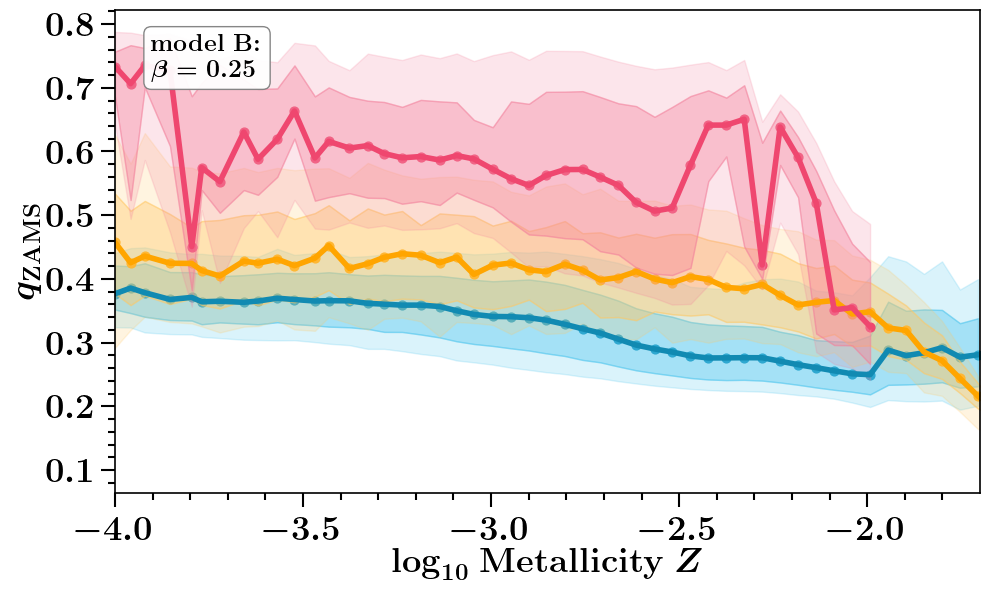


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


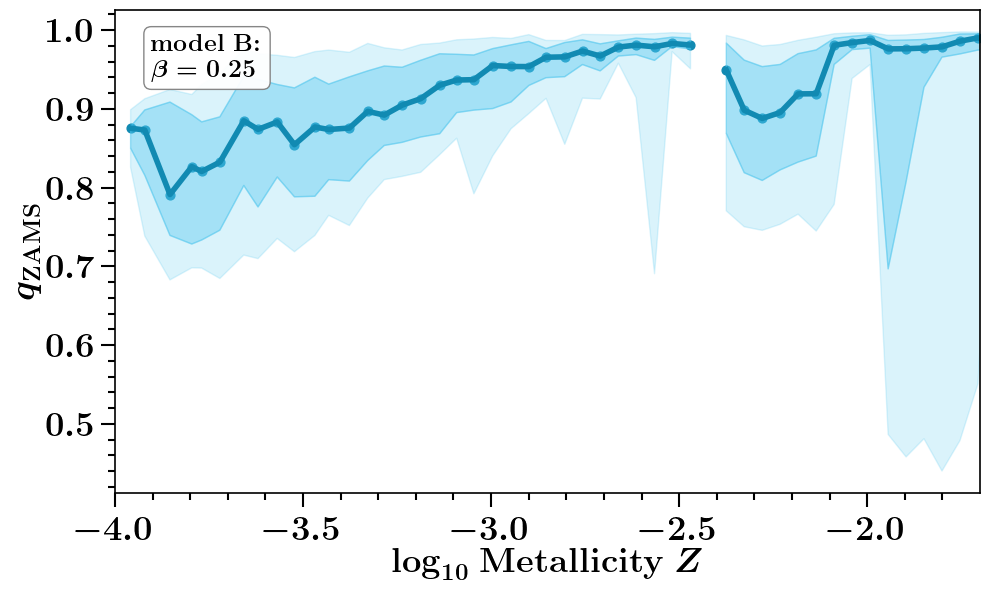


at BPS model  C
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


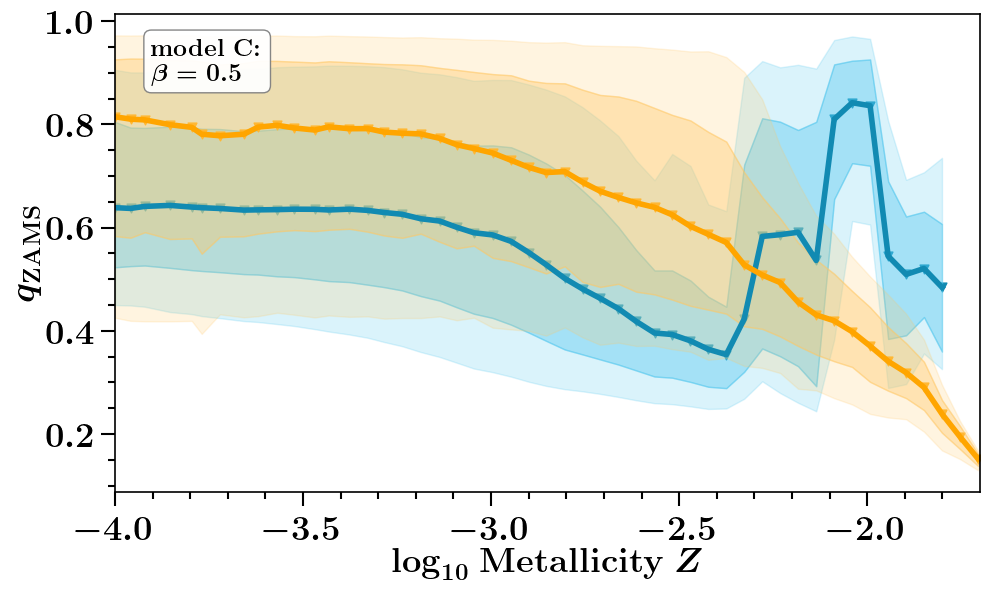


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


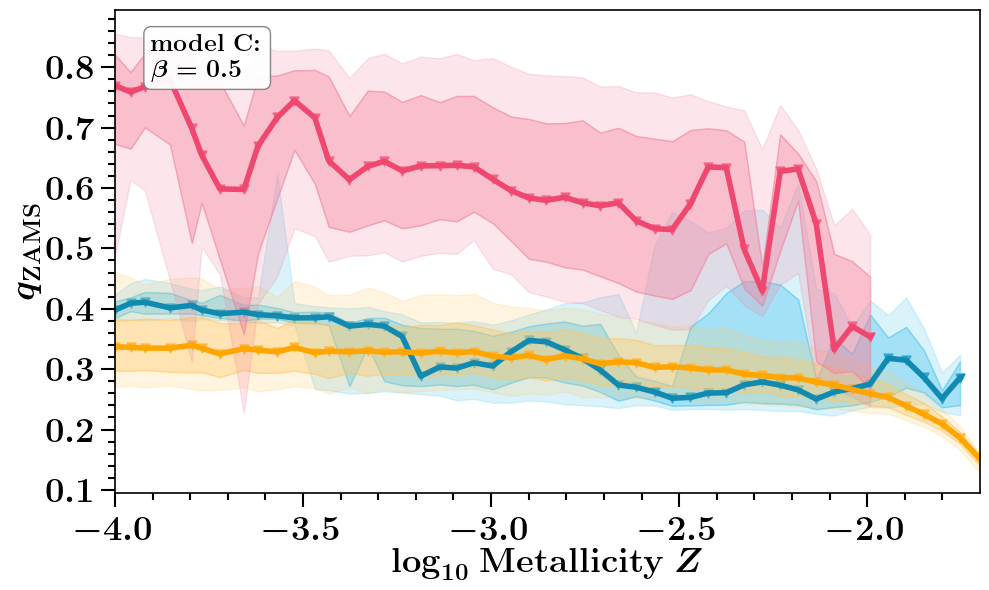


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


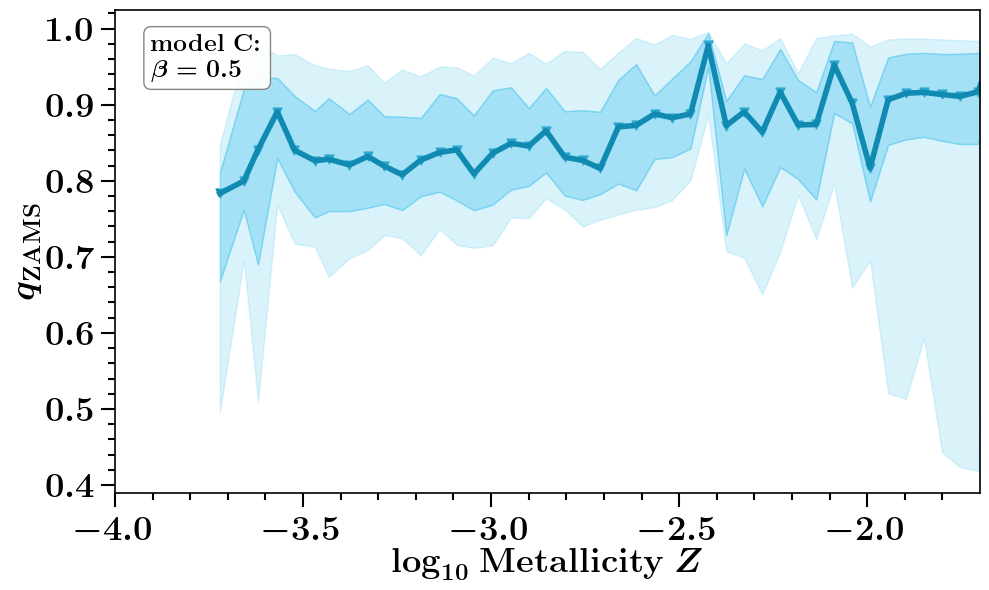


at BPS model  D
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


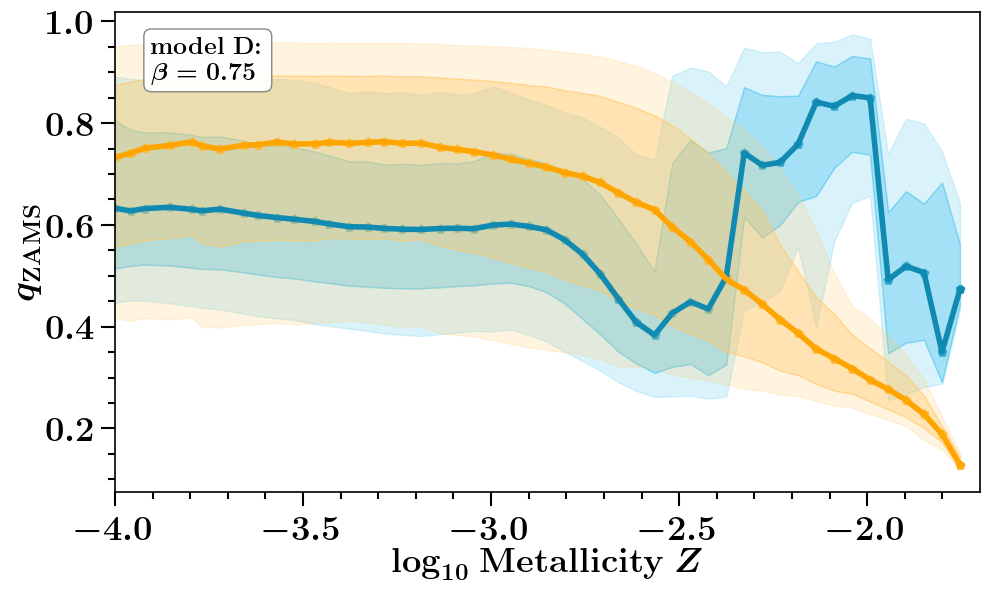


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


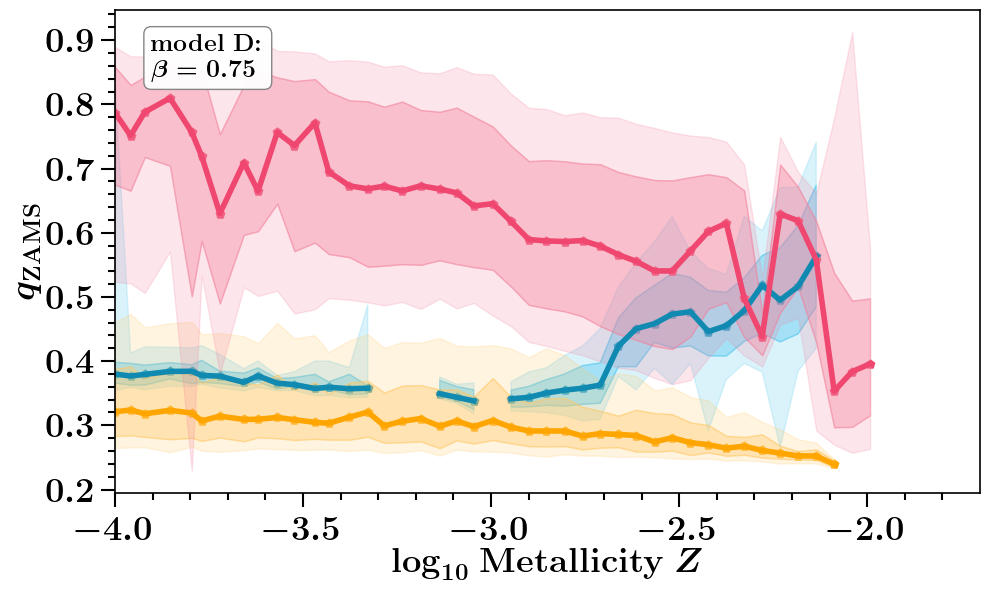


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


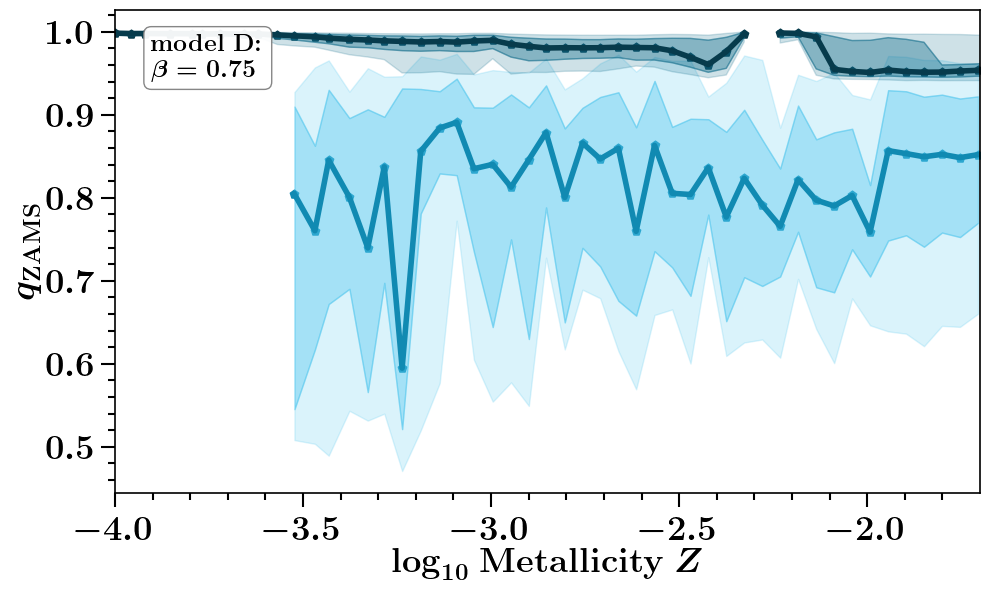


at BPS model  E
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


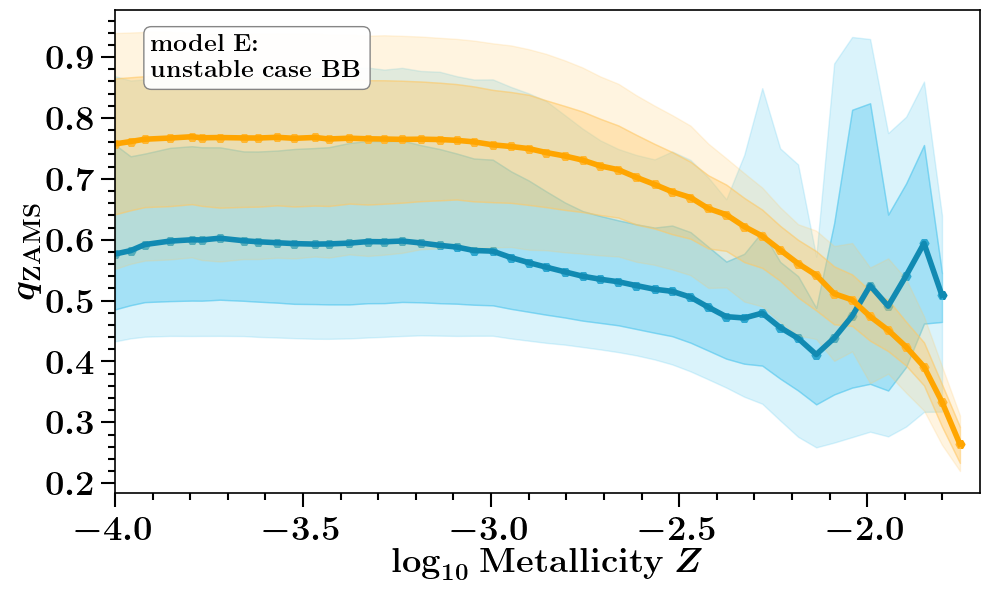


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


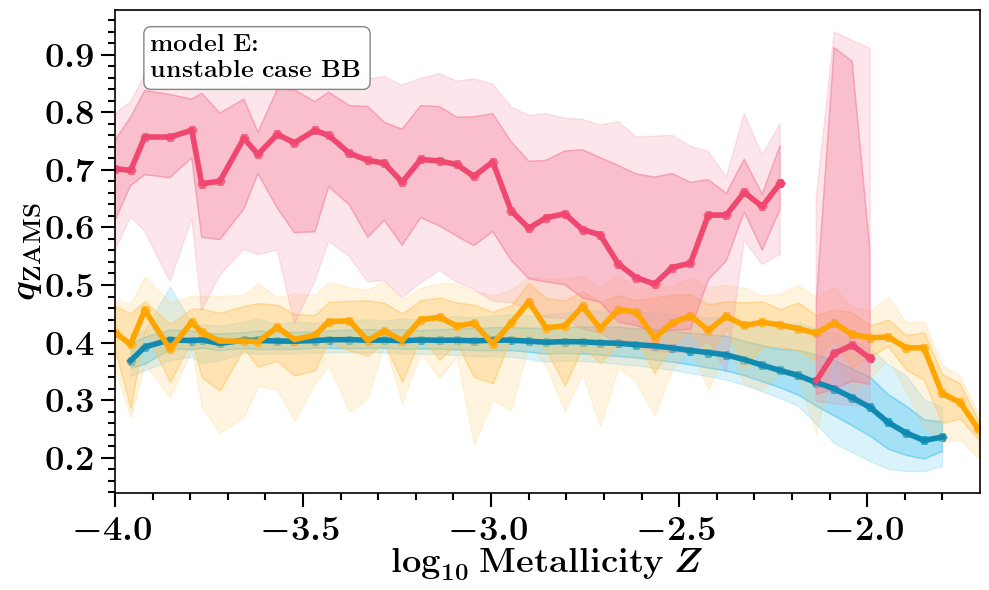


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


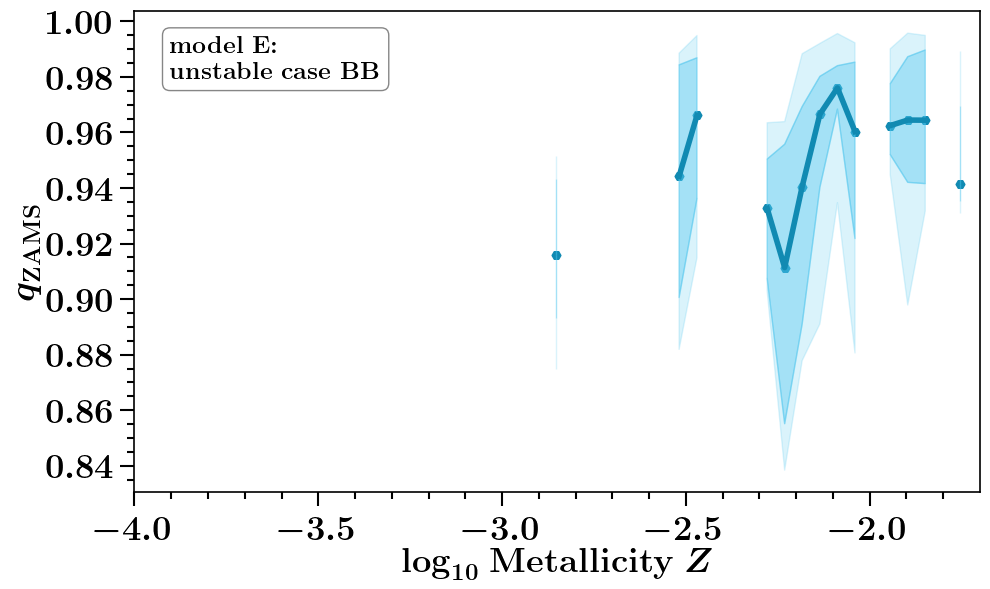


at BPS model  F
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


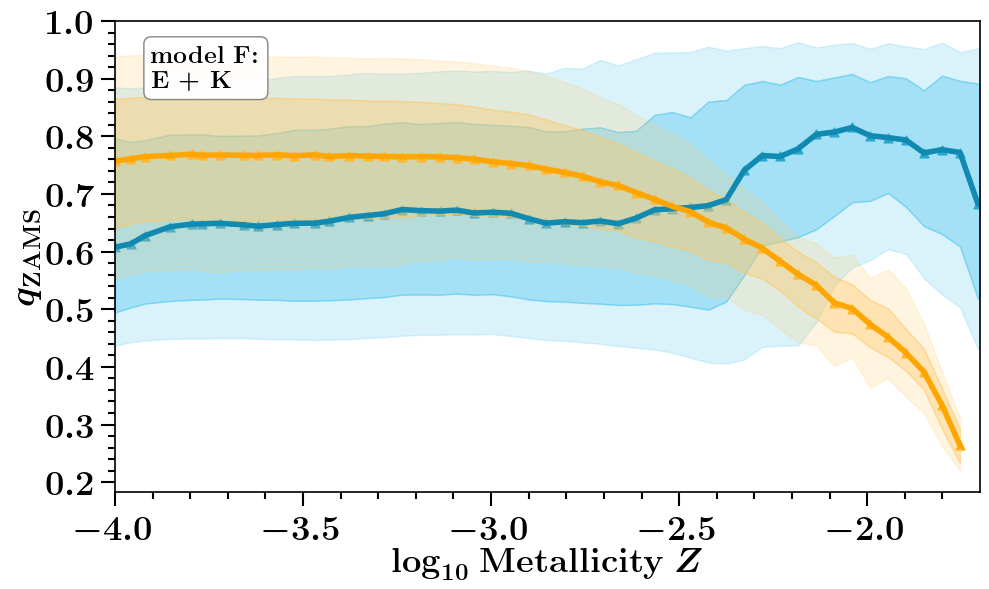


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


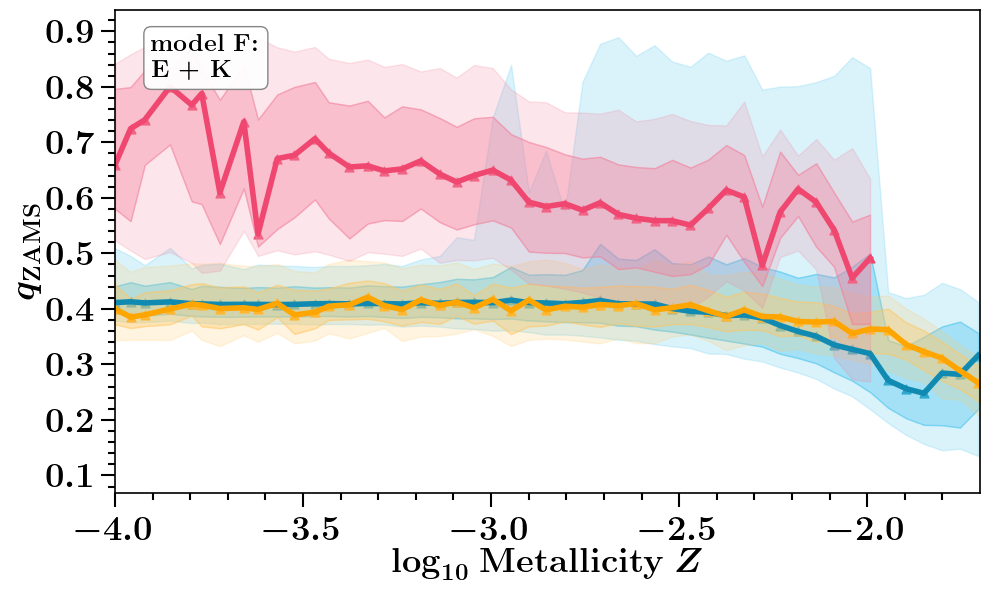


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


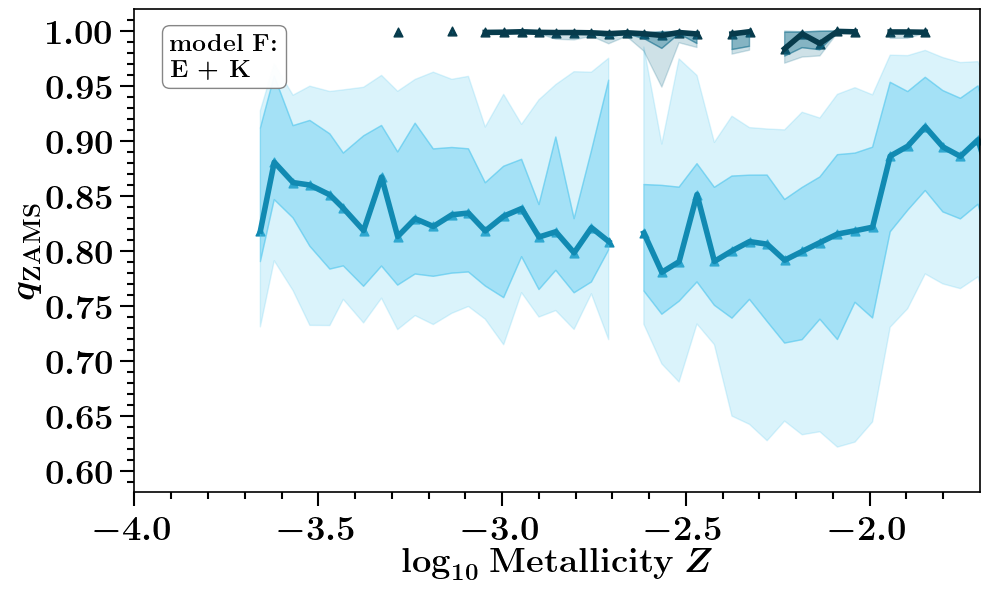


at BPS model  G
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


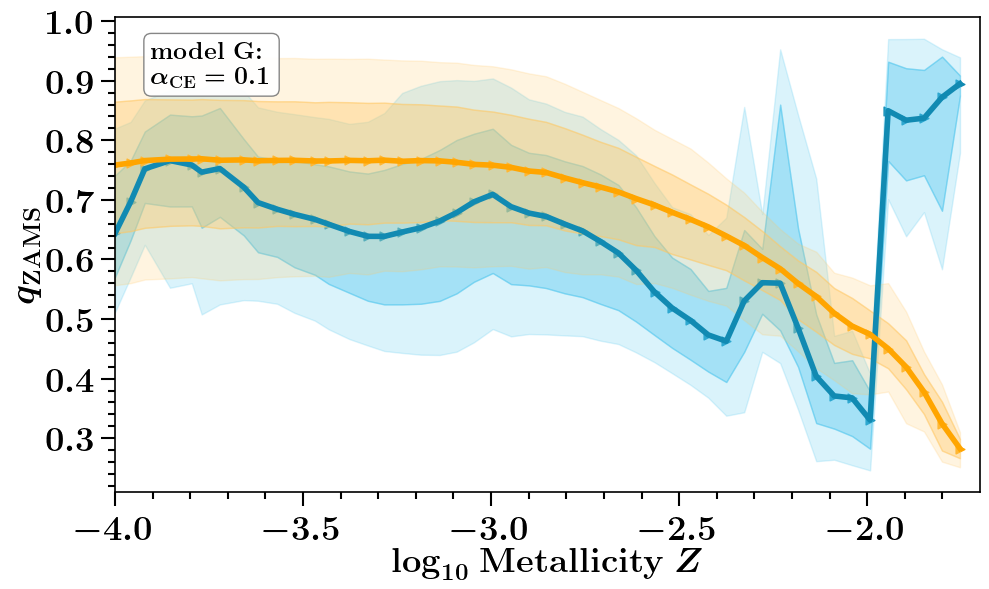


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


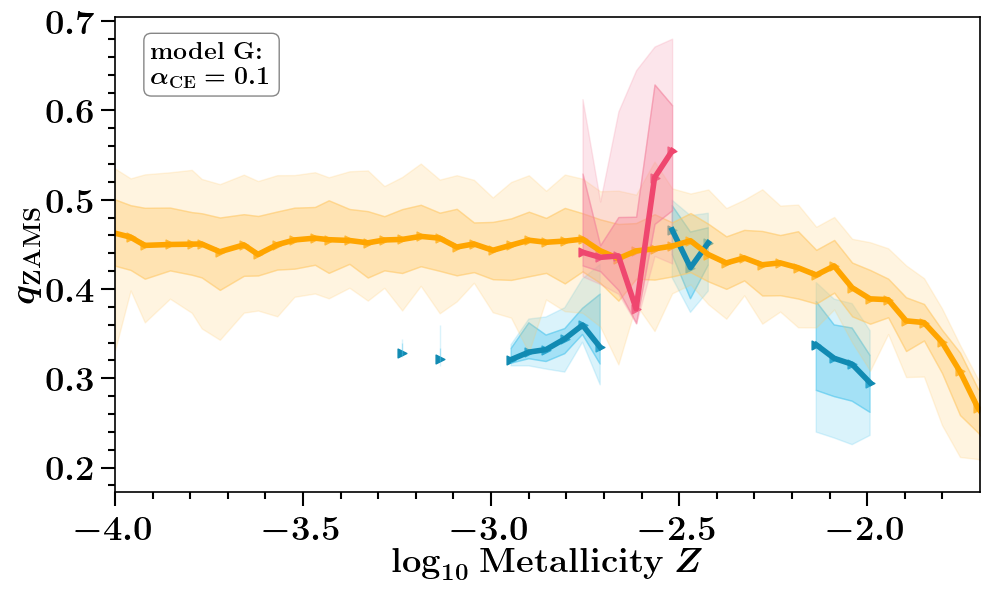


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


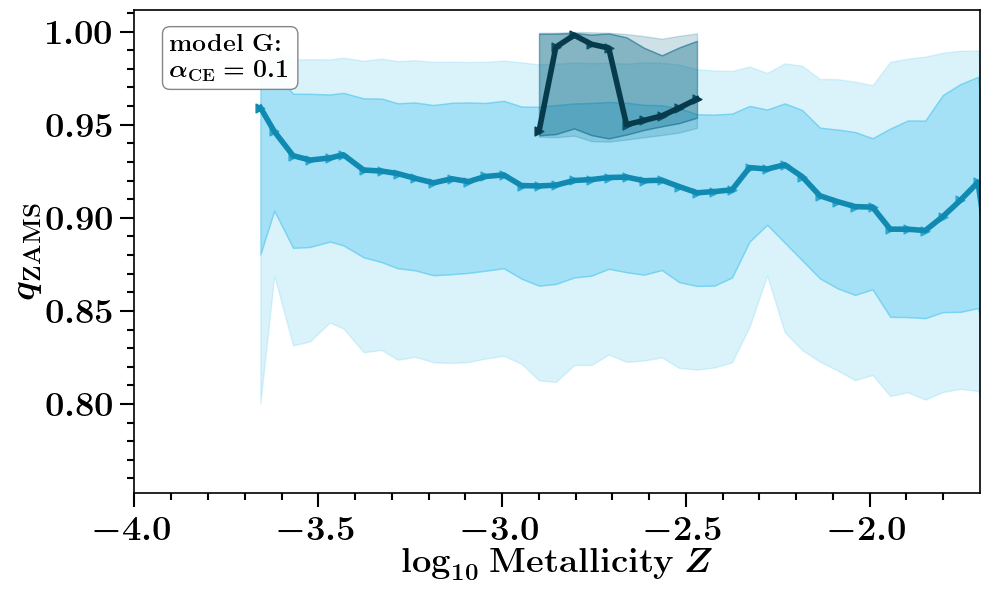


at BPS model  H
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


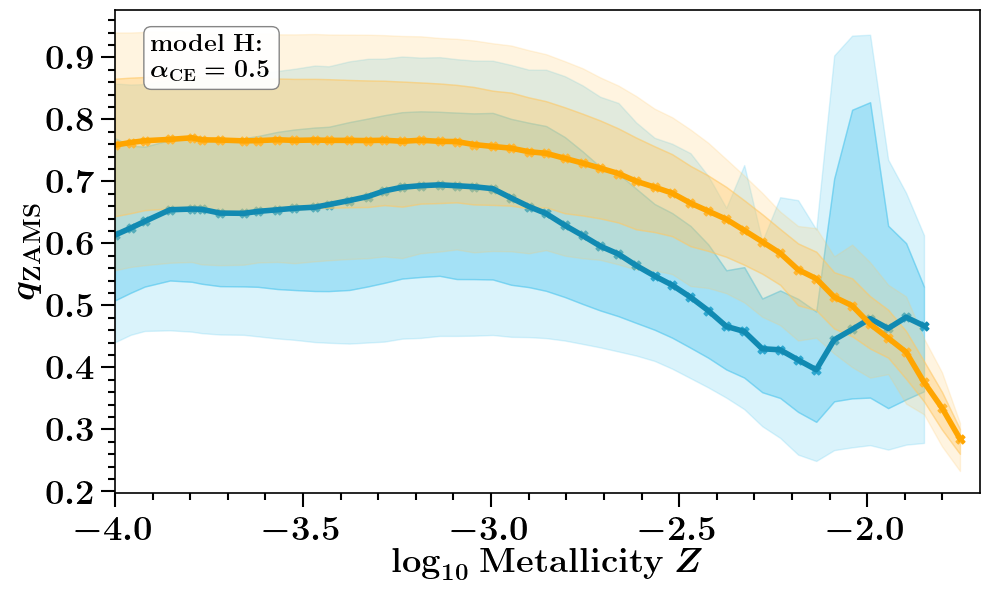


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


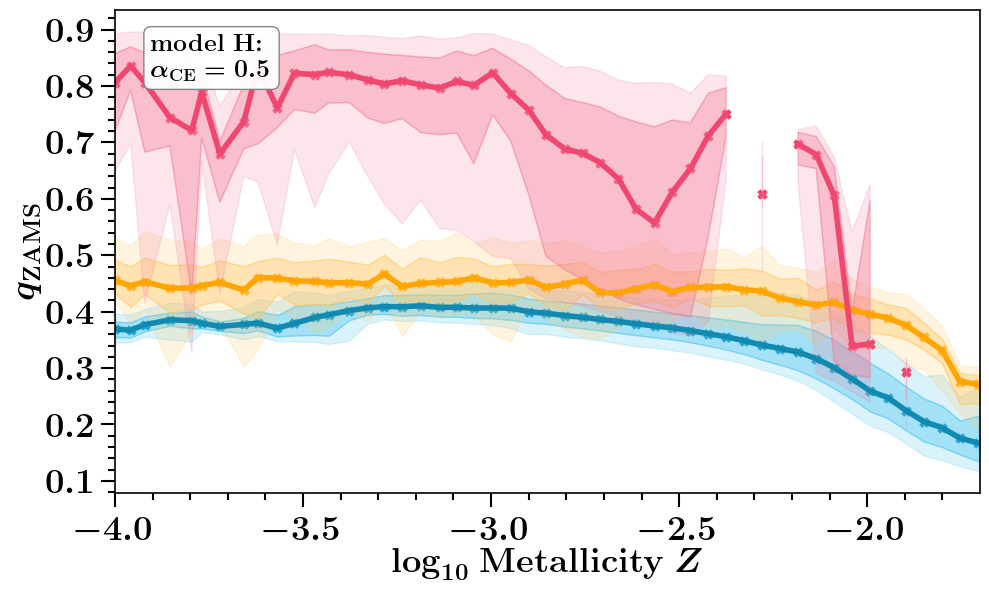


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


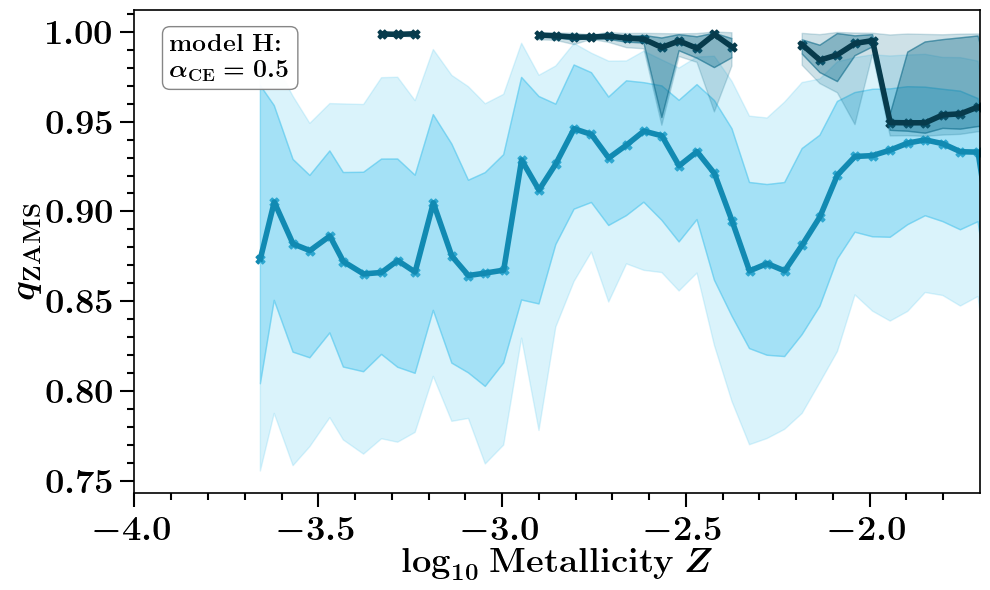


at BPS model  I
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


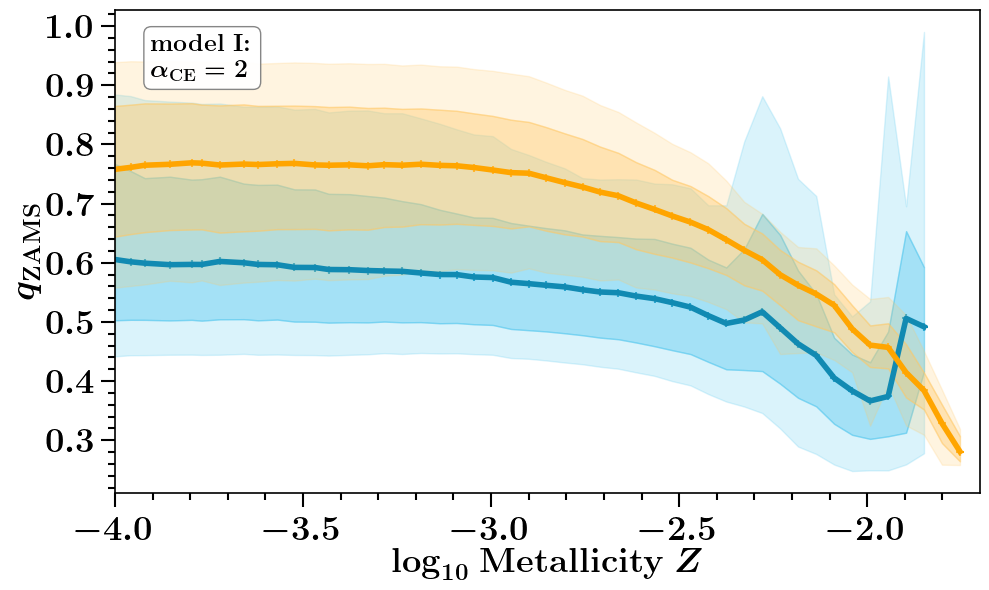


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


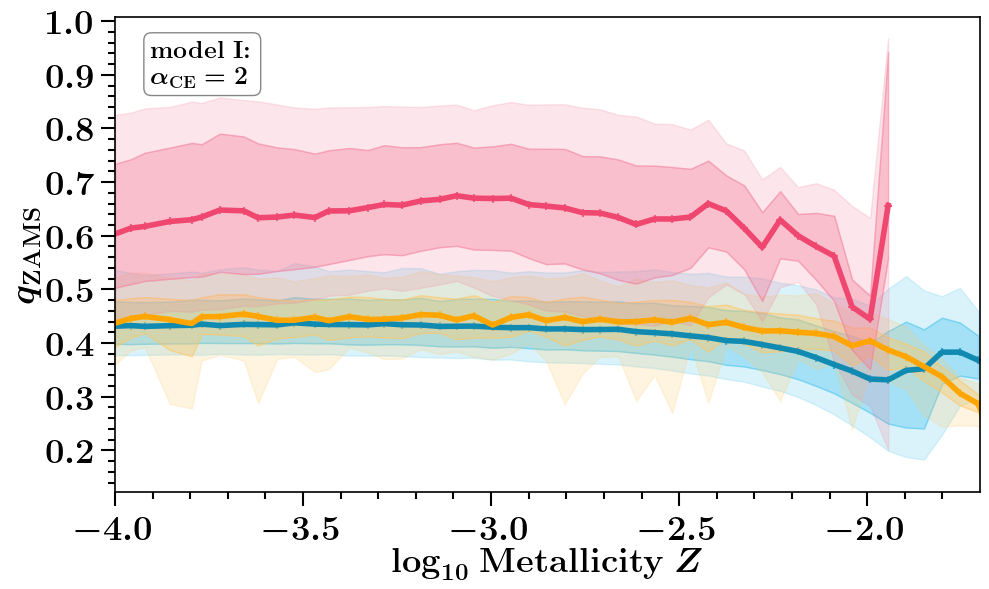


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


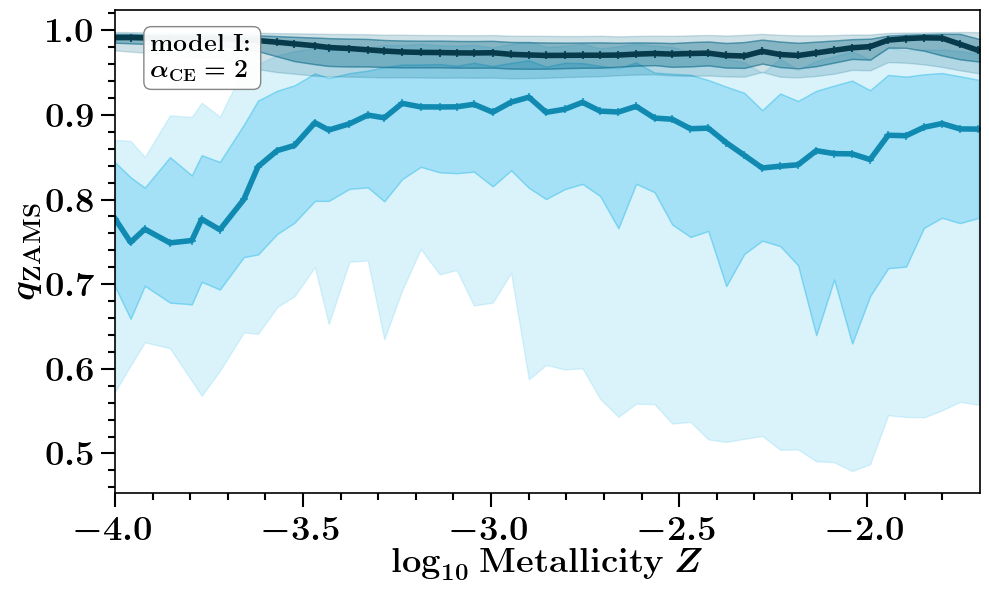


at BPS model  J
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


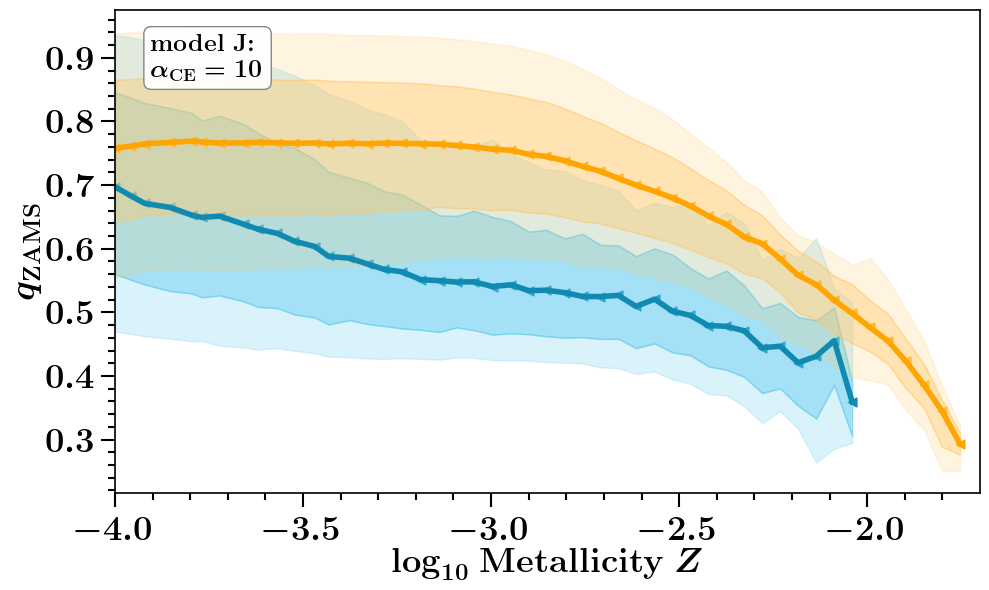


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


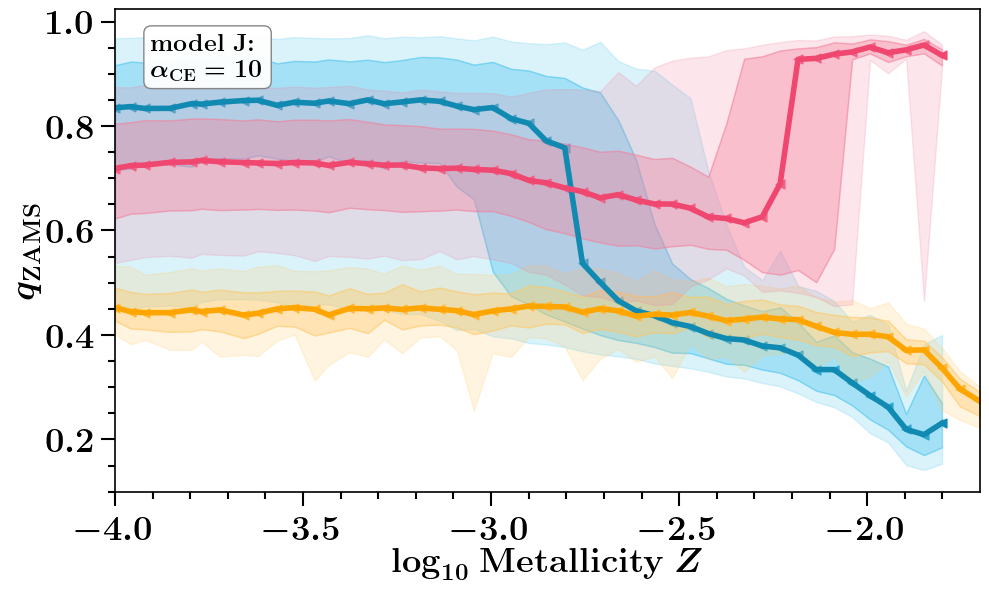


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


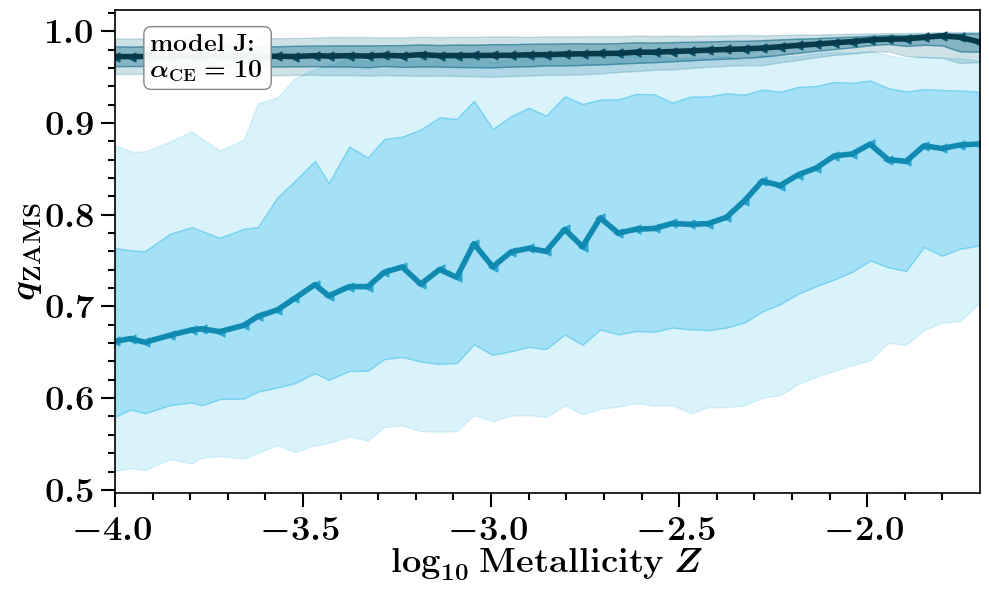


at BPS model  K
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


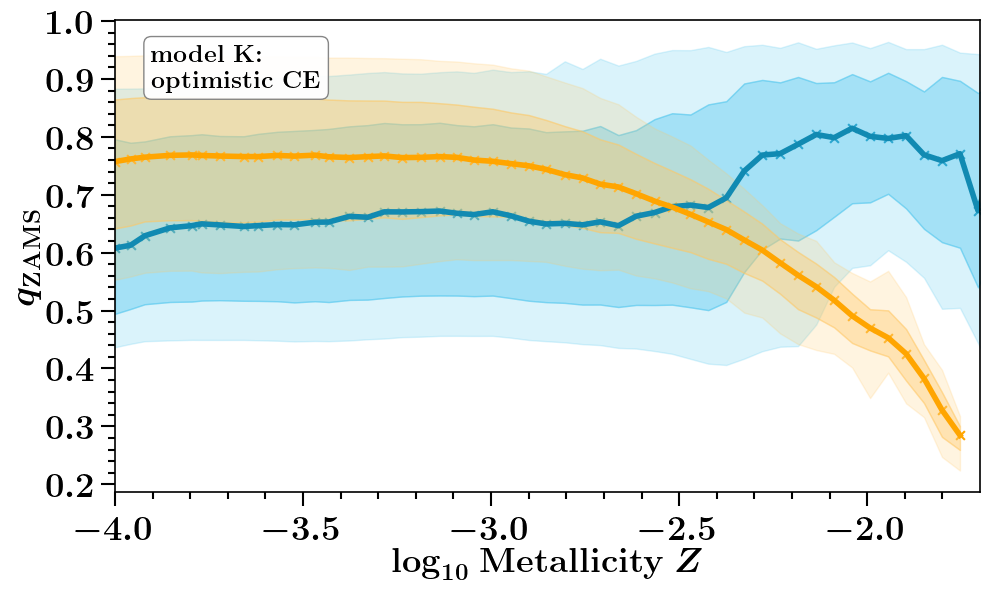


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


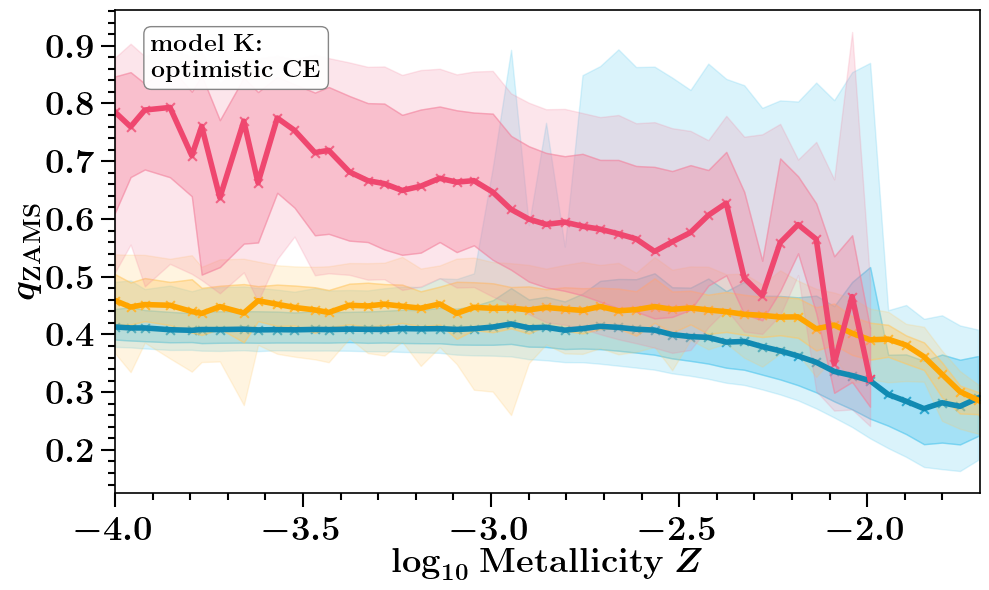


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


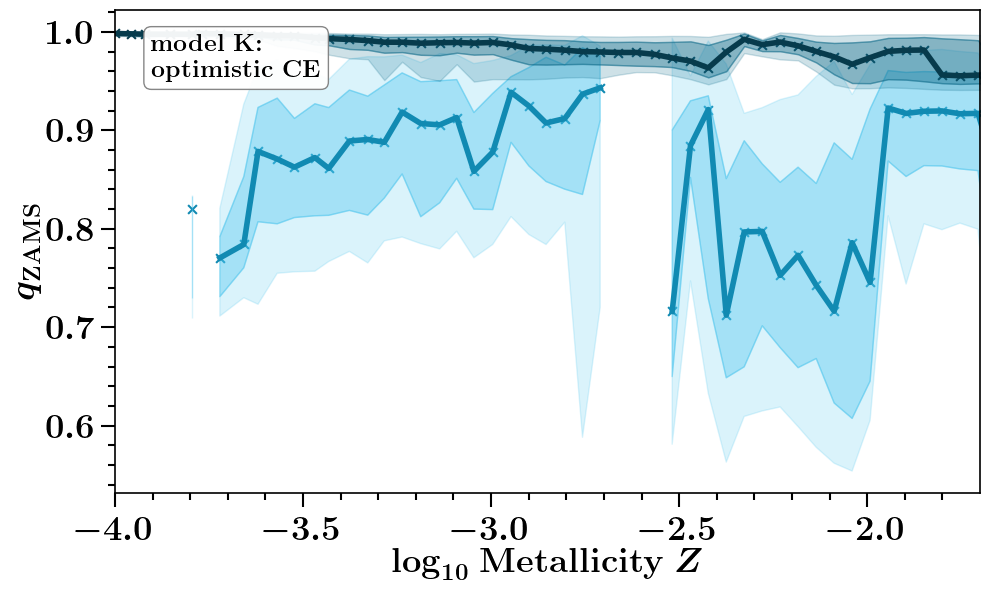


at BPS model  L
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


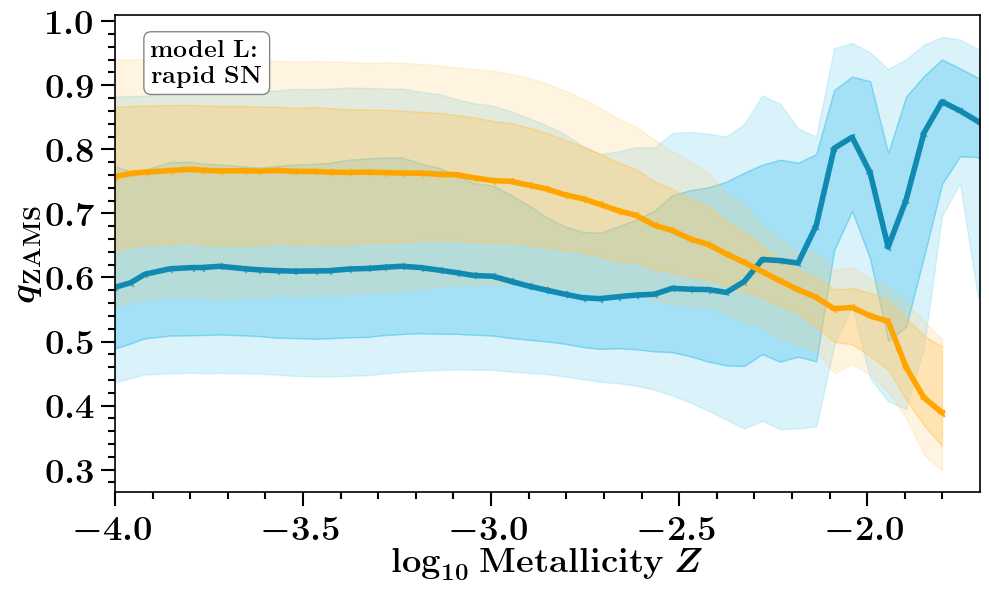


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


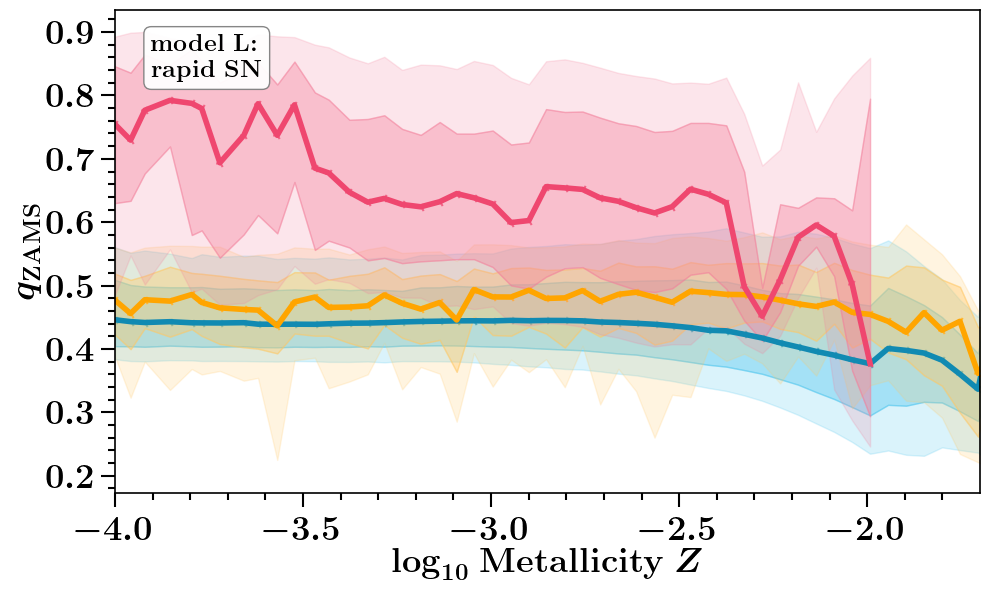


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


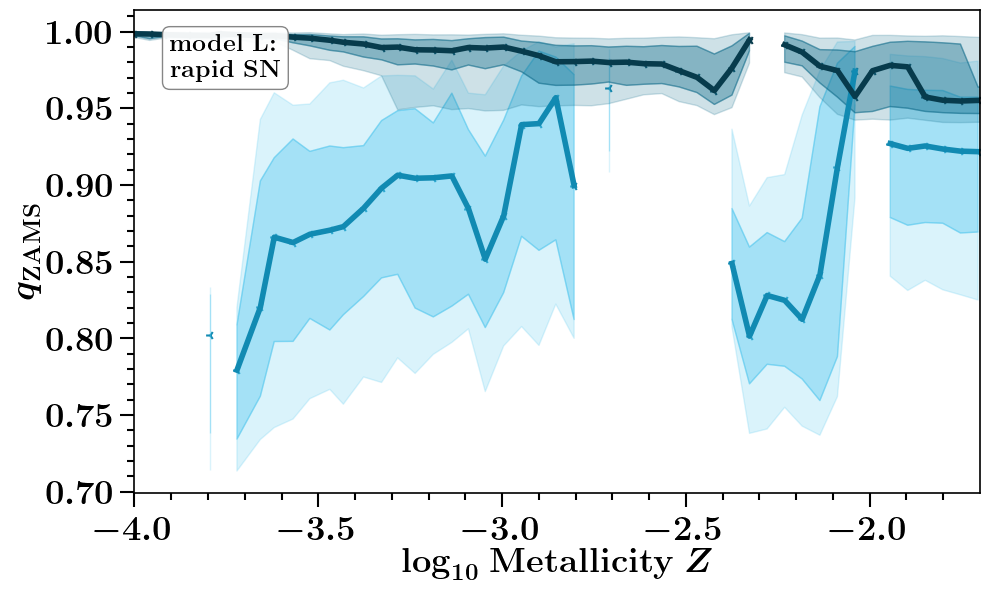


at BPS model  M
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


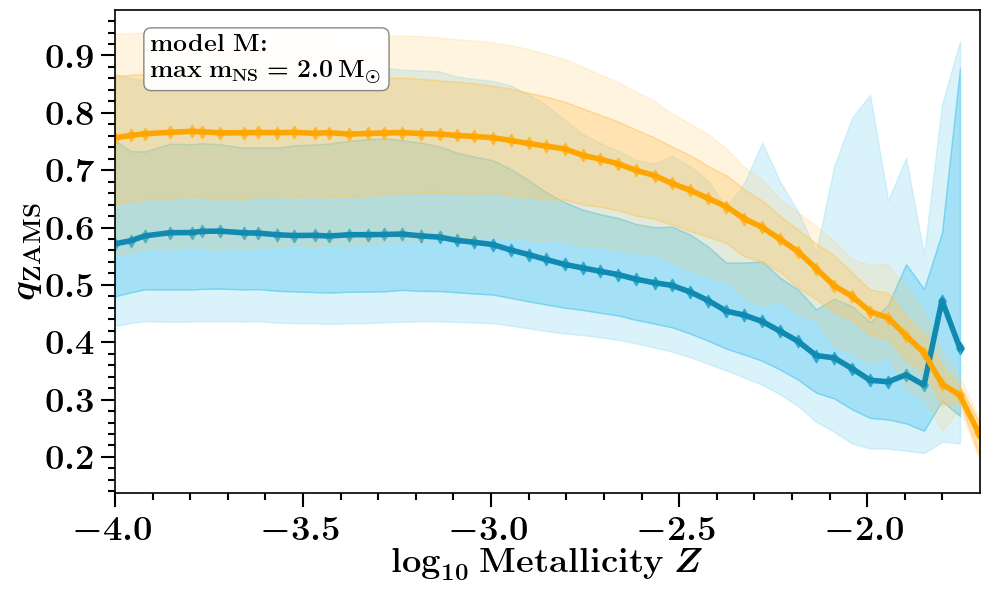


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


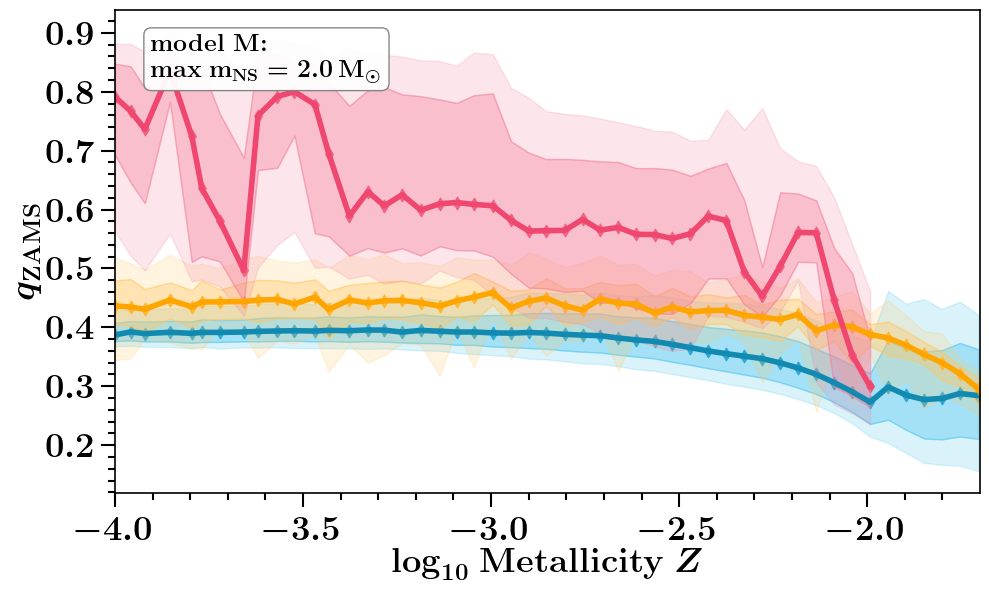


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


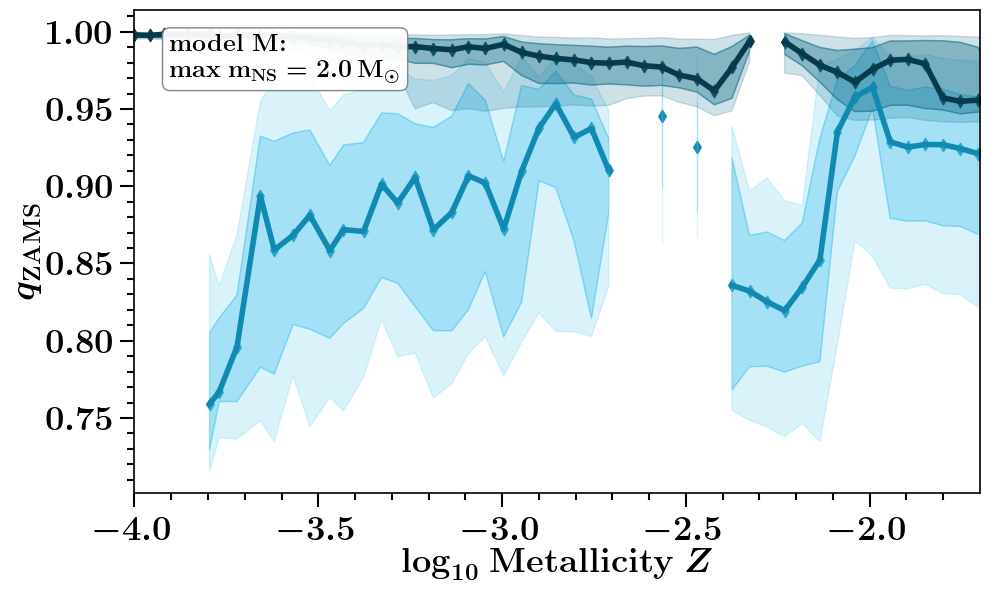


at BPS model  N
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


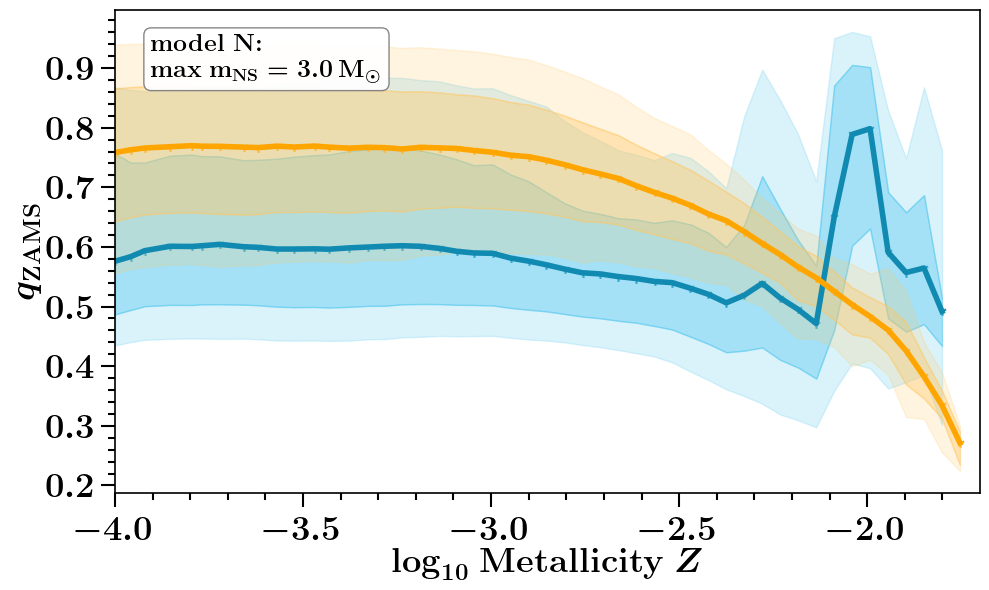


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


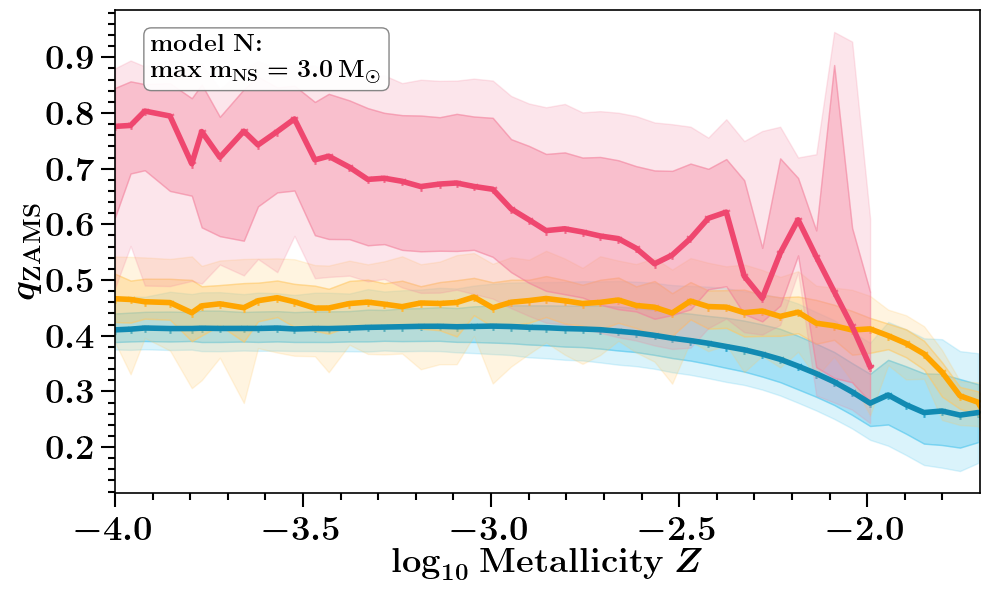


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


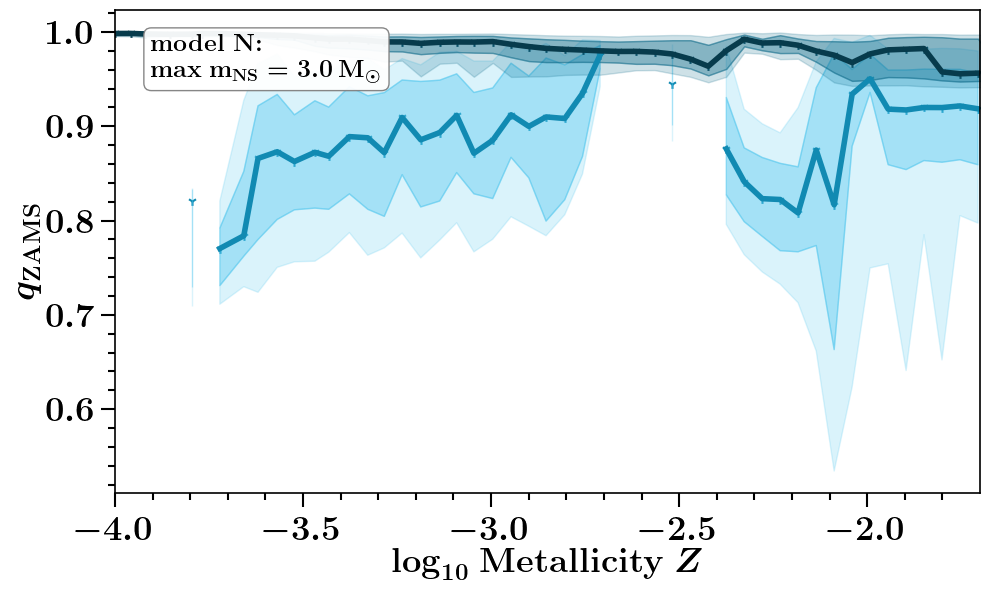


at BPS model  O
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


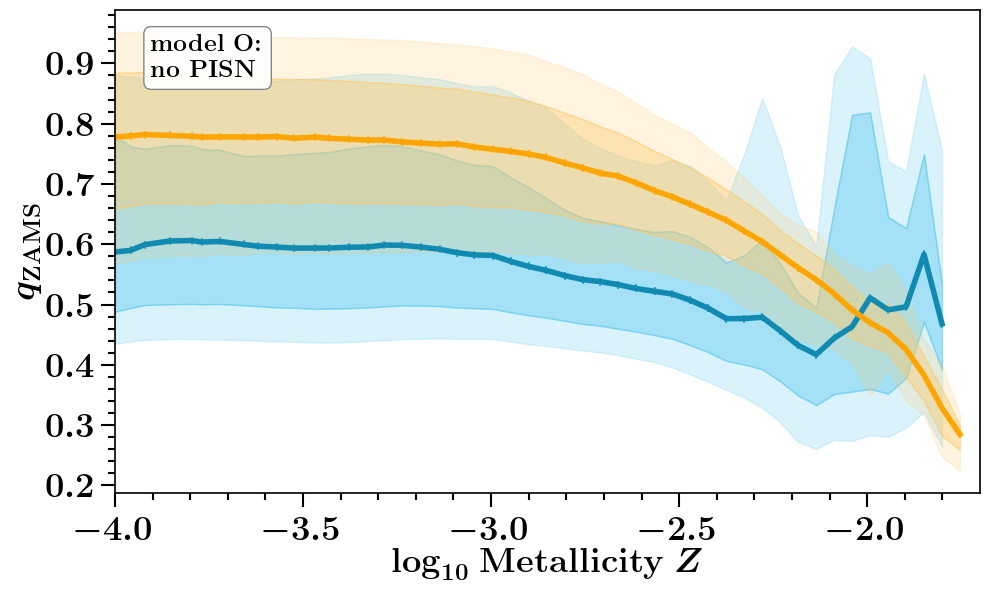


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


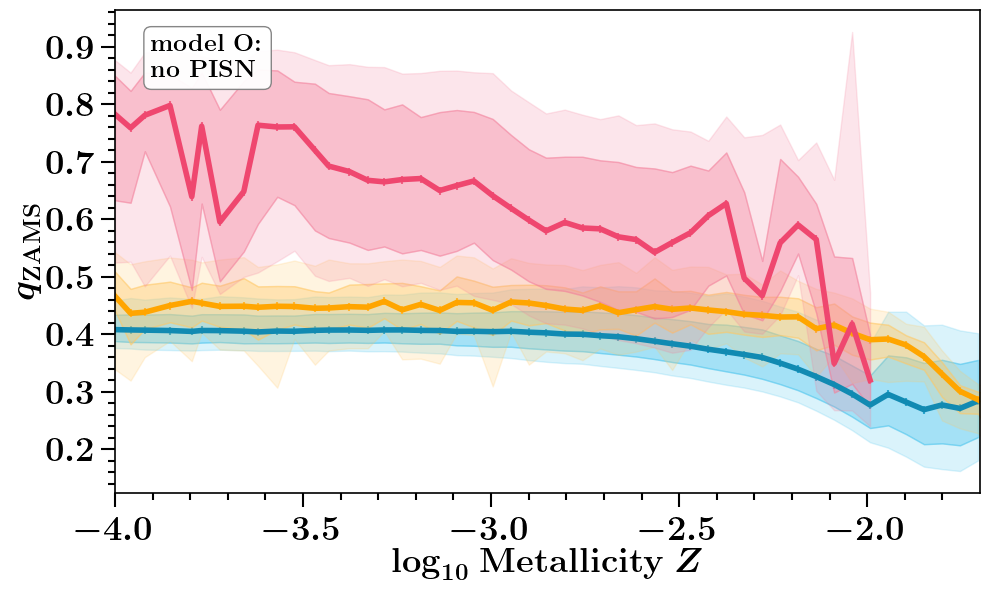


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


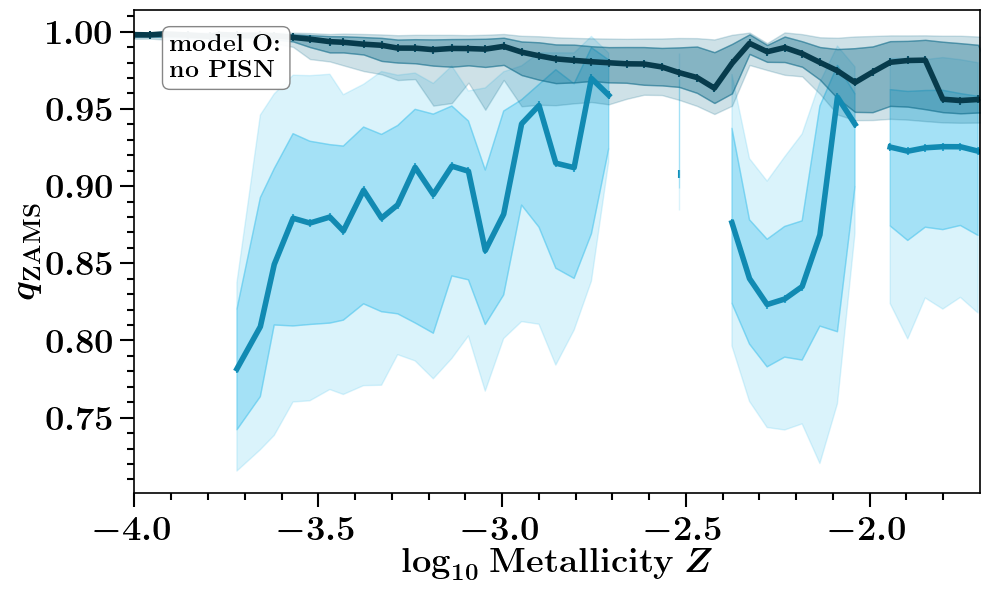


at BPS model  P
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


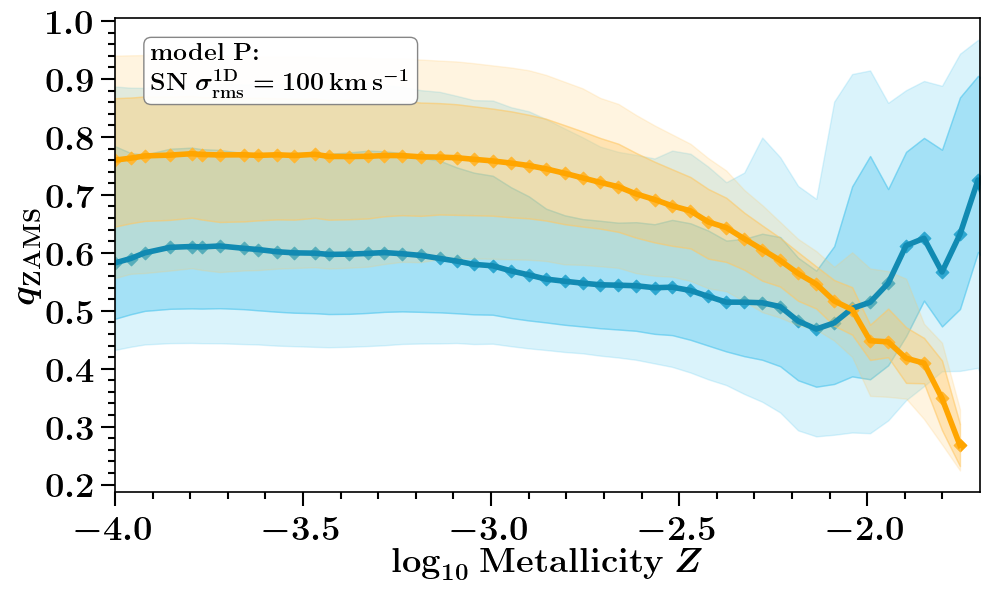


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


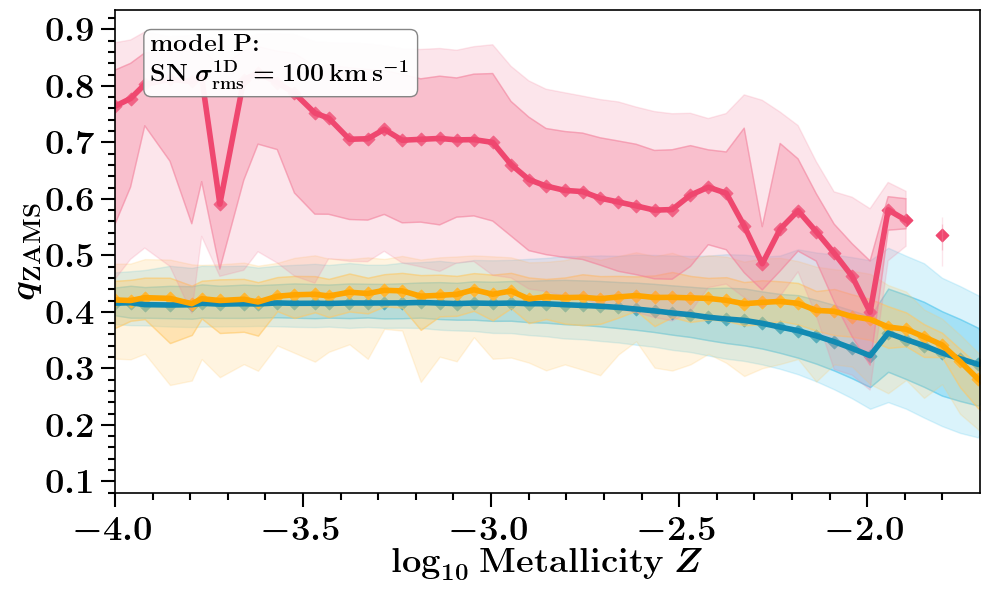


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


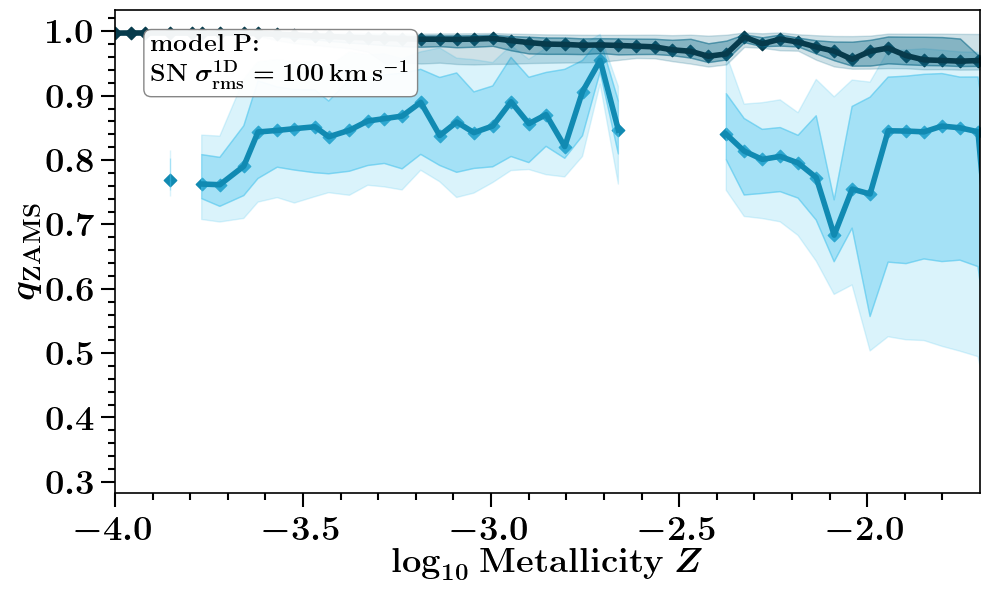


at BPS model  Q
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


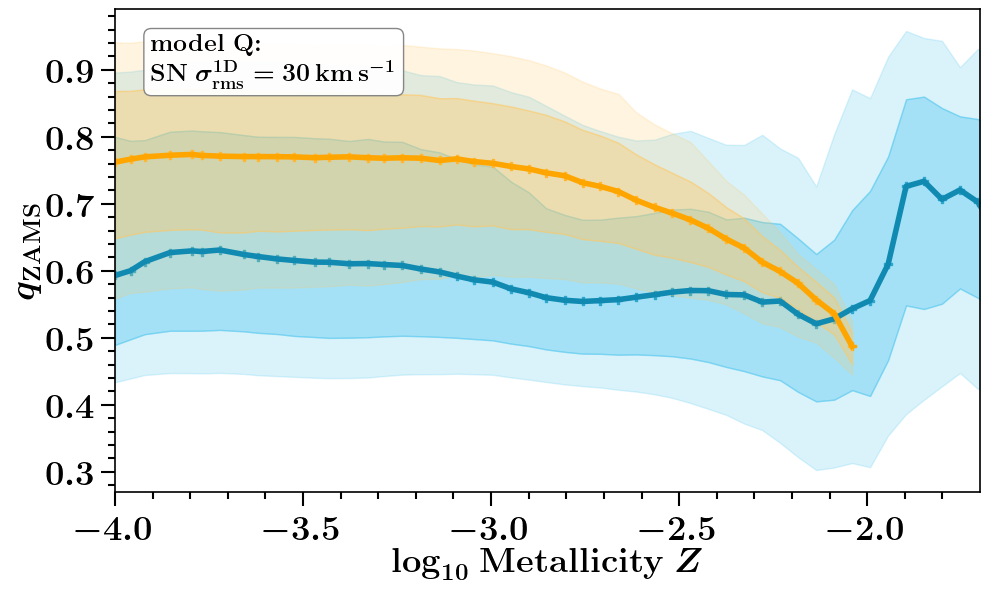


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


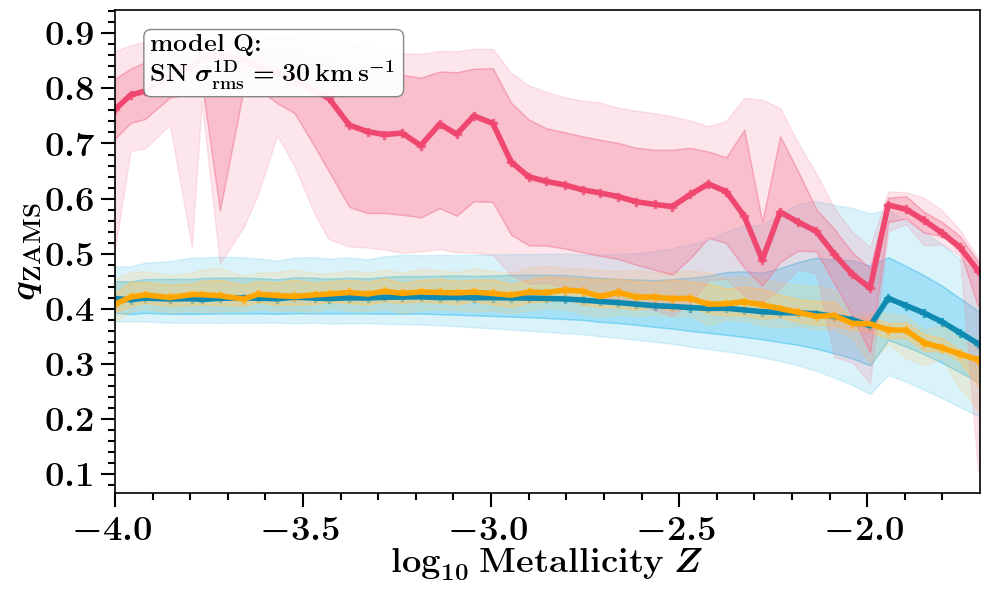


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


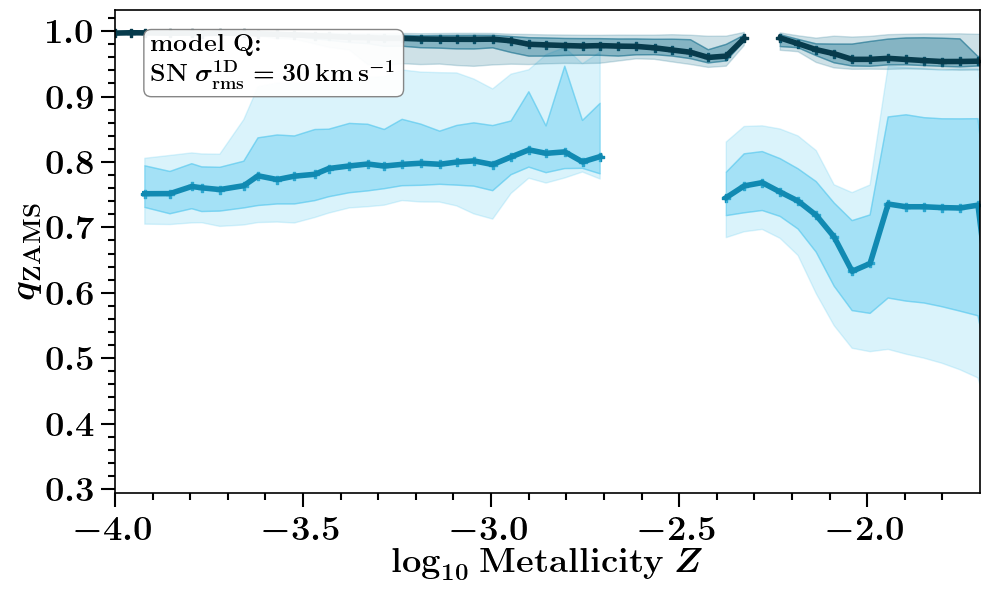


at BPS model  R
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


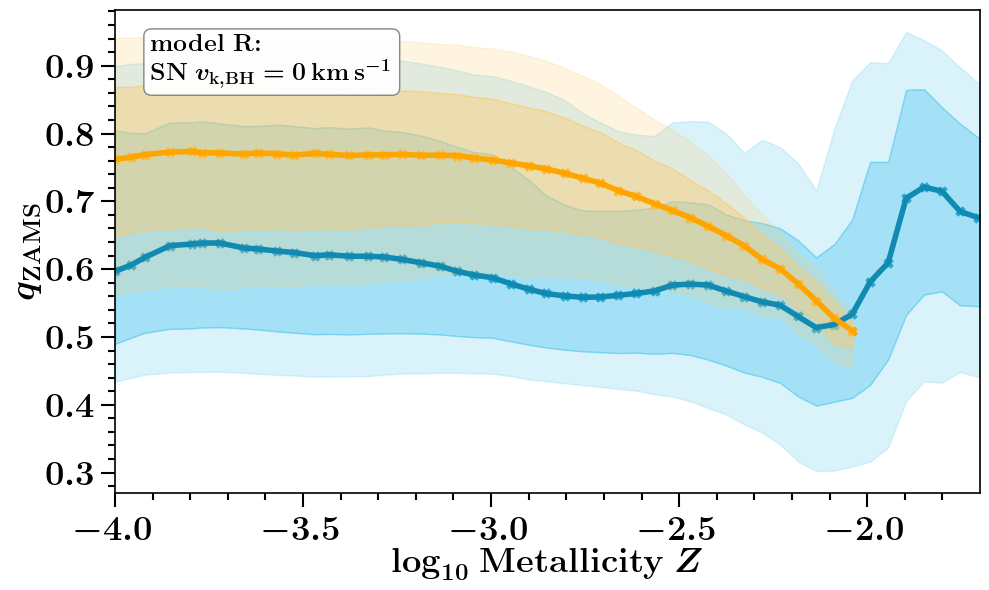


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


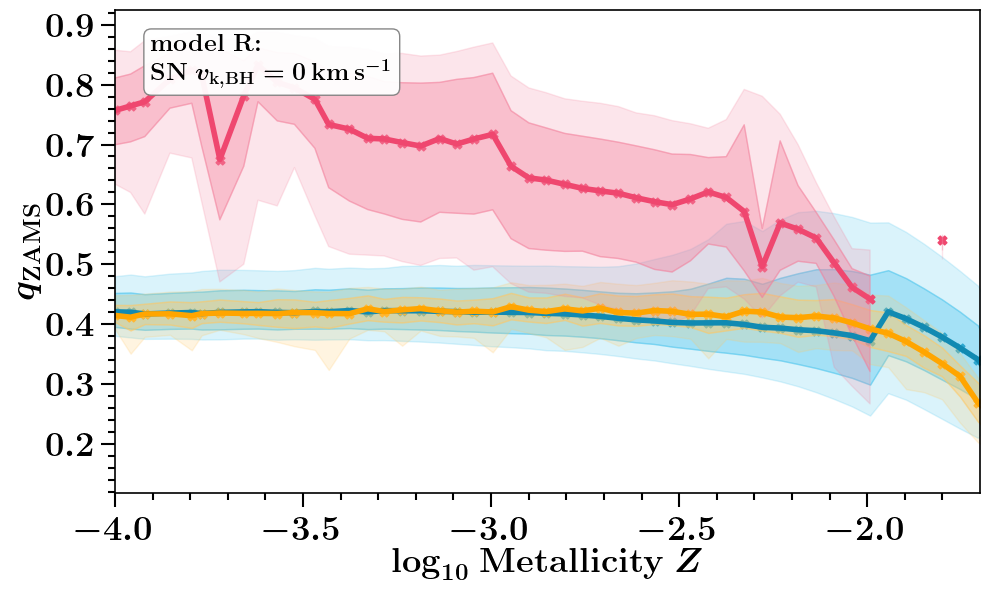


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


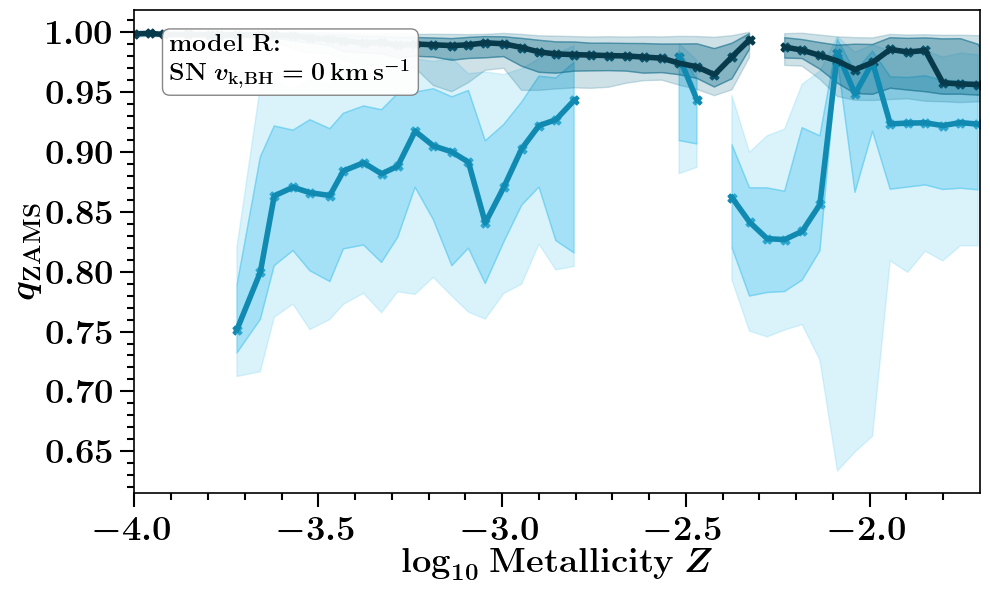


at BPS model  S
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


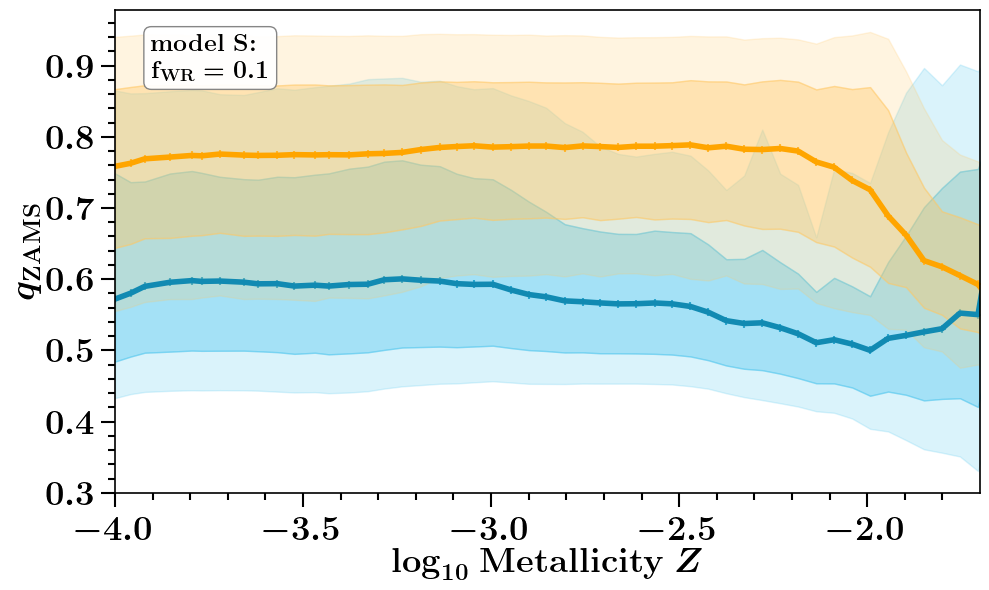


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


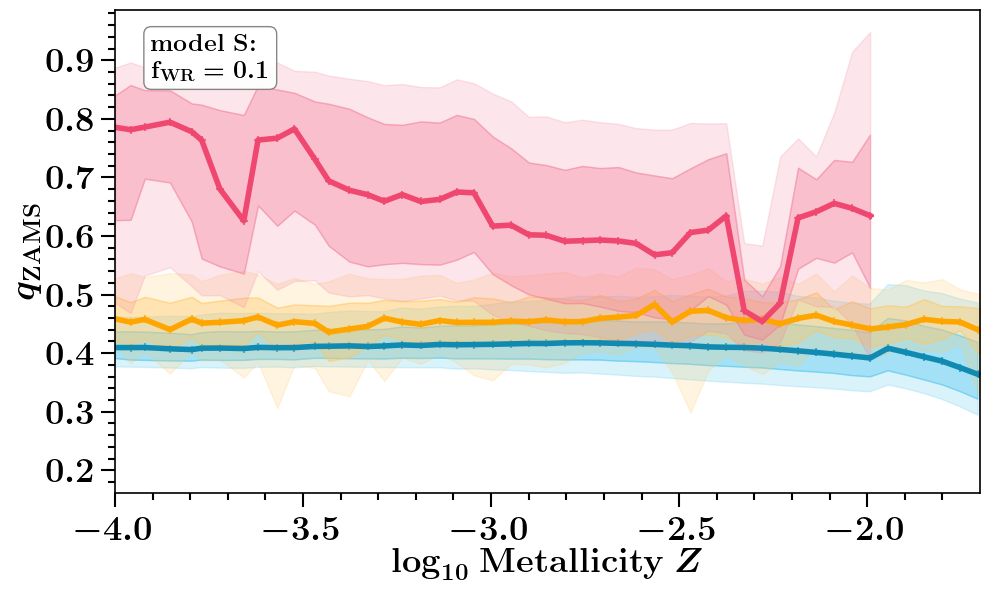


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


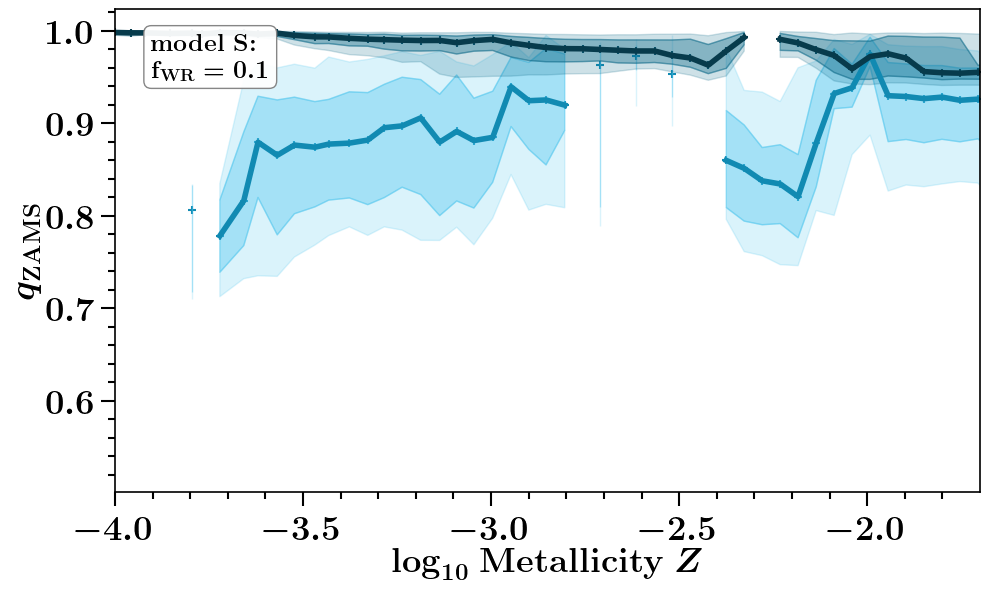


at BPS model  T
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


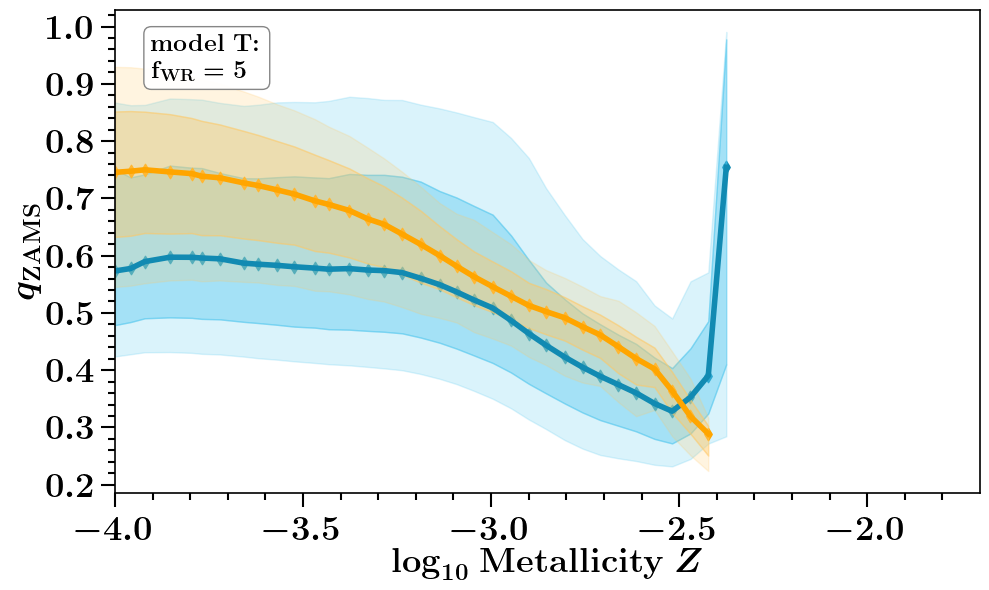


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


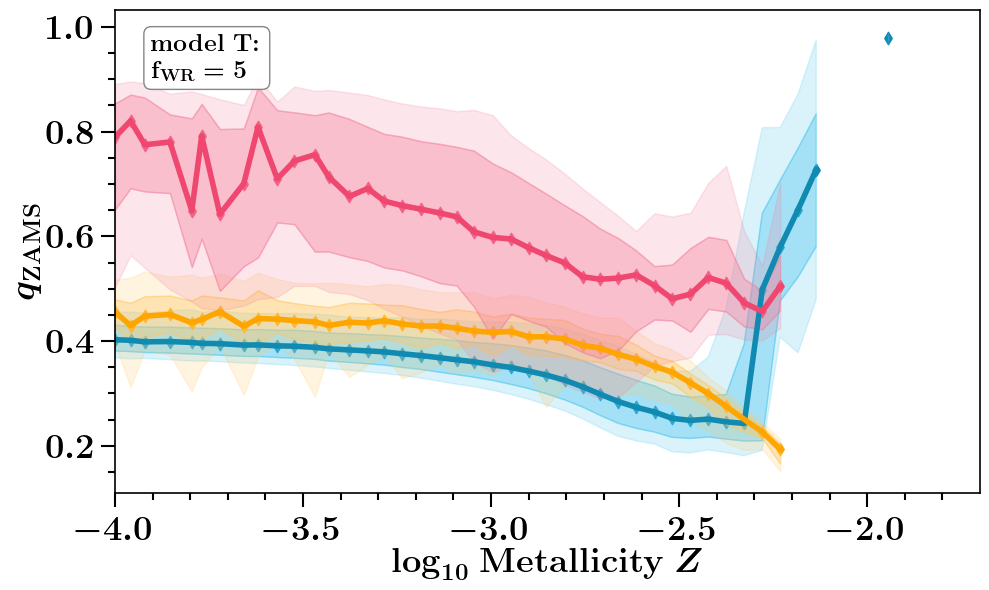


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


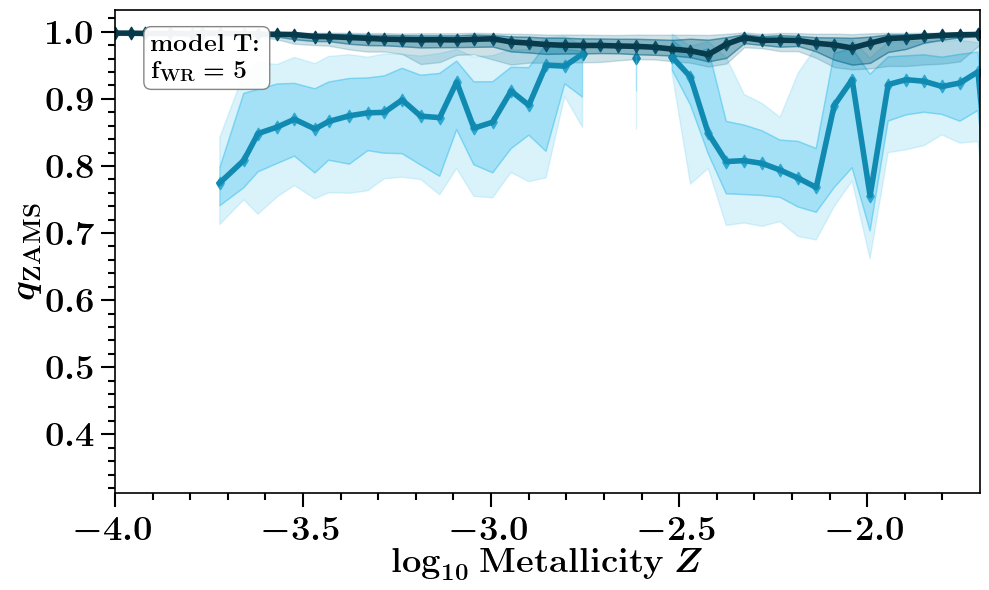


at xparam  separationInitial
at BPS model  A
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


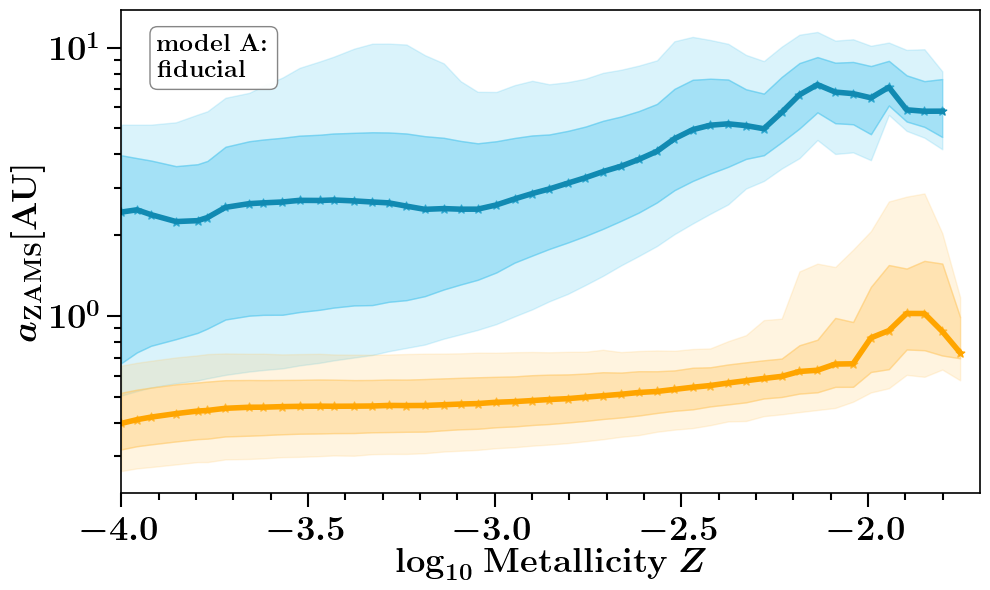


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


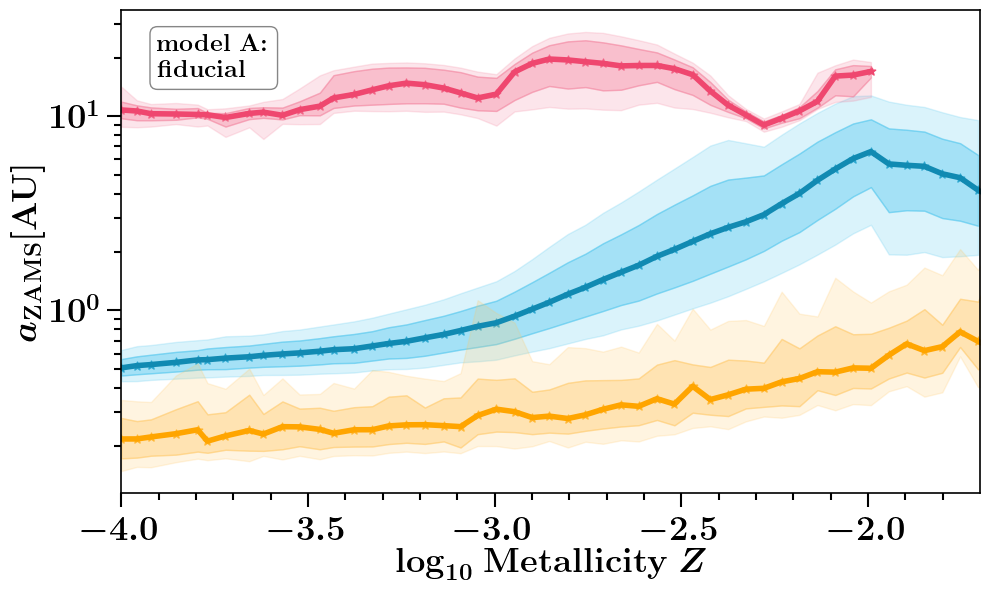


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


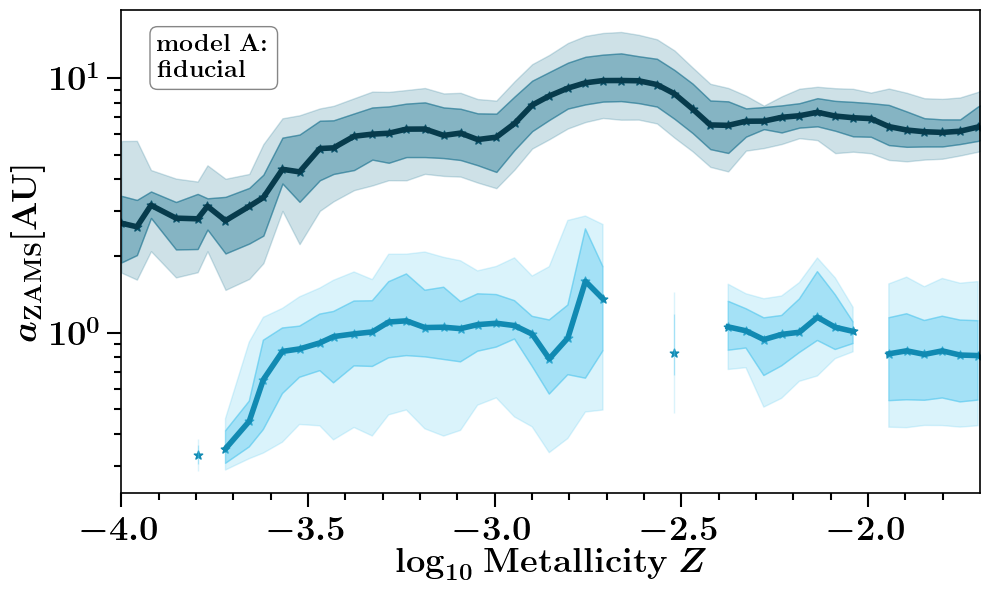


at BPS model  B
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


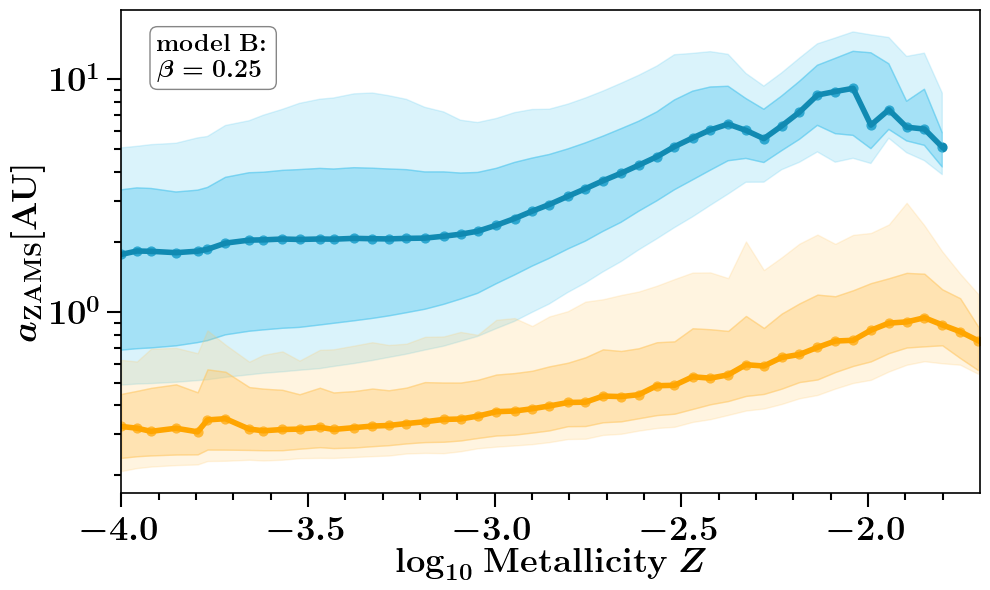


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


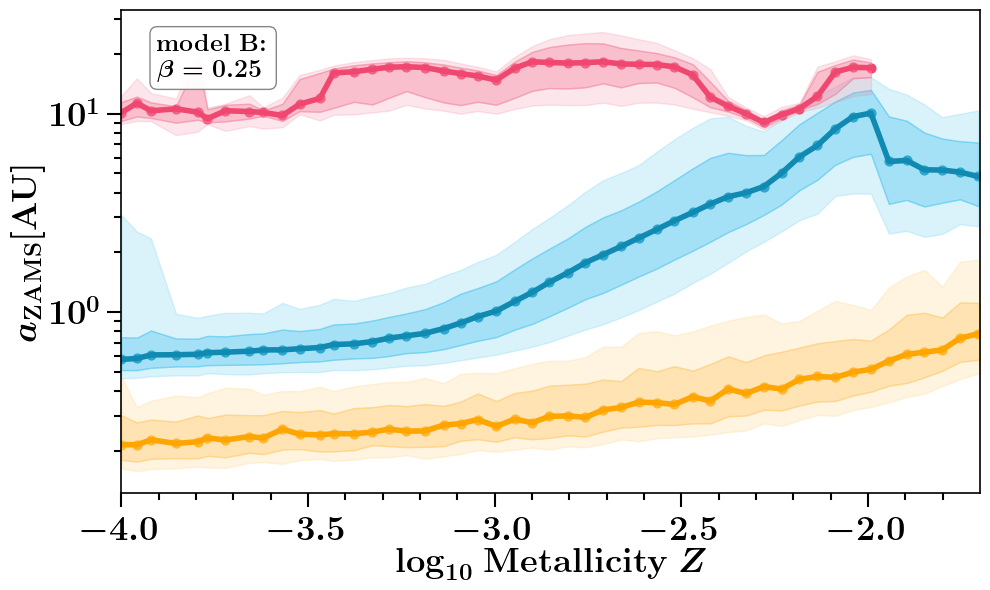


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


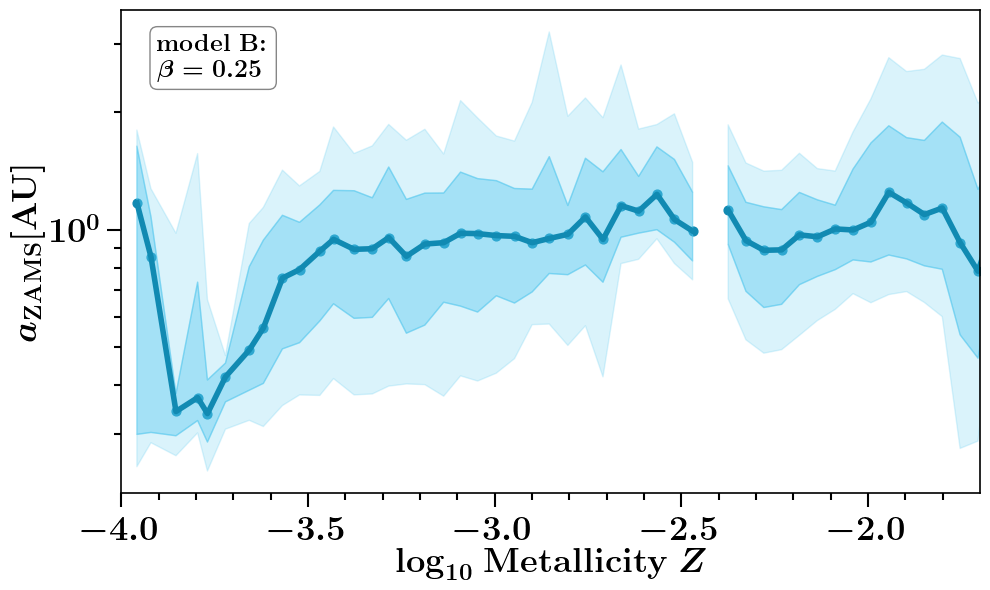


at BPS model  C
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


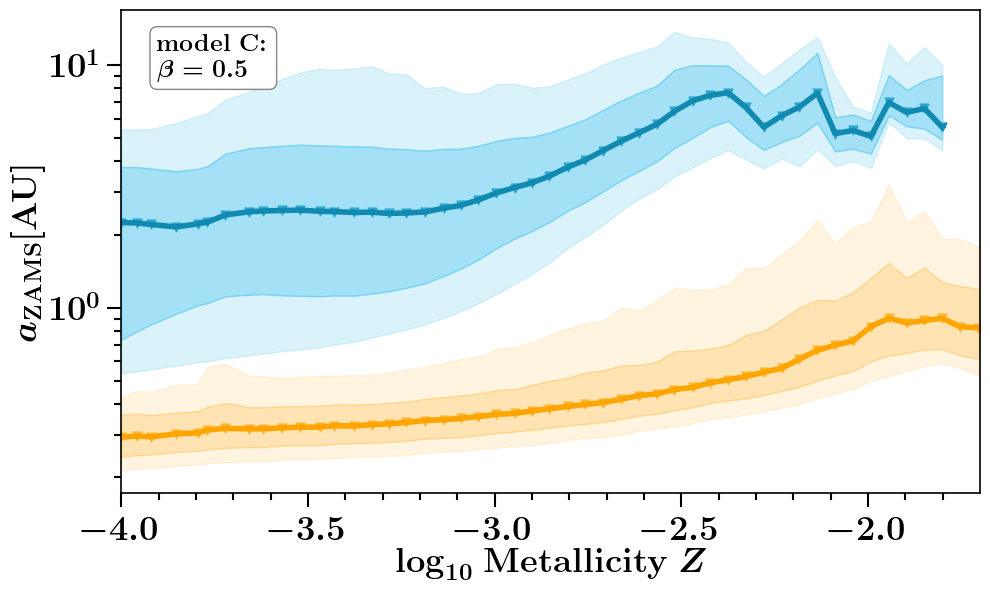


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


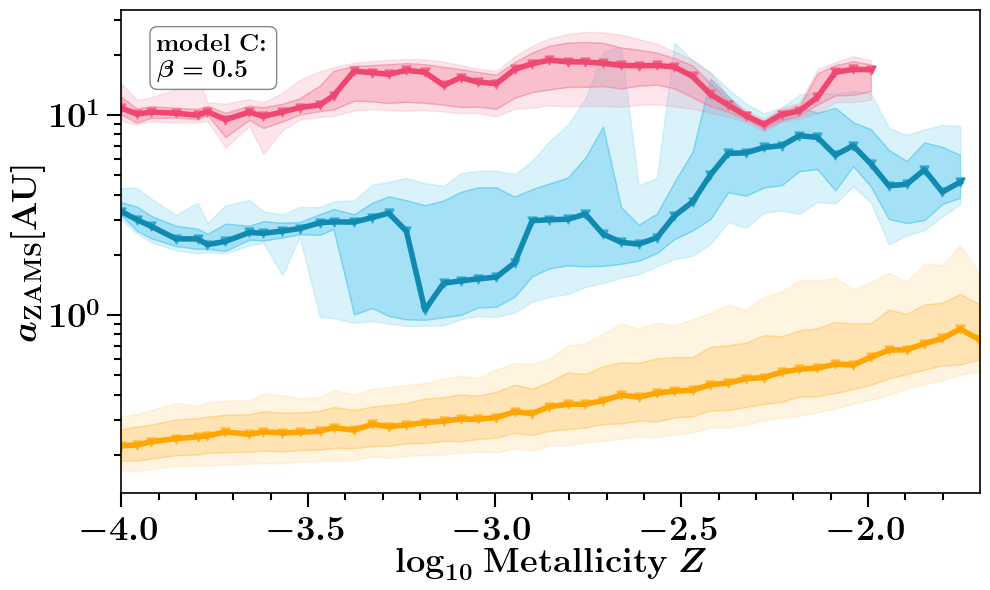


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


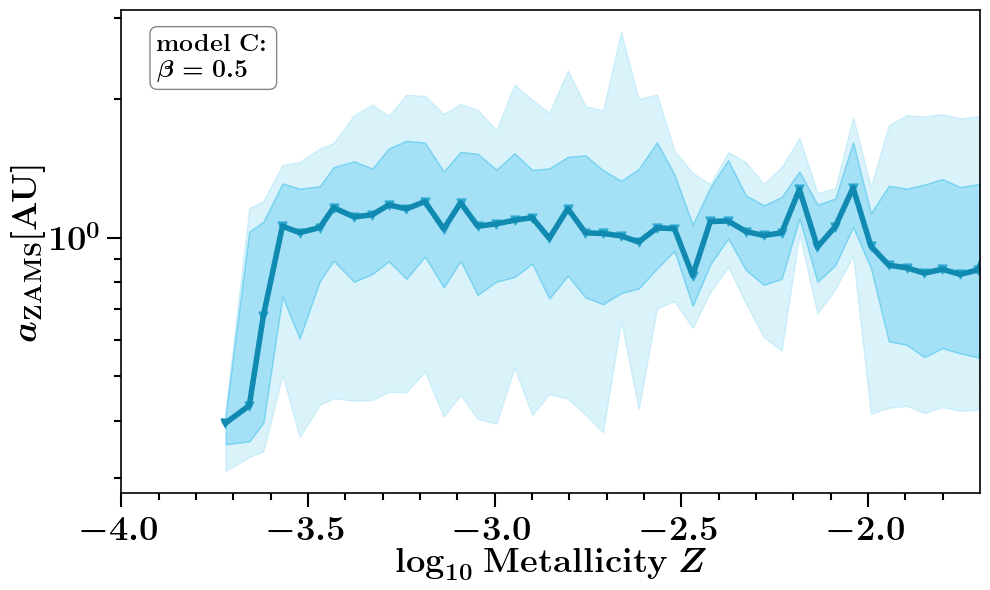


at BPS model  D
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


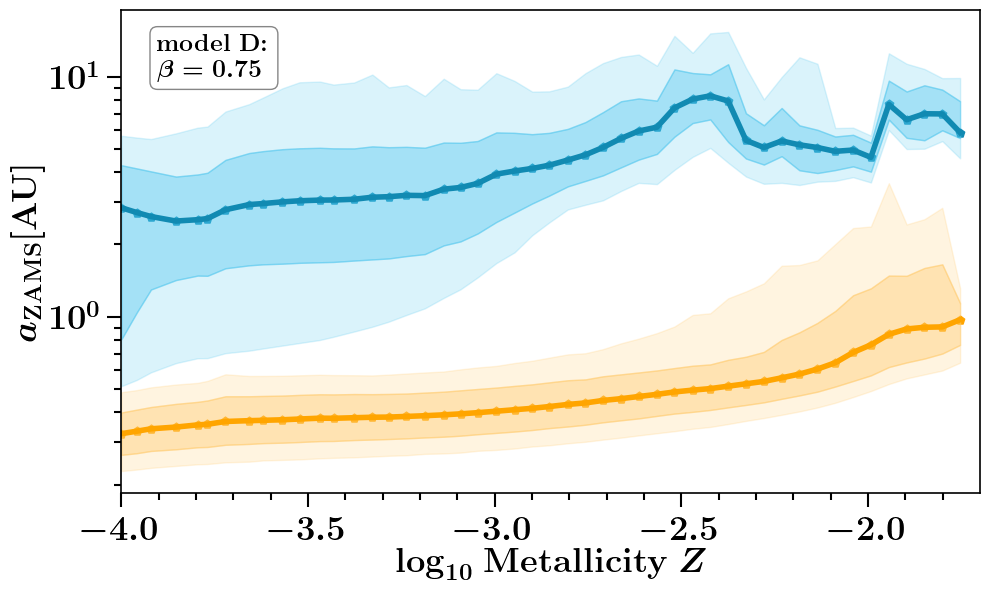


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


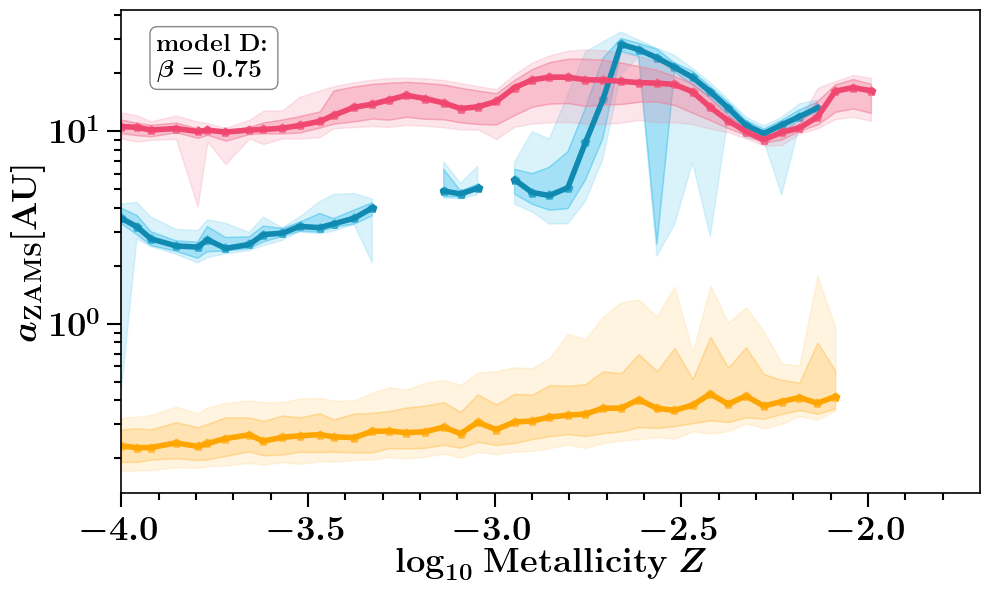


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


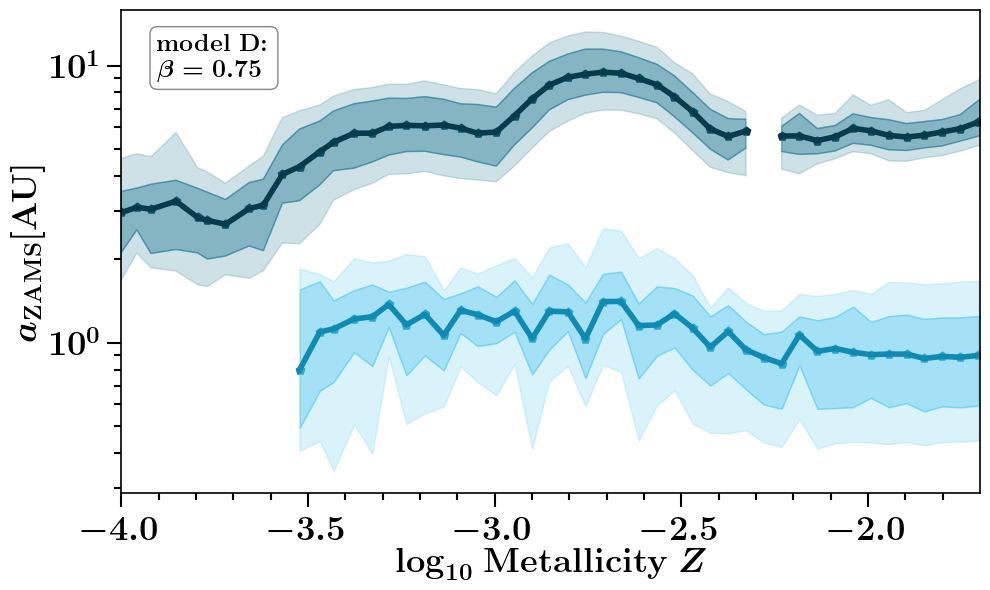


at BPS model  E
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


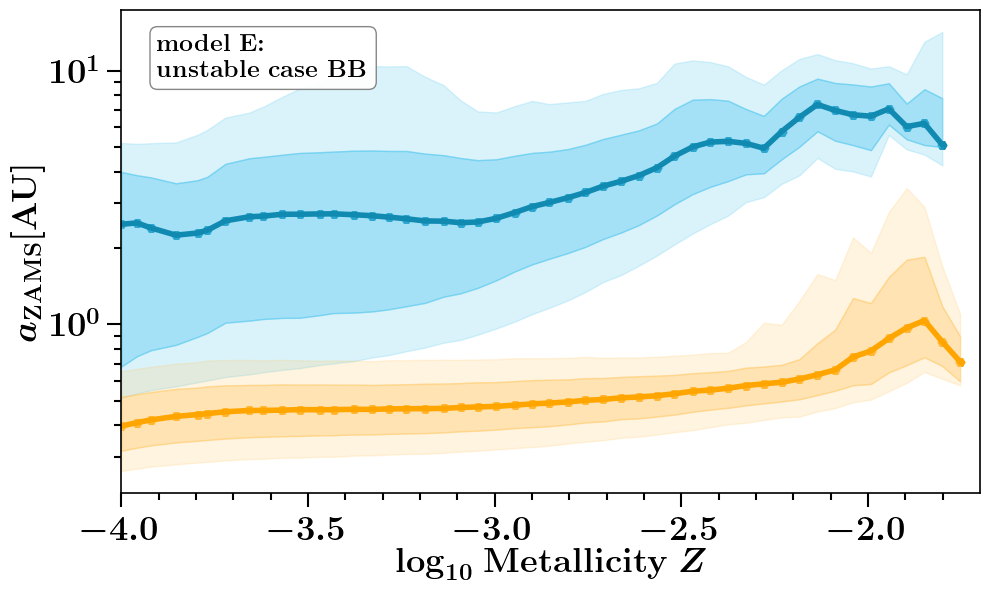


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


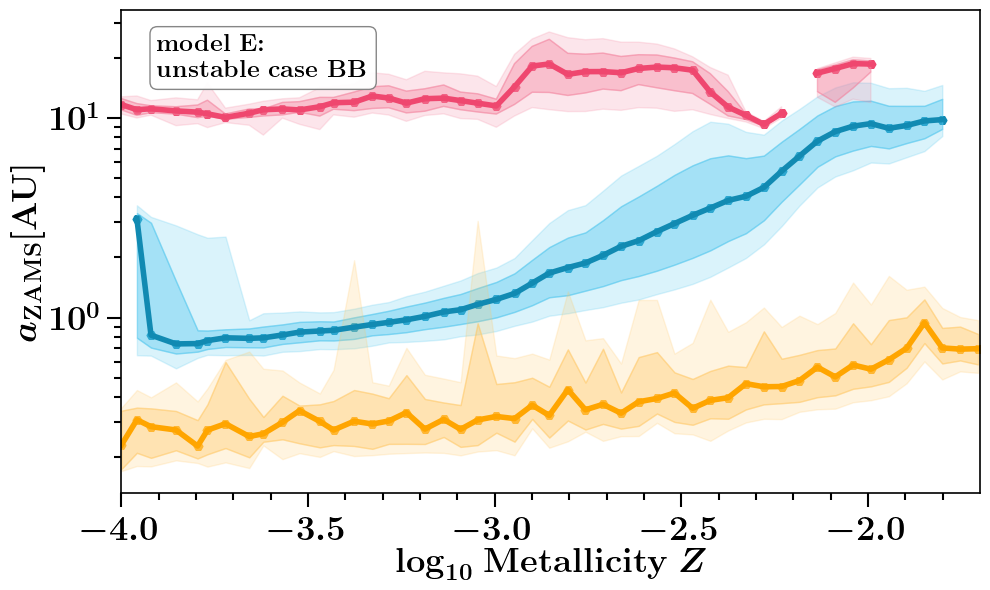


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


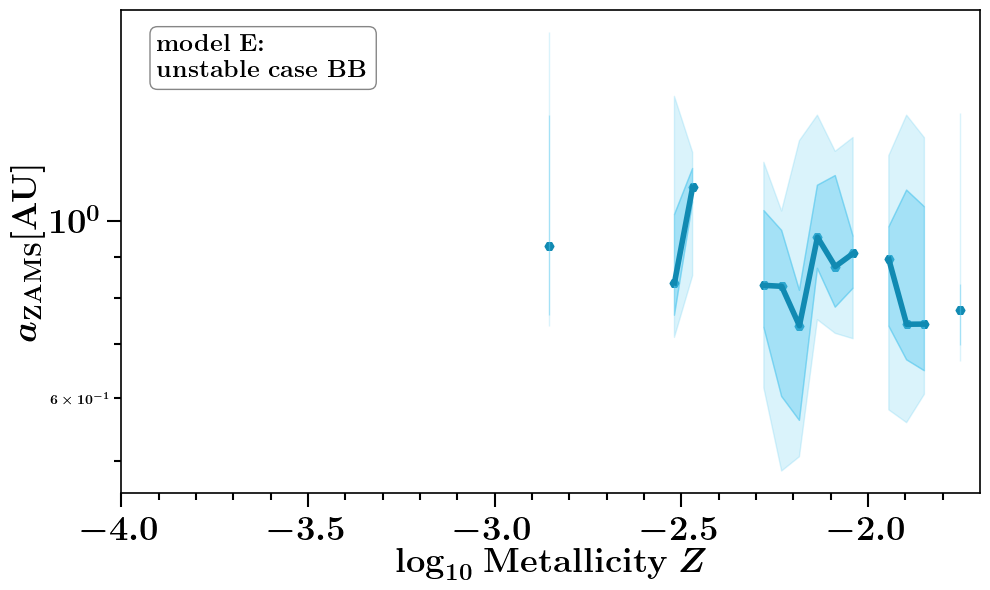


at BPS model  F
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


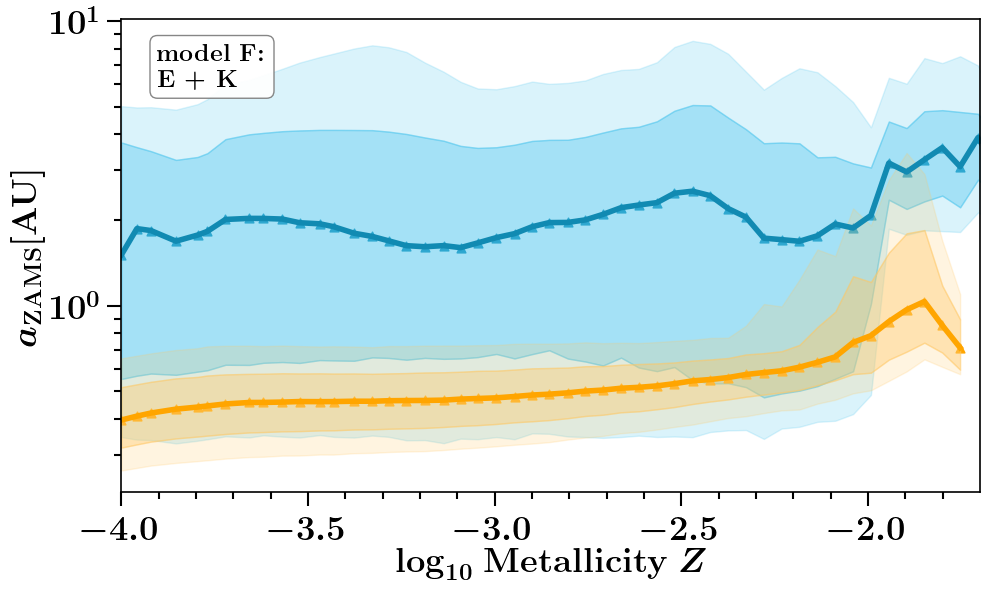


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


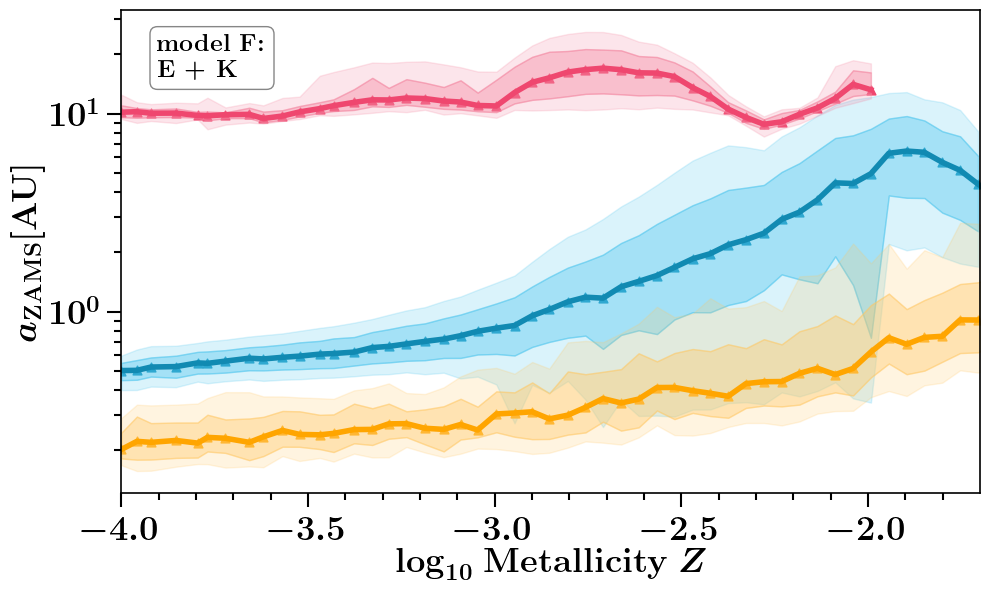


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


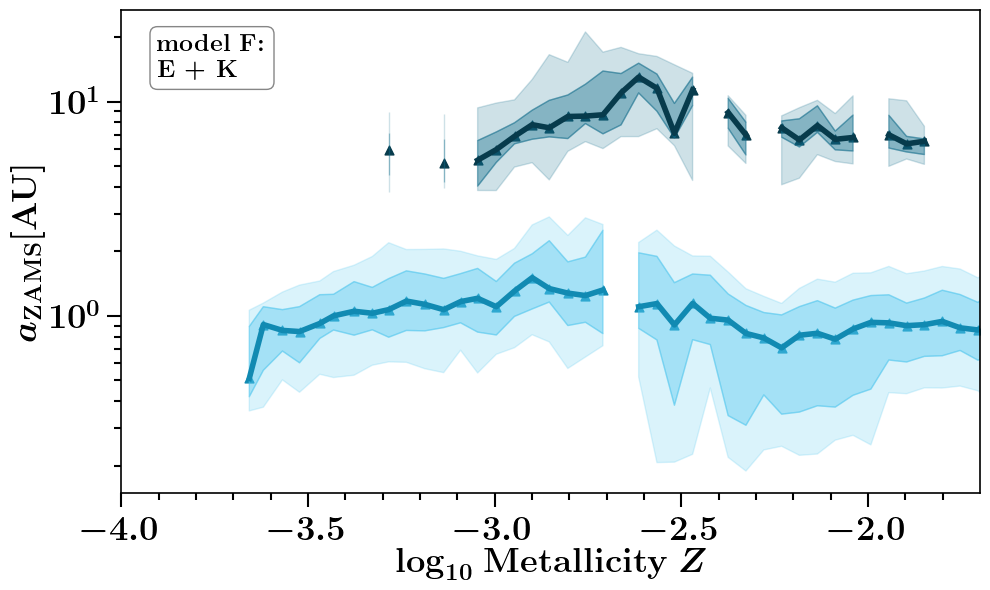


at BPS model  G
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


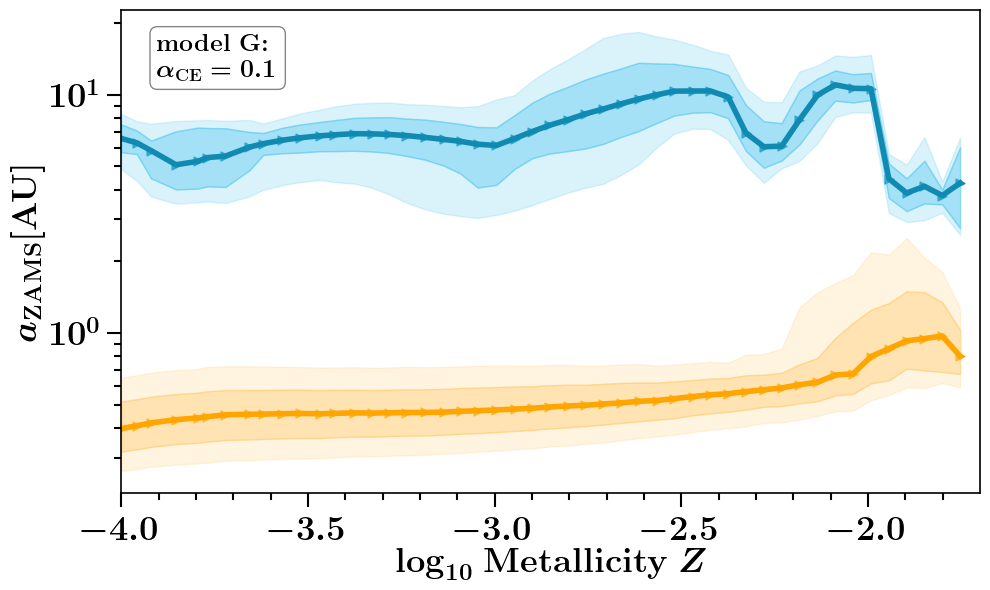


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


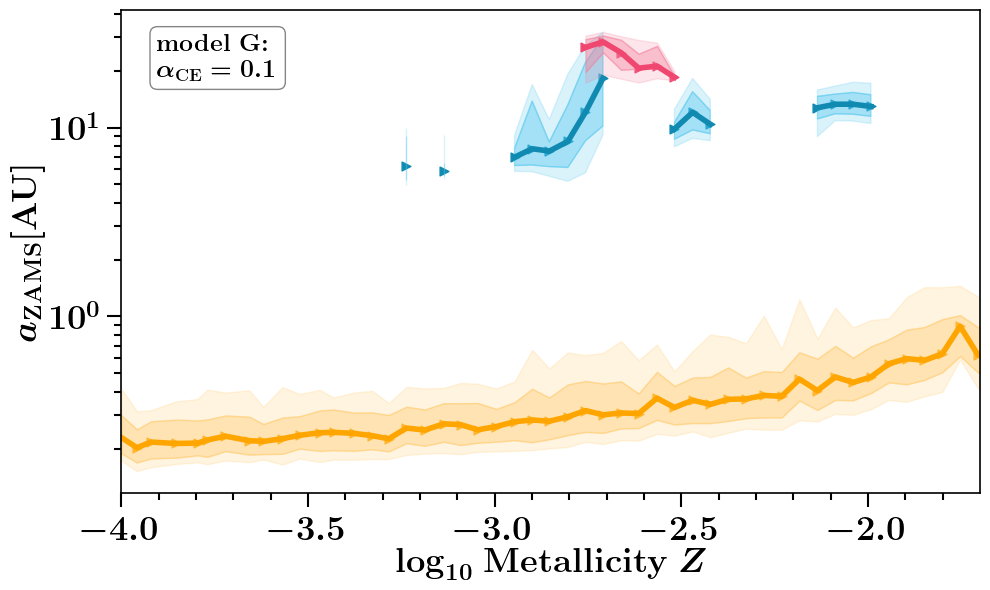


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


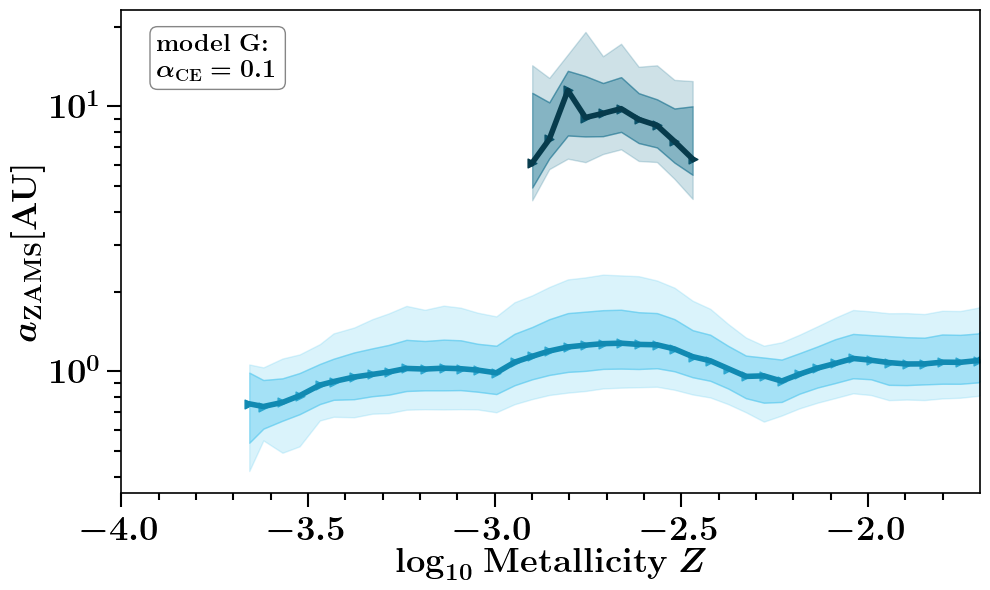


at BPS model  H
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


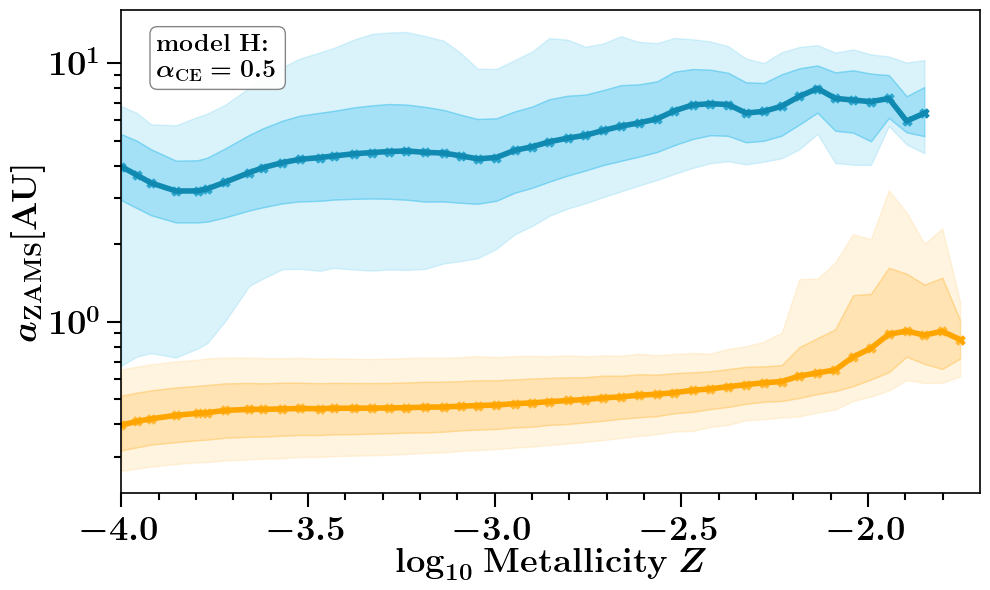


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


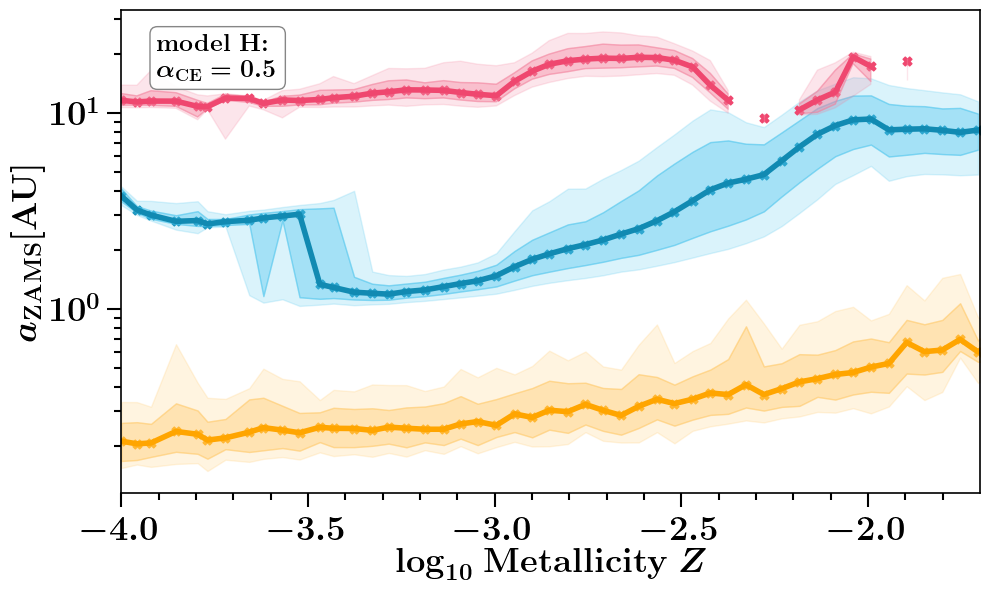


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


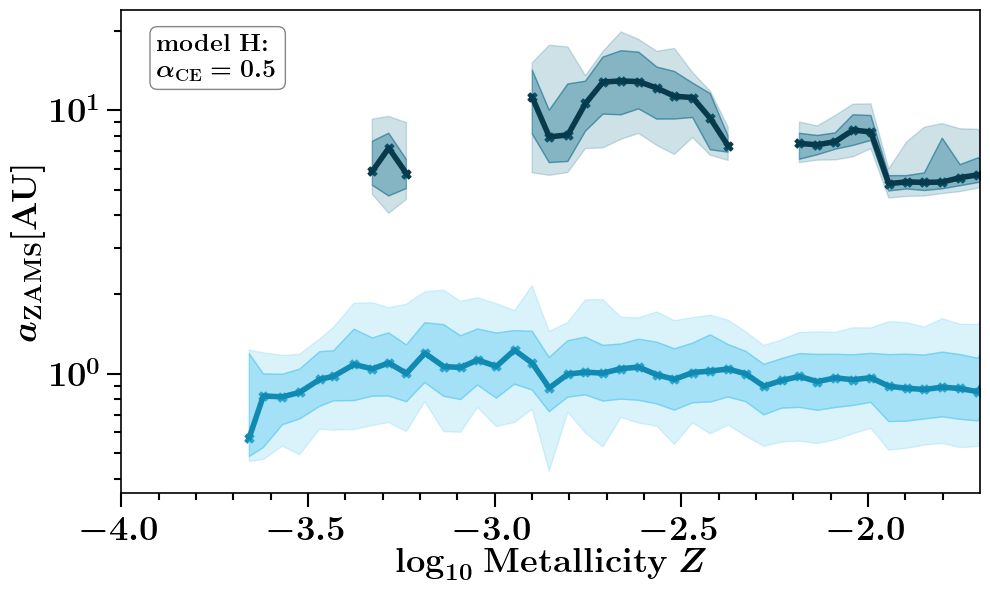


at BPS model  I
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


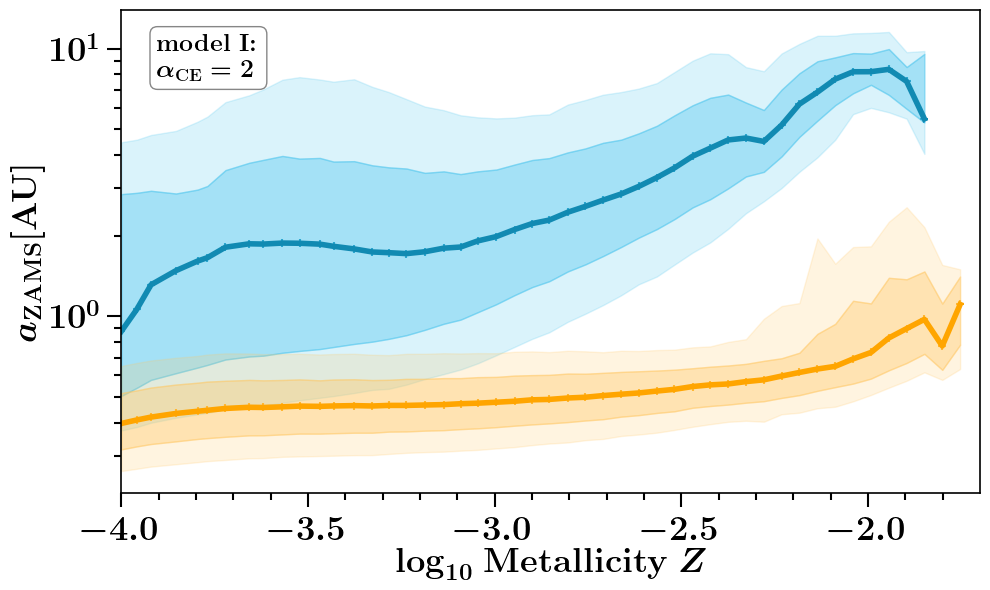


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


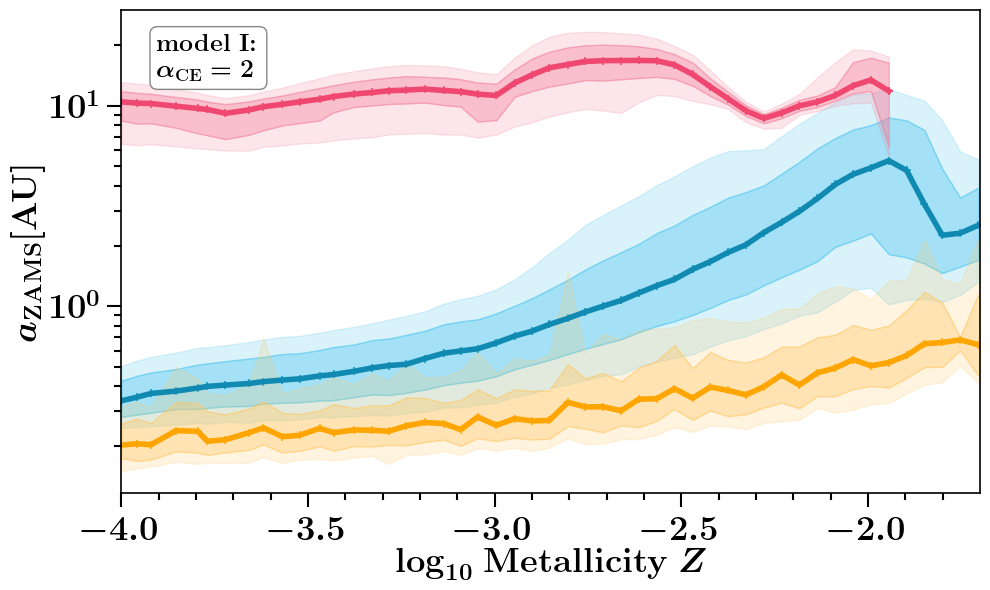


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


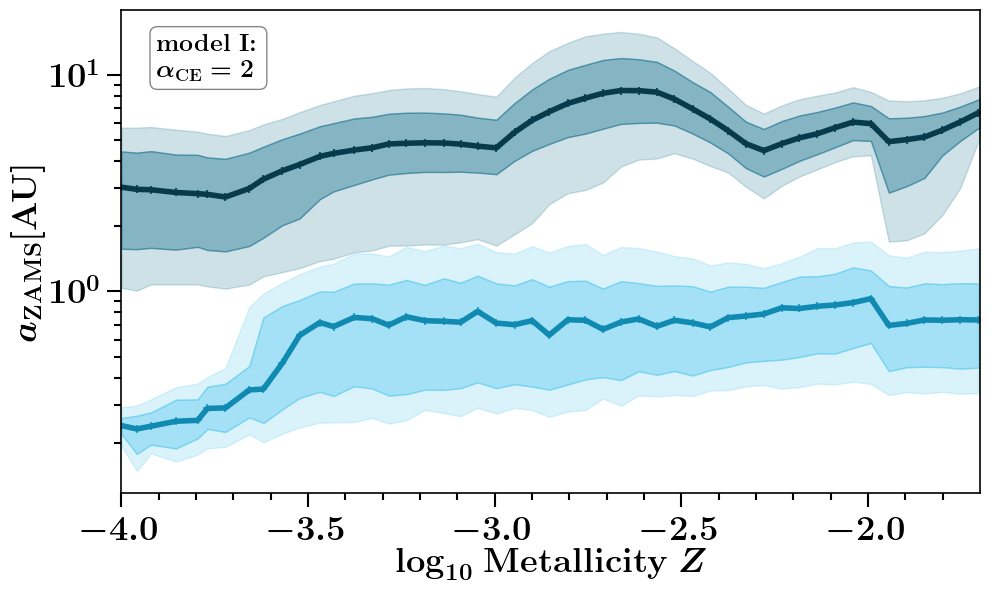


at BPS model  J
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


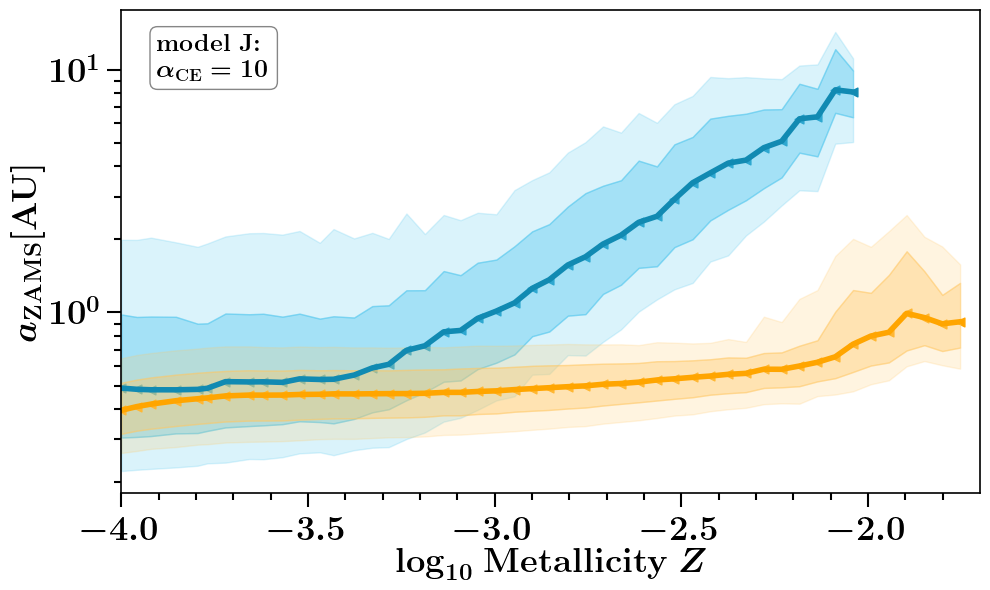


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


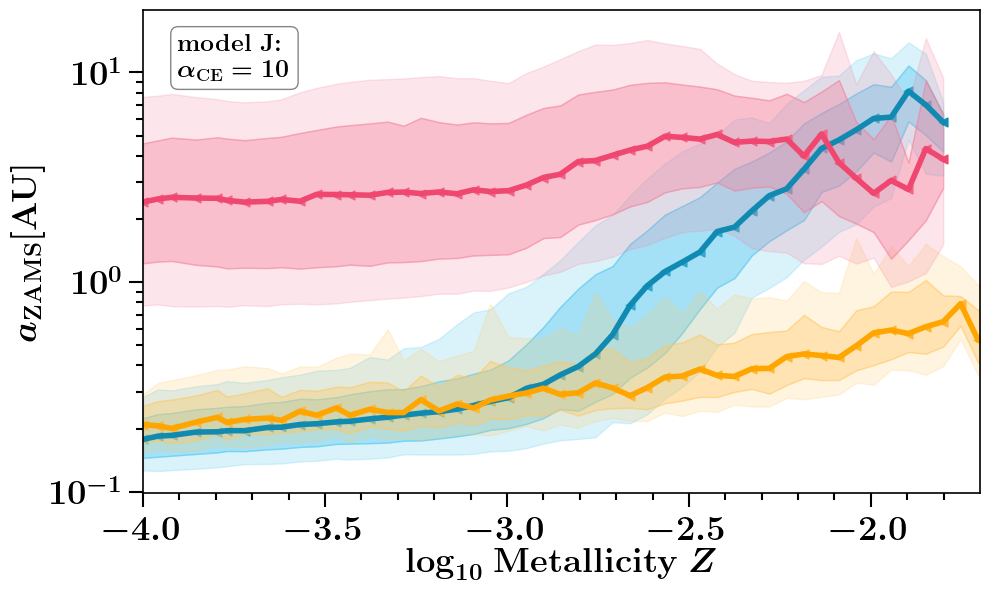


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


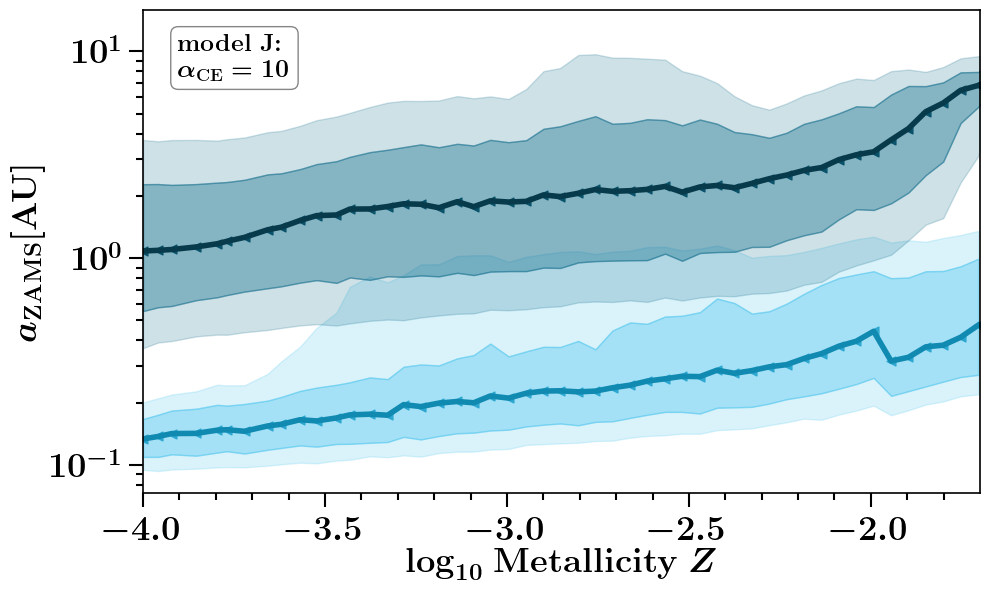


at BPS model  K
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


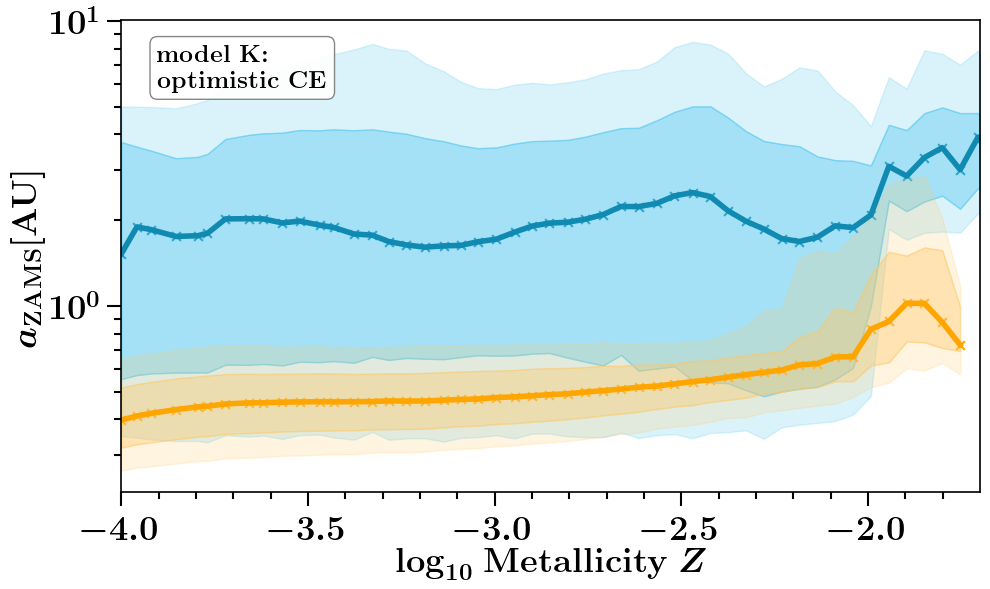


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


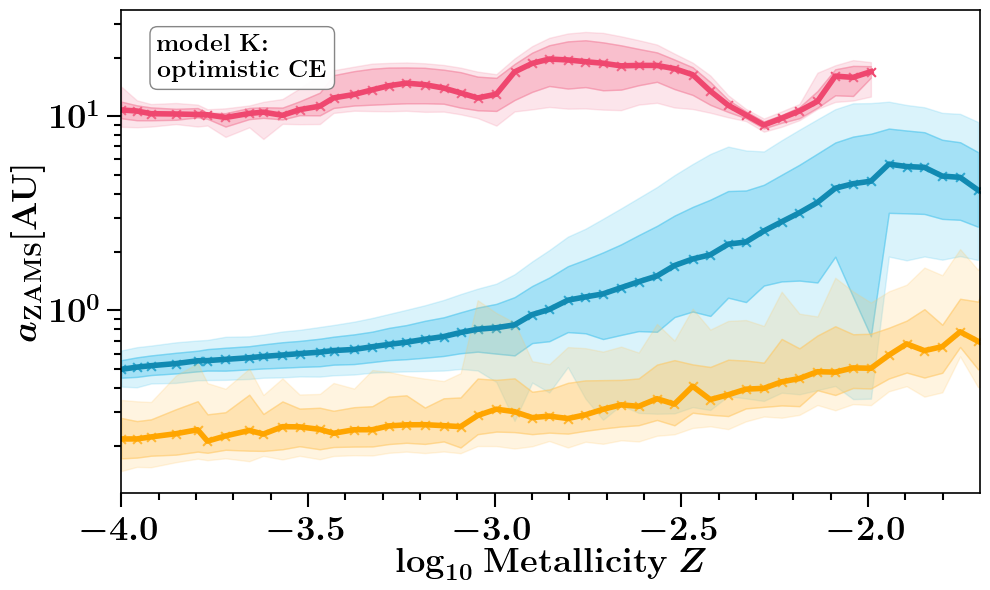


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


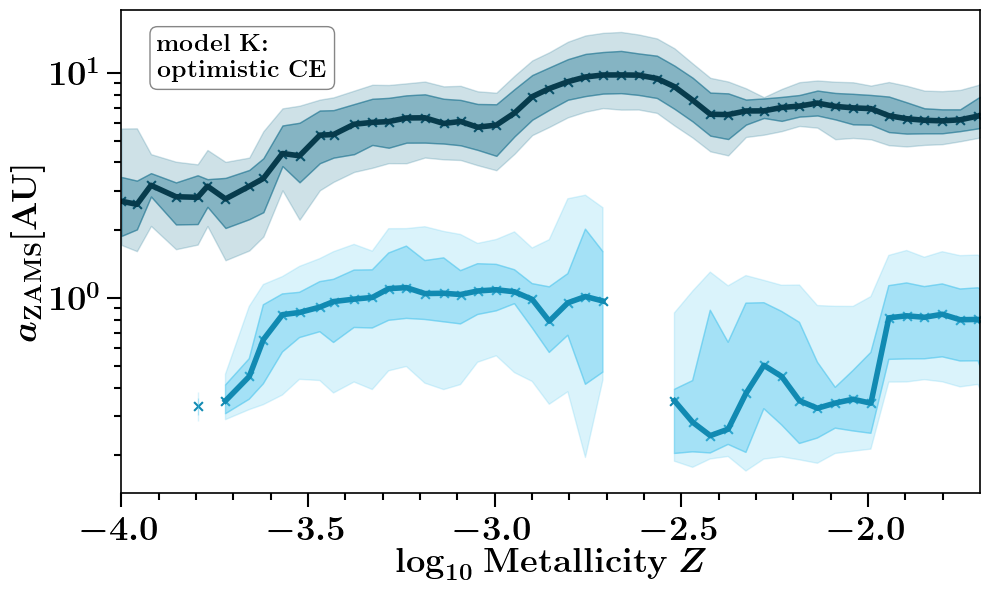


at BPS model  L
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


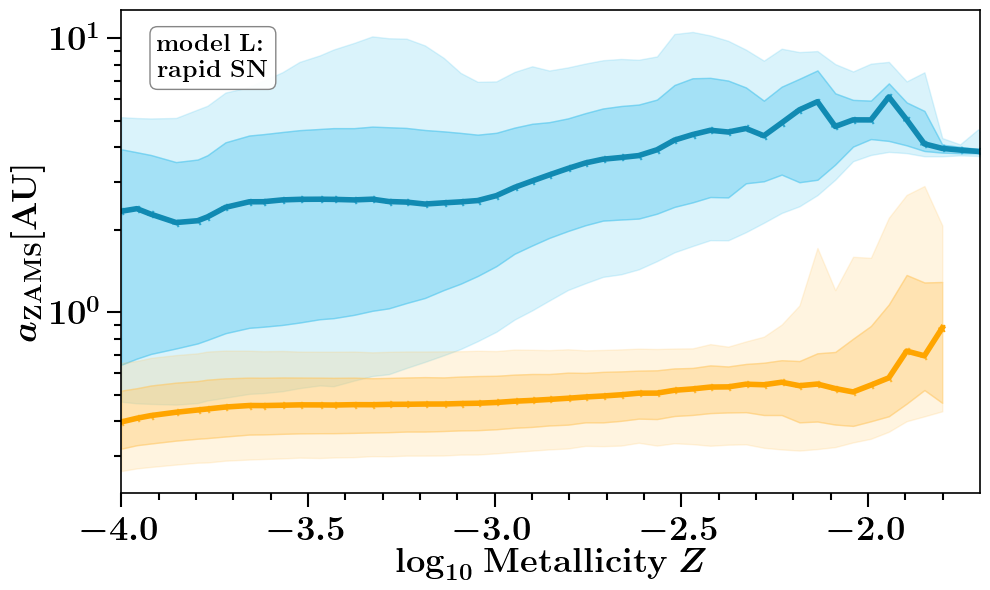


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


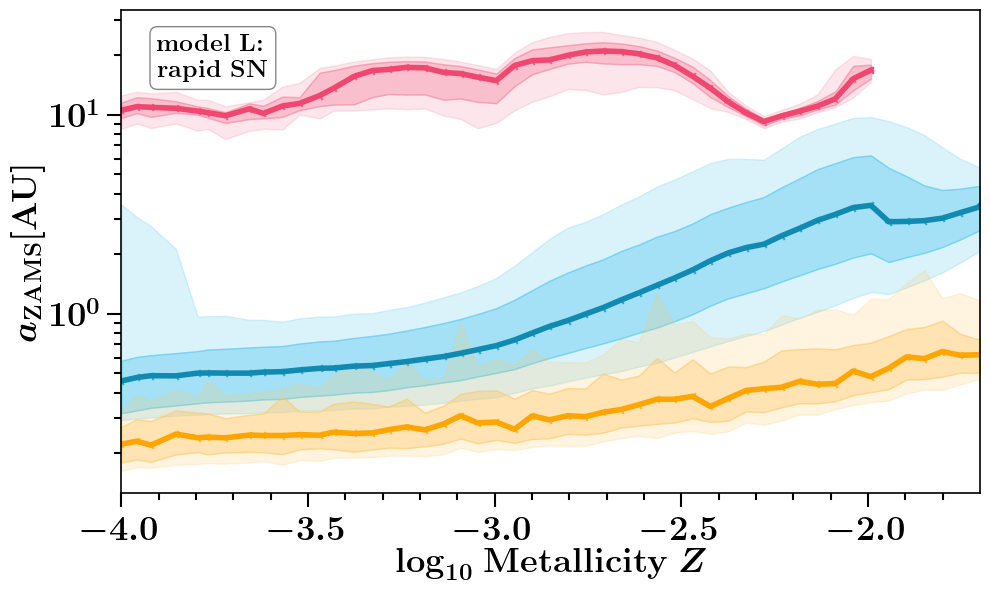


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


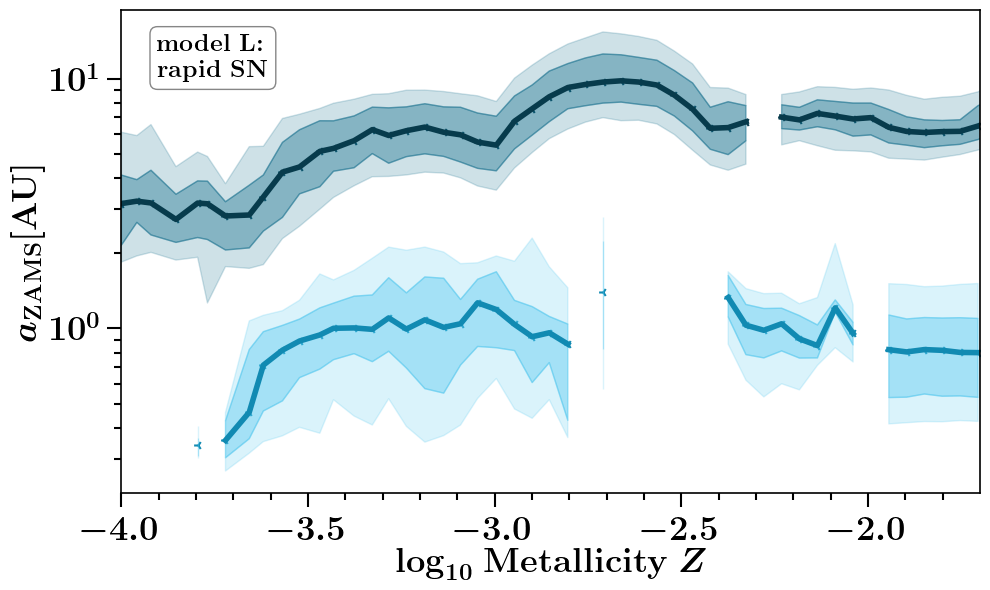


at BPS model  M
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


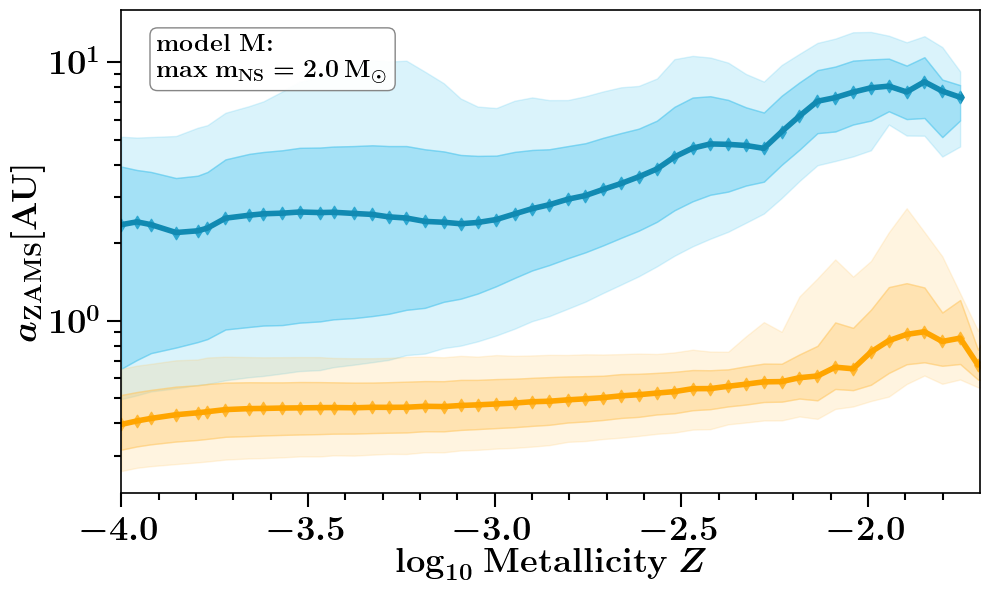


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


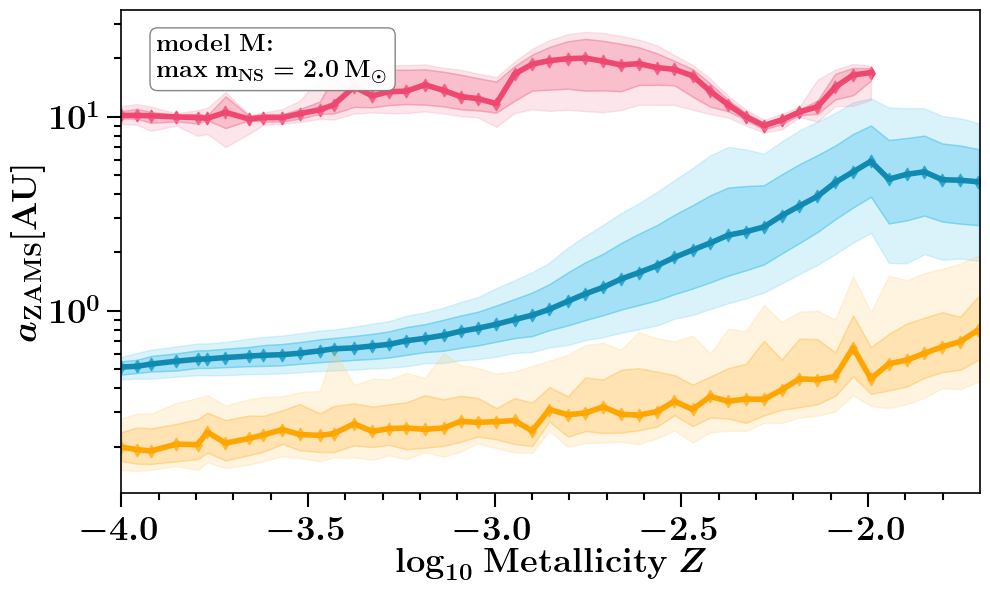


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


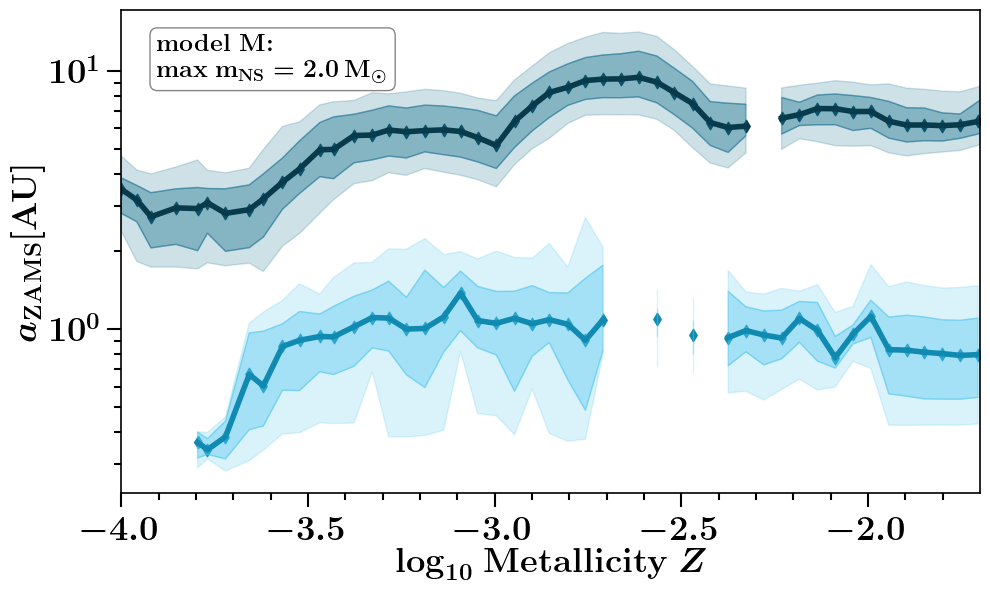


at BPS model  N
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


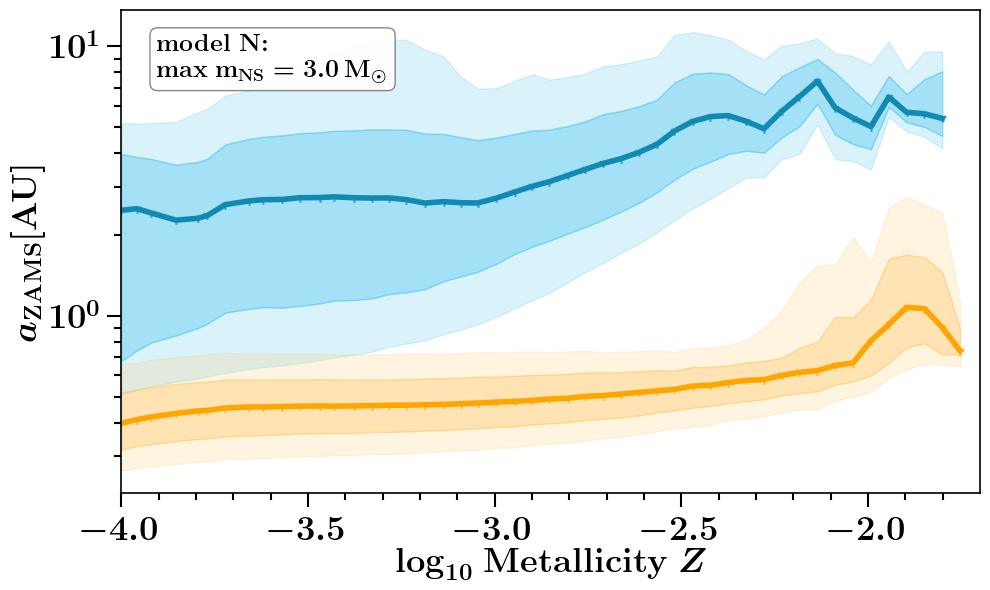


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


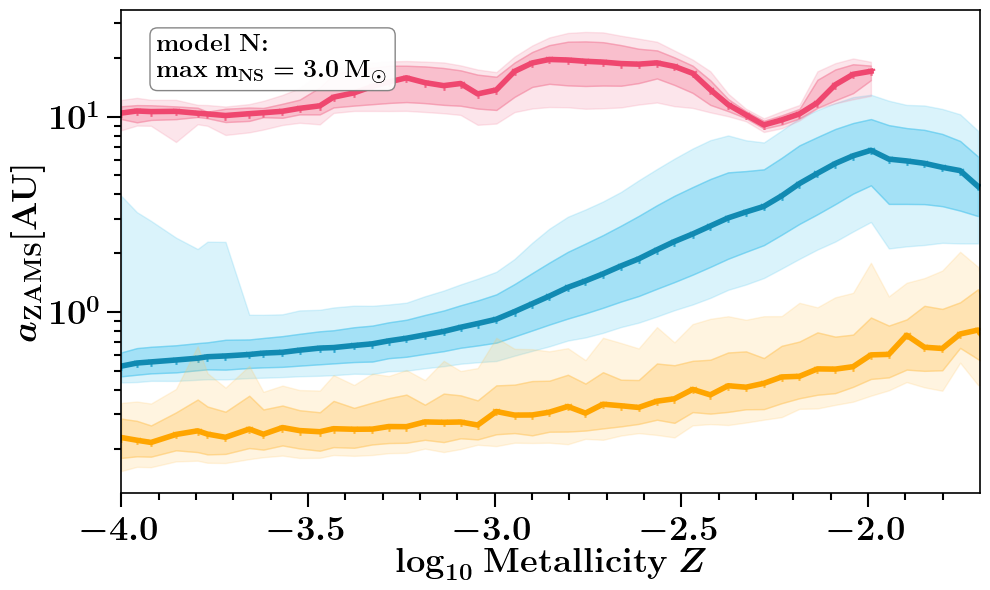


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


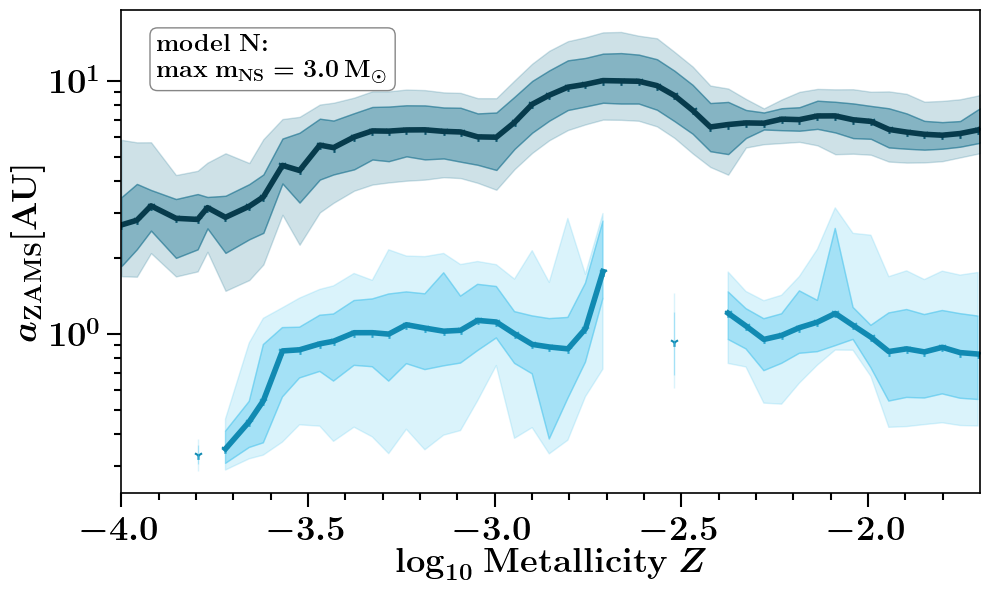


at BPS model  O
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


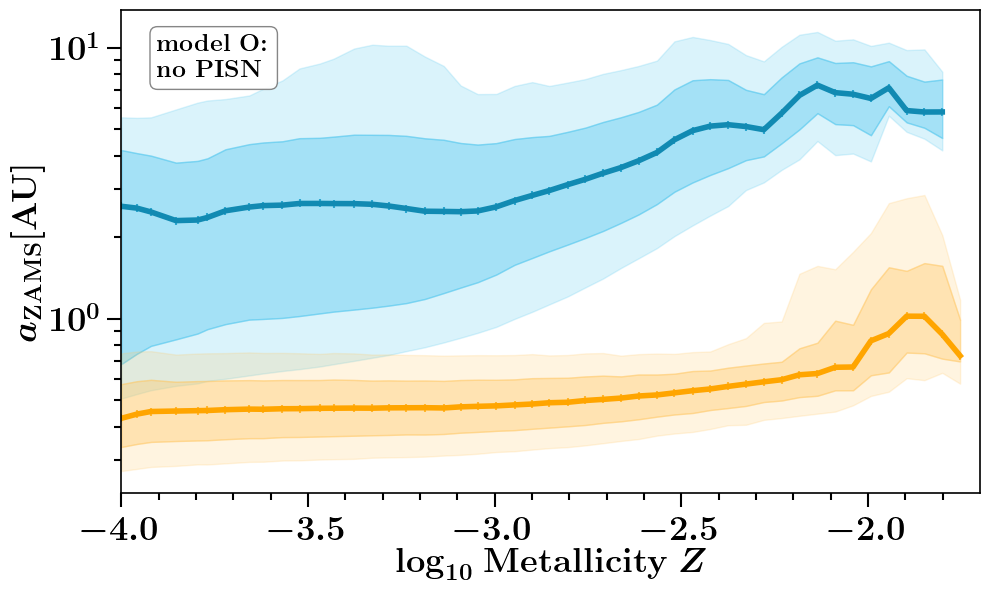


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


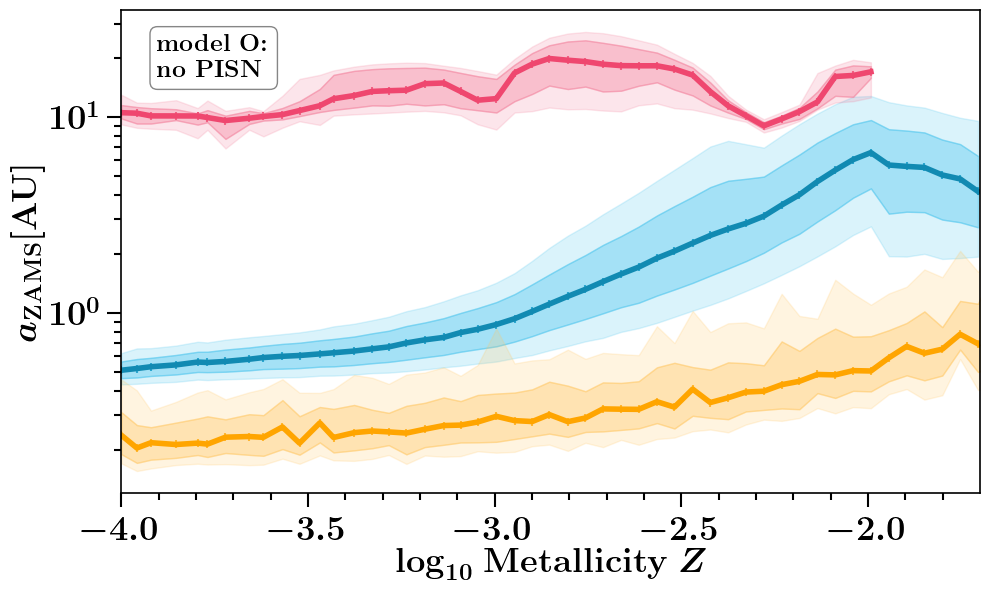


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


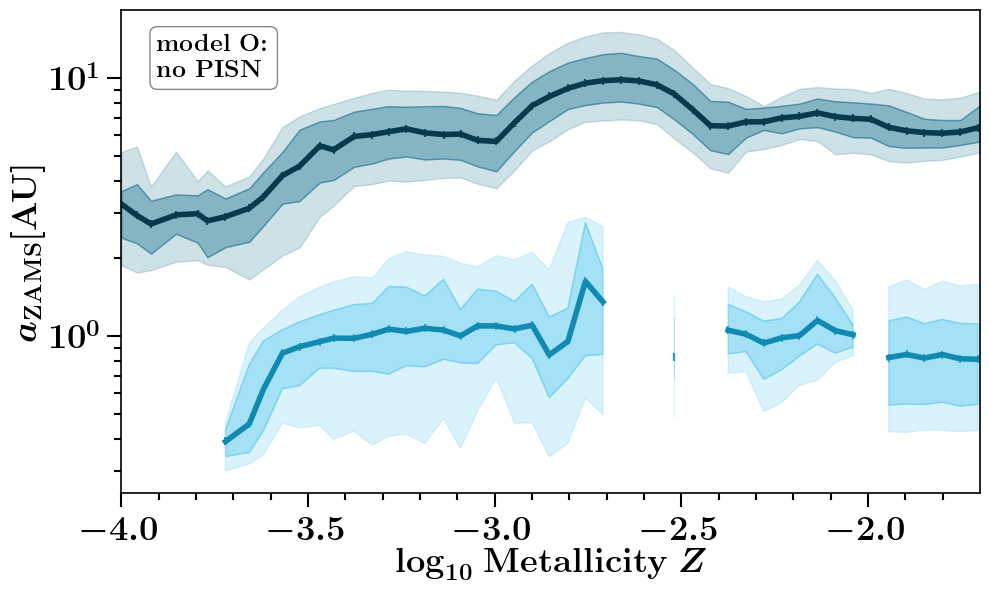


at BPS model  P
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


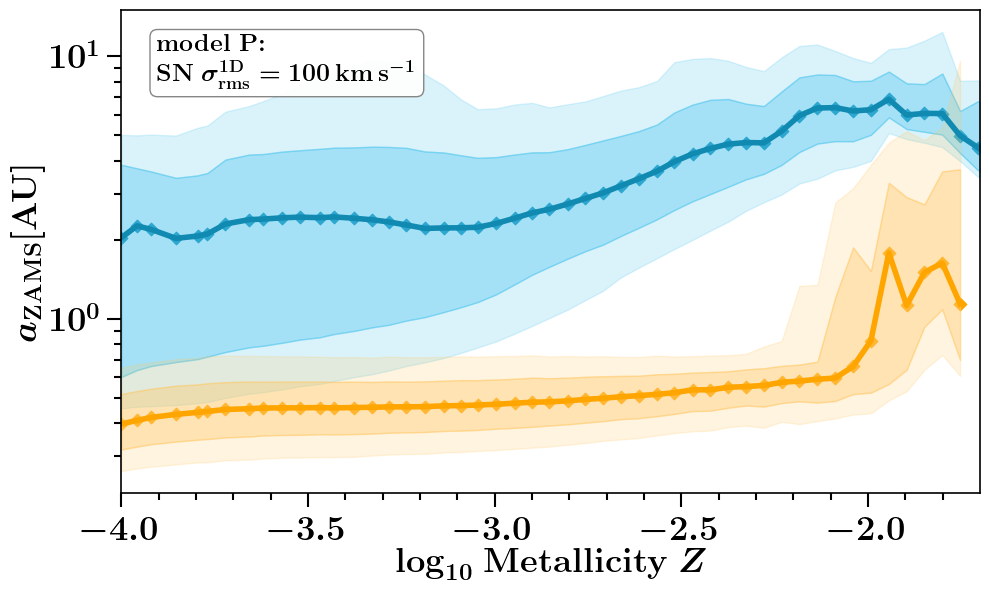


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


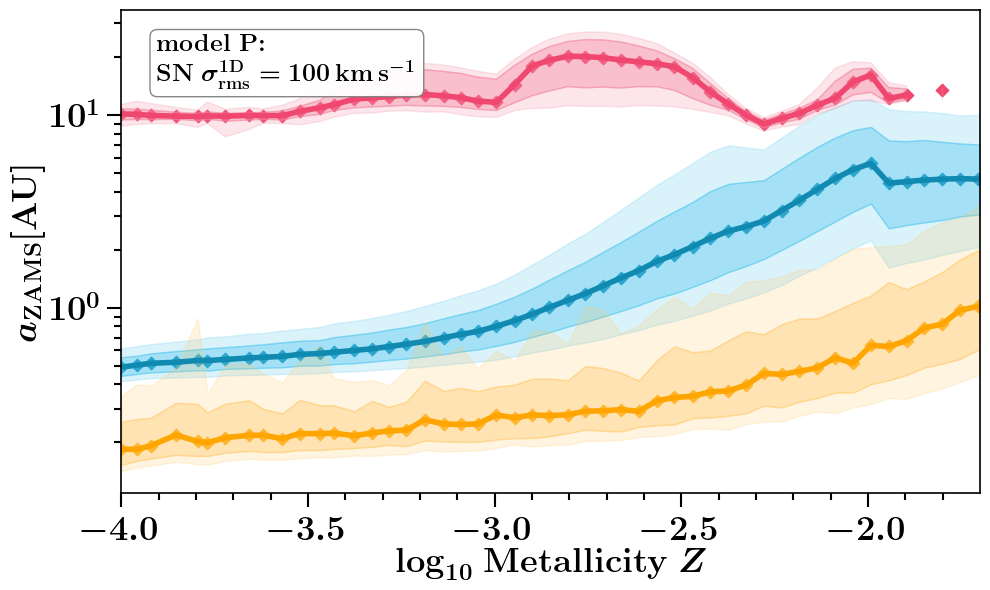


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


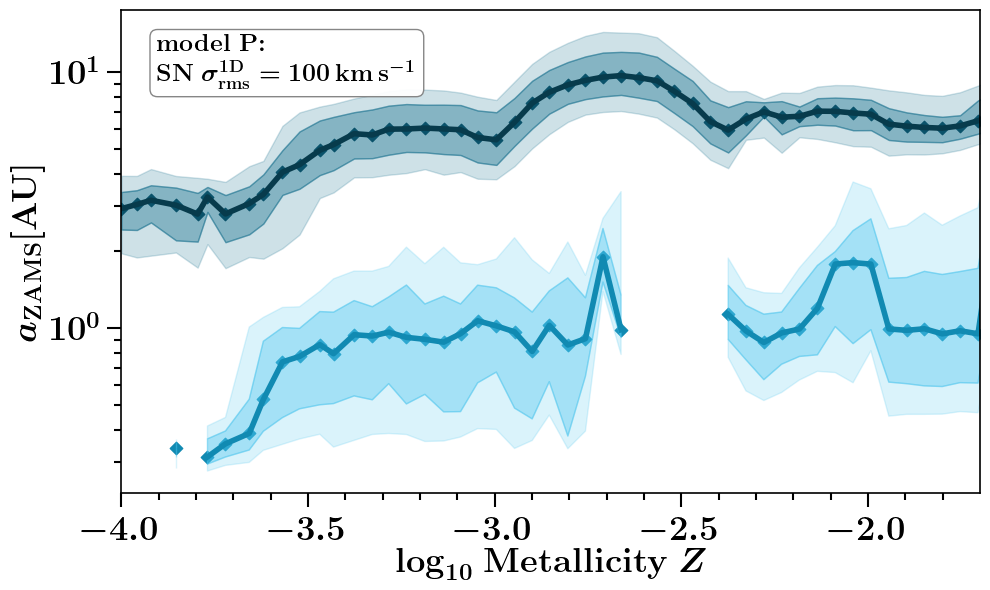


at BPS model  Q
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


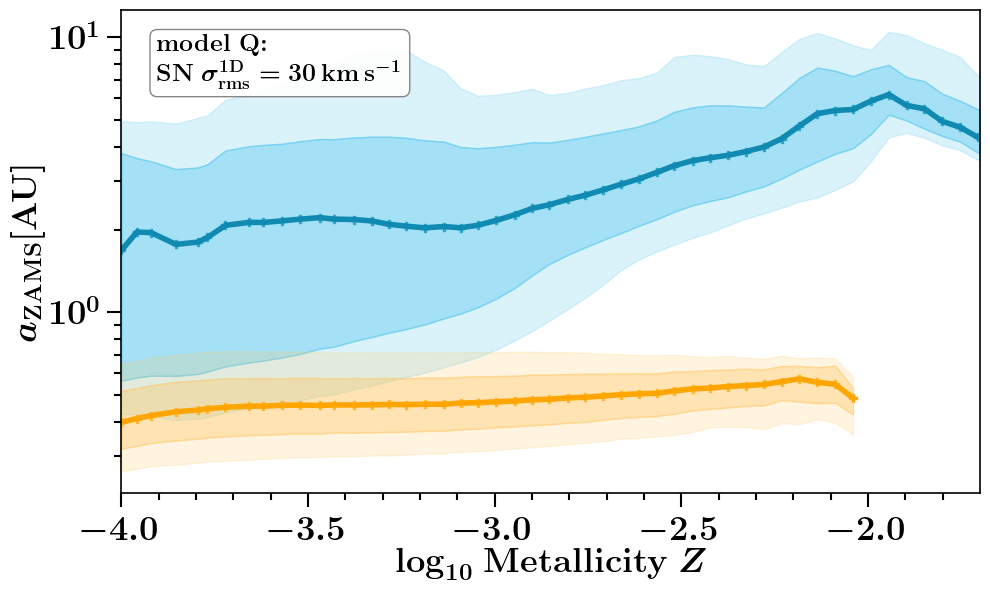


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


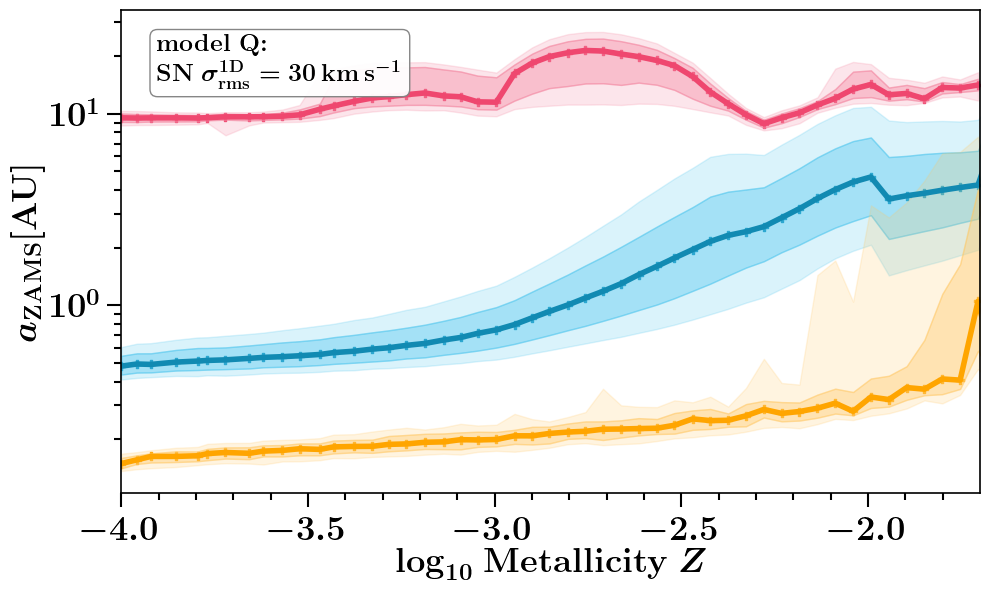


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


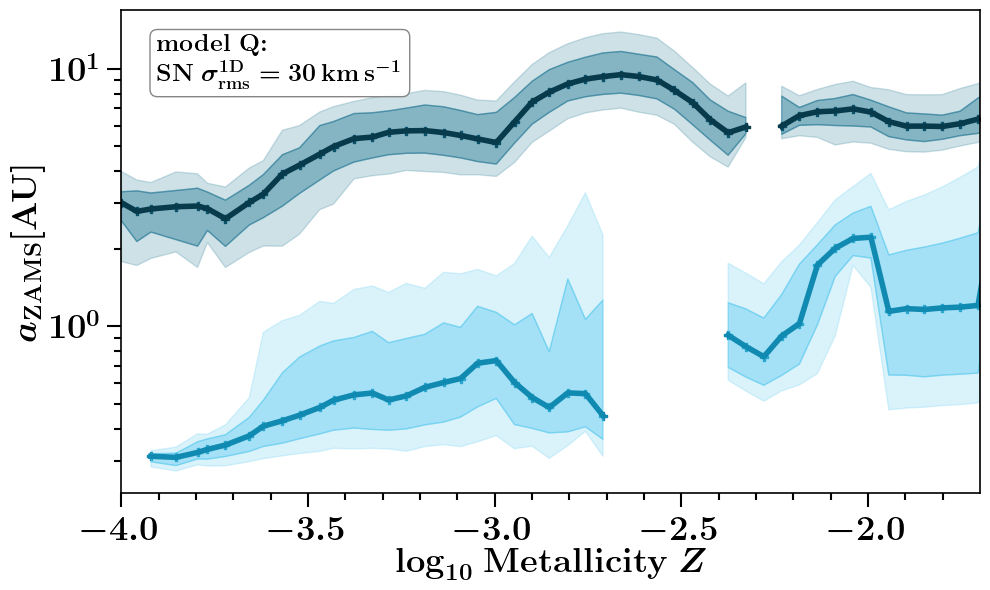


at BPS model  R
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


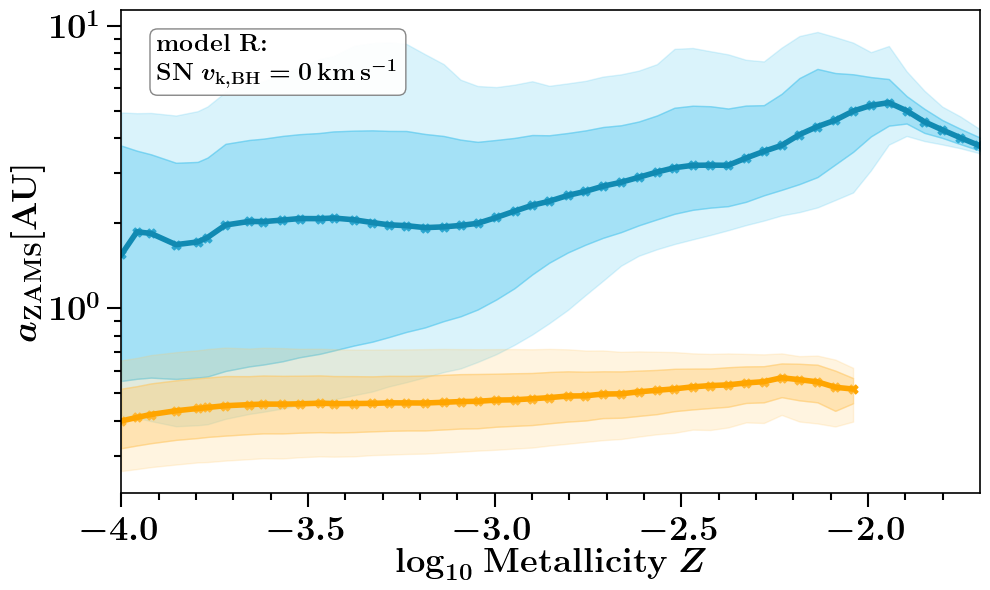


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


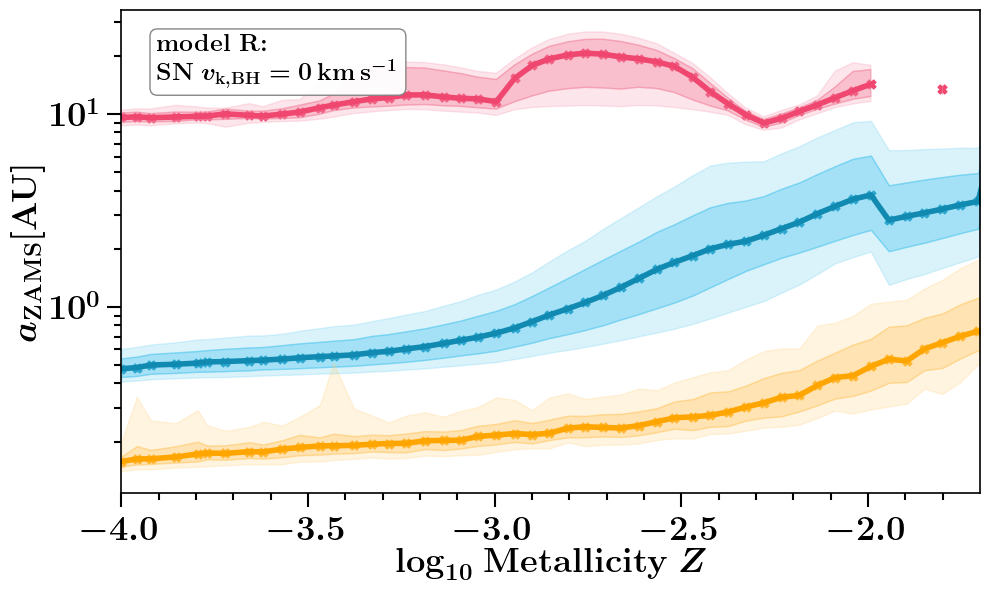


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


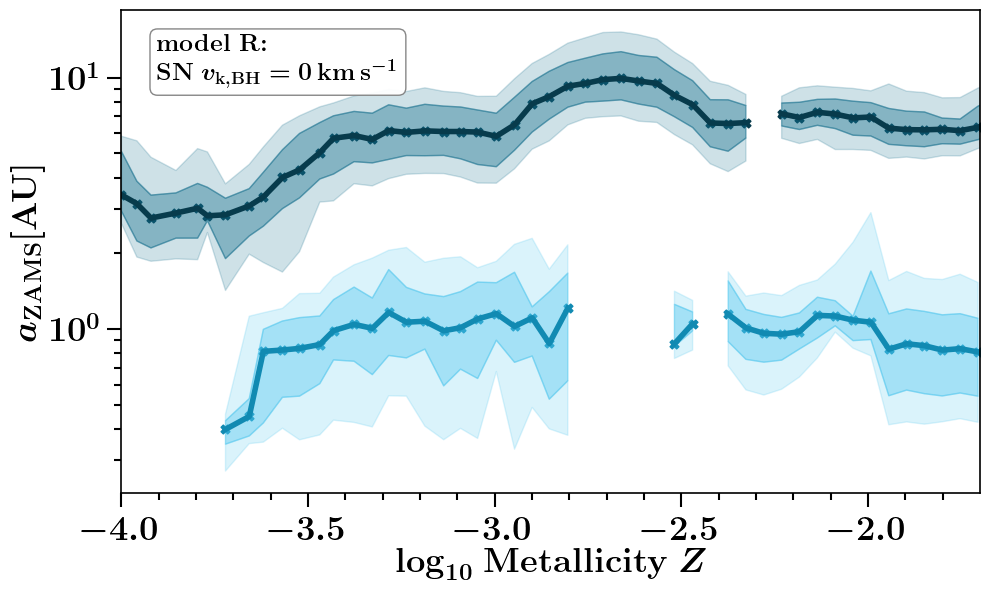


at BPS model  S
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


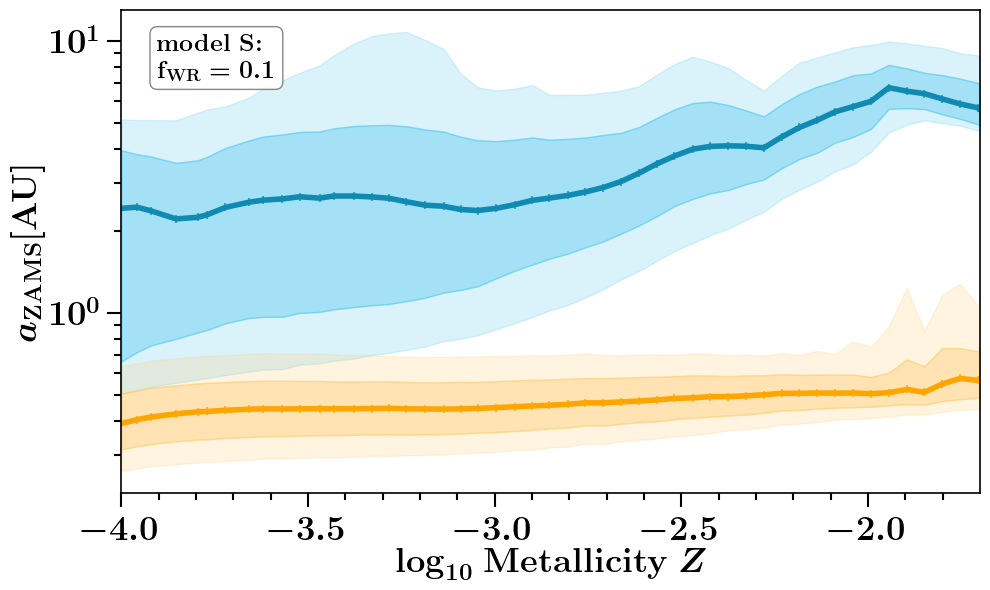


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


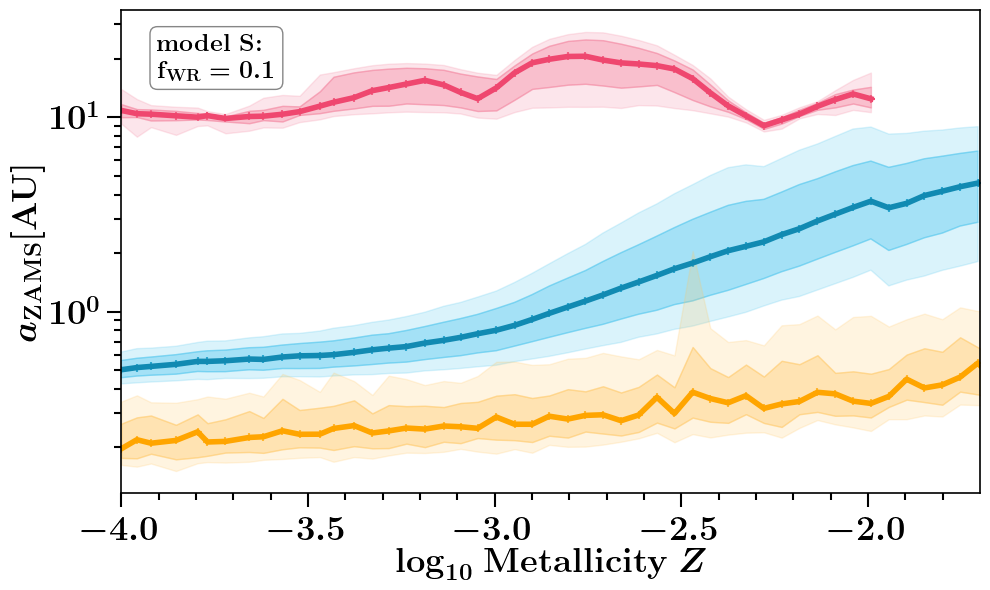


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


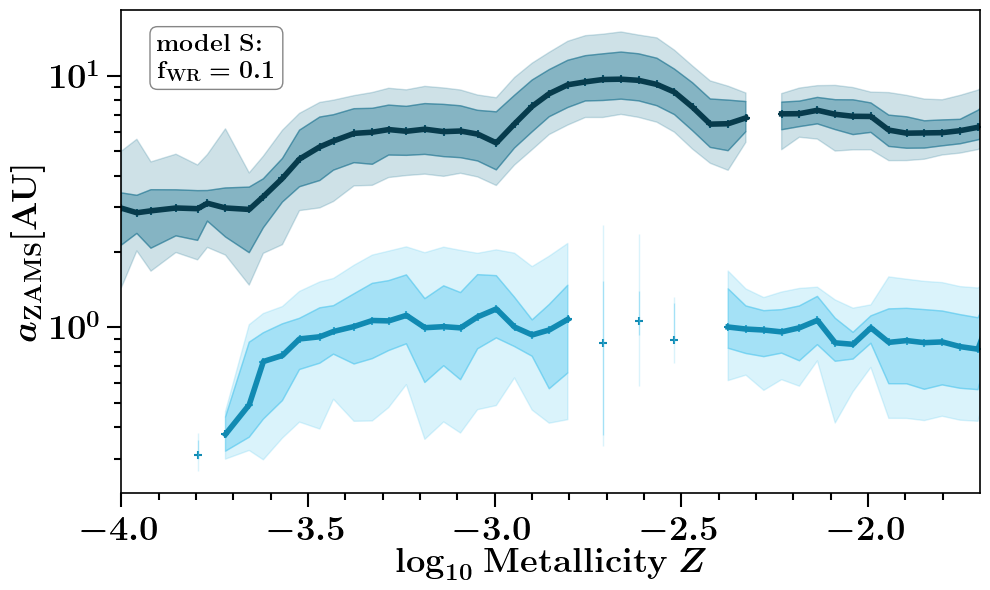


at BPS model  T
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE']
running for channels ['classic', 'stable B no CEE']


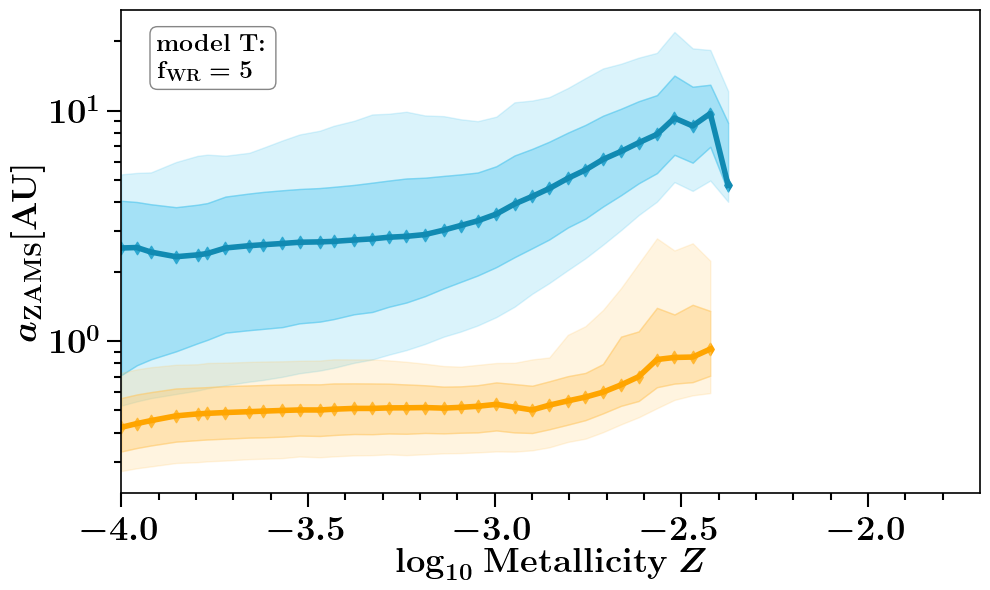


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'immediate CE']
running for channels ['classic', 'stable B no CEE', 'immediate CE']


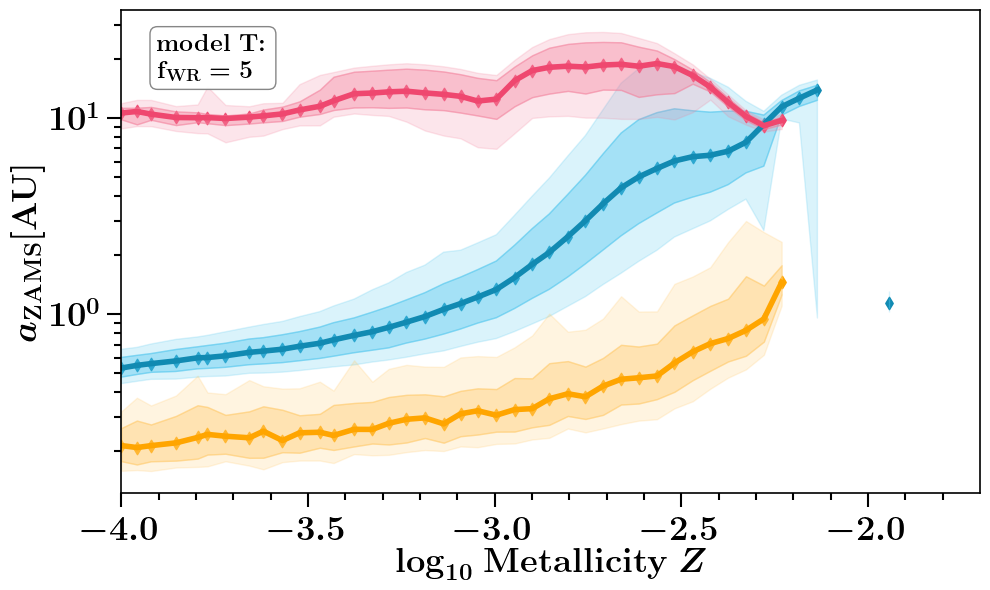


at DCOtype = BNS
running for channels ['classic', 'double-core CE']
running for channels ['classic', 'double-core CE']


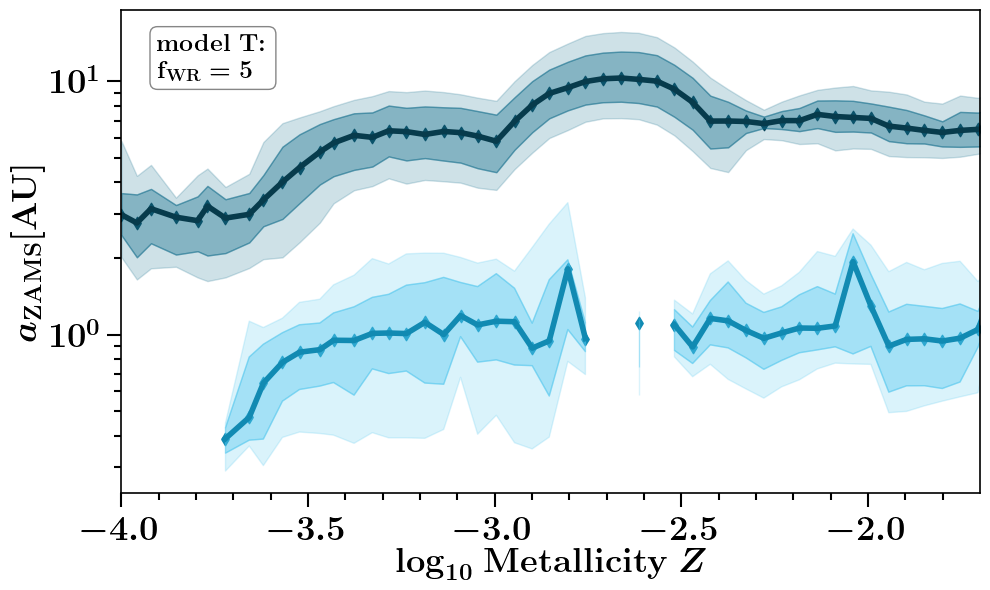

In [32]:



###
quantile_values=[0.5, 0.25, 0.75, 0.1, 0.9 ]
DCOTypeList = ['BBH', 'BHNS', 'BNS']
whichQuantity = 'median'
###


# for xparam_wanted in [ 'mass_tot', 't_delay', 'mass_ratio_LVK', 'mass_1_LVK', 'mass_2_LVK','chirp_mass_LVK',]:
for xparam_wanted in [ 'qZAMS', 'separationInitial']: #, 'M1ZAMS', 'M2ZAMS']:
    print('at xparam ', xparam_wanted)
    for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
        print('at BPS model ', BPSmodelName)
        BPS_models_to_run_list=[BPSmodelName]
    #     BPS_models_to_run_list = BPSnameslist
        for DCOtype in DCOTypeList: #'BNS', 'BHNS', 
            print('at DCOtype =', DCOtype)


            ncols, nrows= 1,1
            f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,6), 
                          gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



            ax = plot_formation_channels_metallicity_from_xparam_for_quantiles(axe=ax, DCOtype=DCOtype, BPS_models_to_run_list=BPS_models_to_run_list,\
                                                                  pathData=pathData,mask_specific_mssfr=None, whichQuantity=whichQuantity, value_for_fraction=False, \
                                                                               add_model_label=True, quantile_values=quantile_values, xparam=xparam_wanted) 





            ##  SAVE FIG  ###
            plt.tight_layout()
            plt.subplots_adjust(wspace=0., hspace=0.18)  
            plt.savefig('./formation_median/'+ xparam + '/MetallicityQuantile_' +  DCOtype + '_' + BPSmodelName + '_' + xparam + '.png', transparent=False, dpi=300)
#             plt.savefig('./formation_median/'+ xparam + '/MetallicityQuantile_' +  DCOtype + '_' + BPSmodelName + '_' + xparam + '.pdf', transparent=True)
            plt.show()
            plt.close()
            print()



at xparam  mass_tot
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no

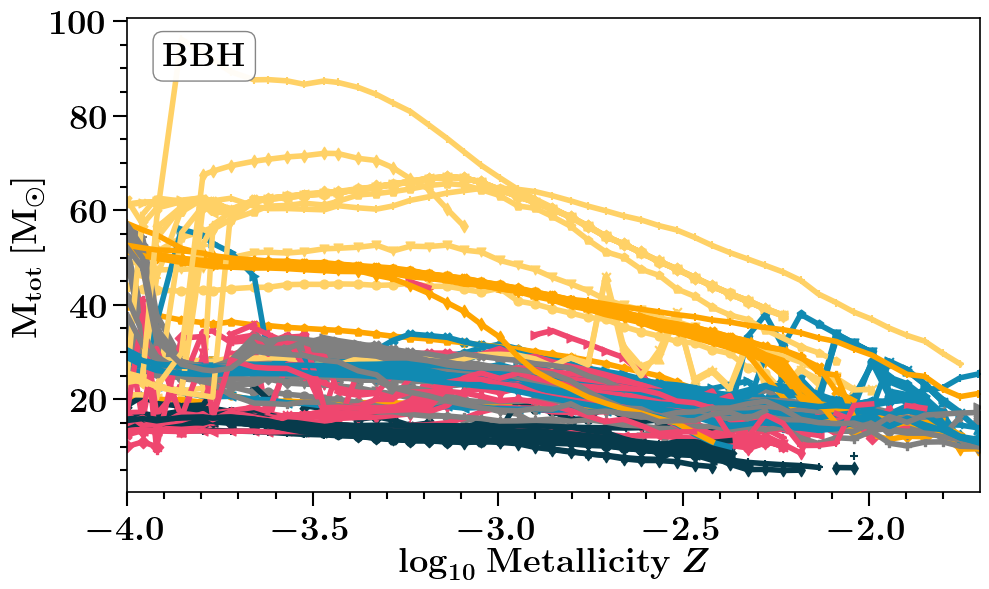


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

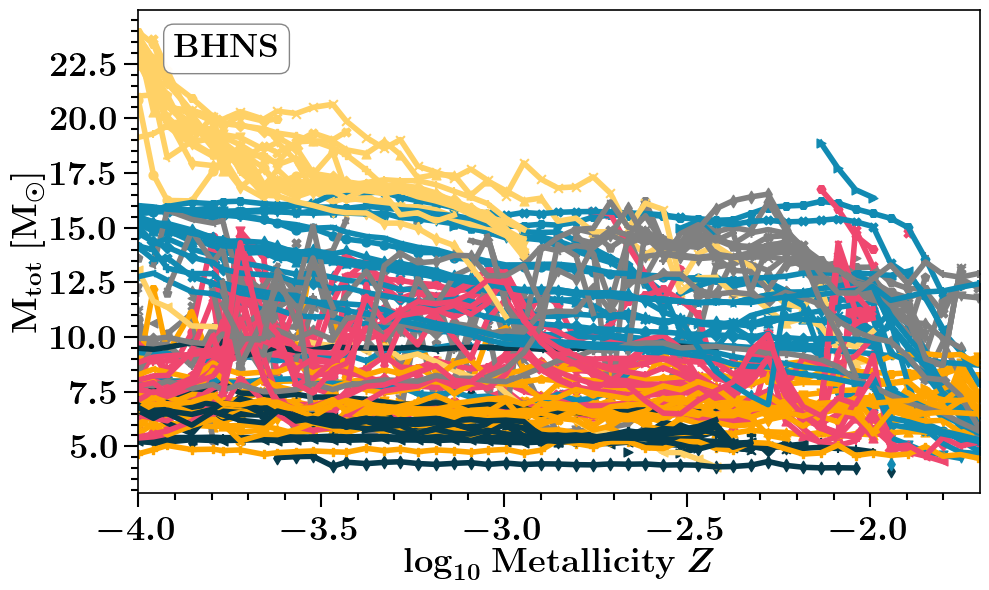


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

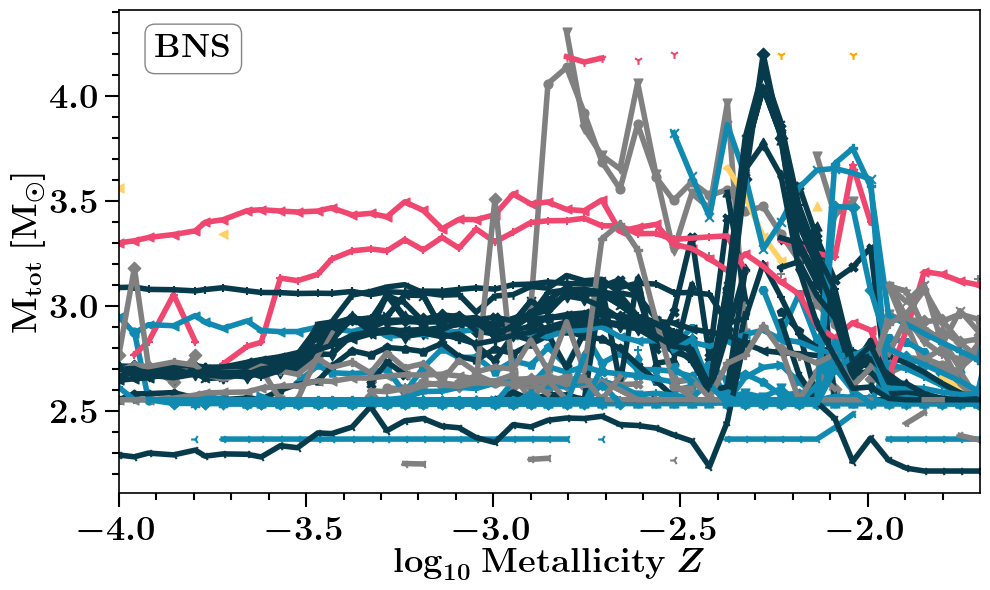


at xparam  t_delay
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no

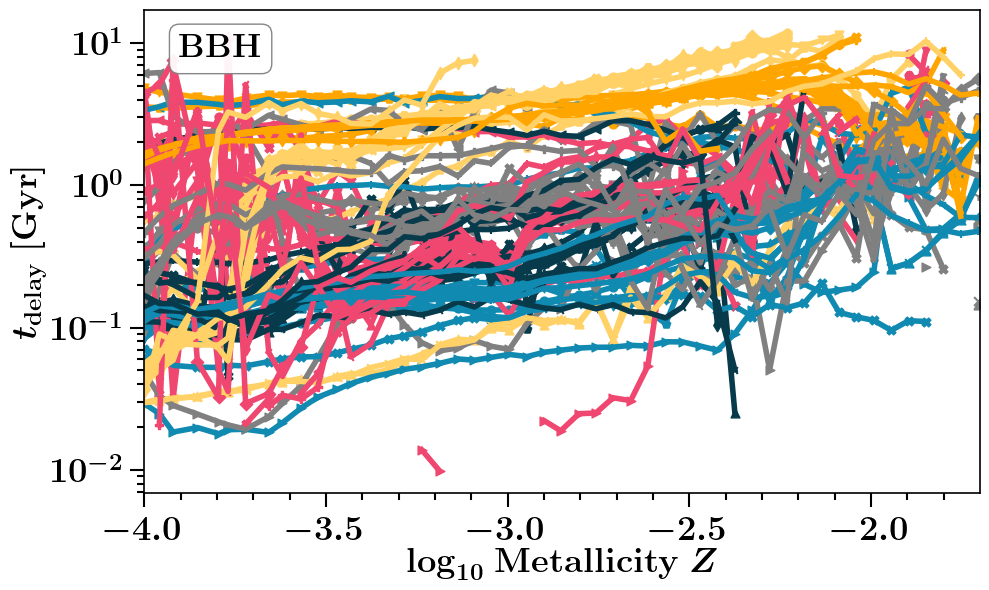


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

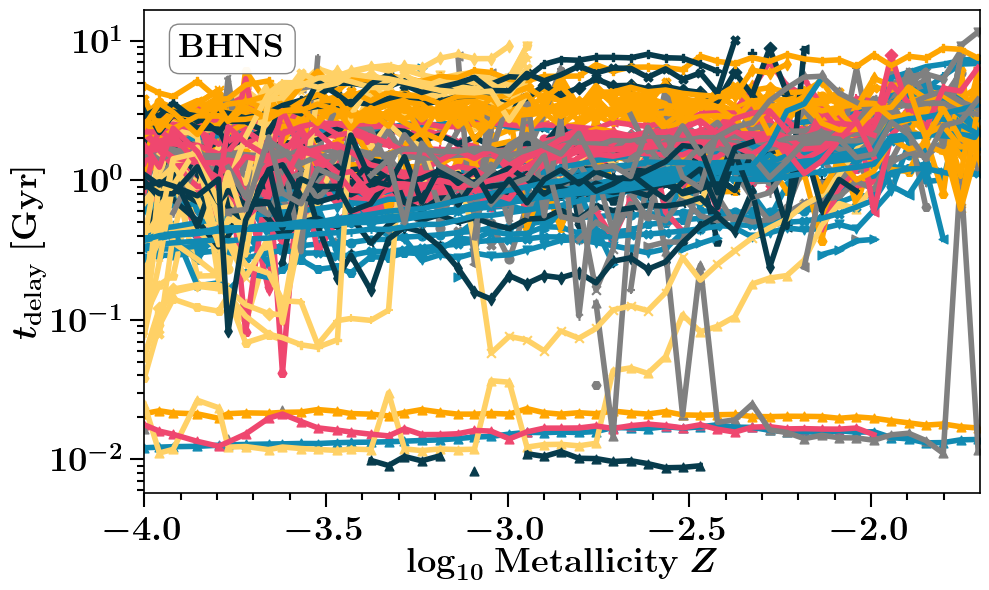


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

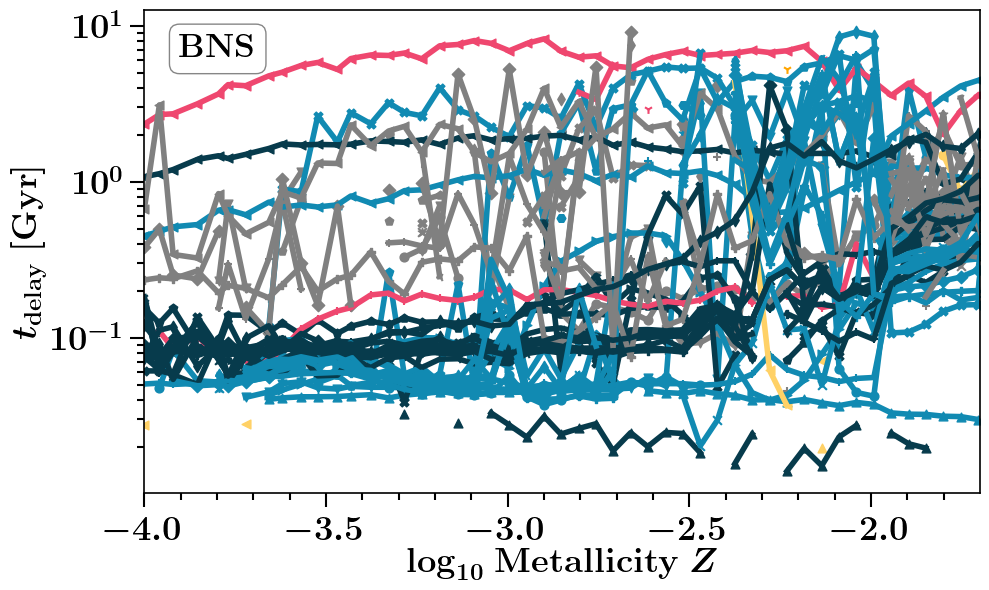


at xparam  mass_ratio_LVK
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stab

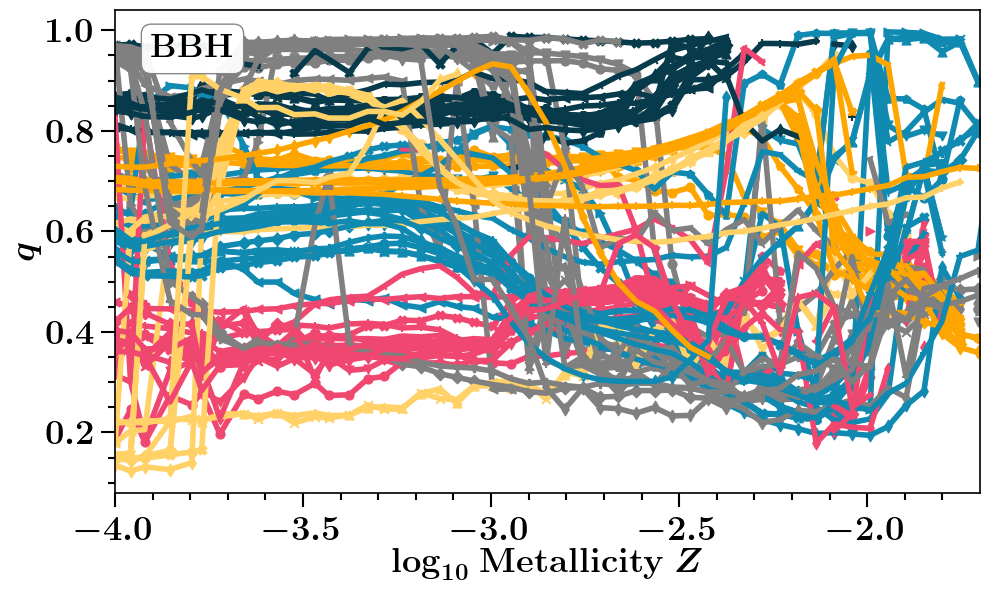


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

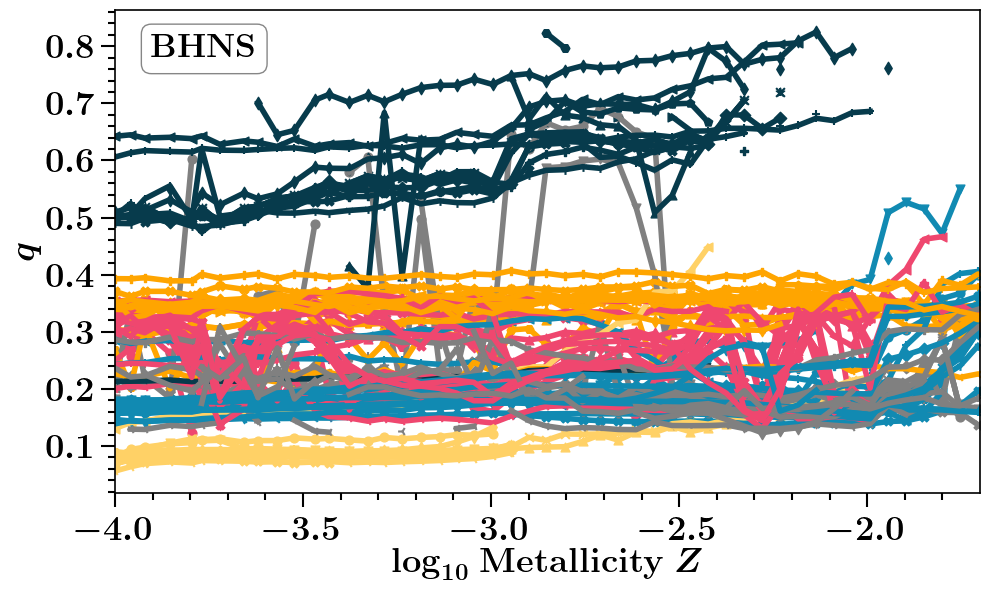


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

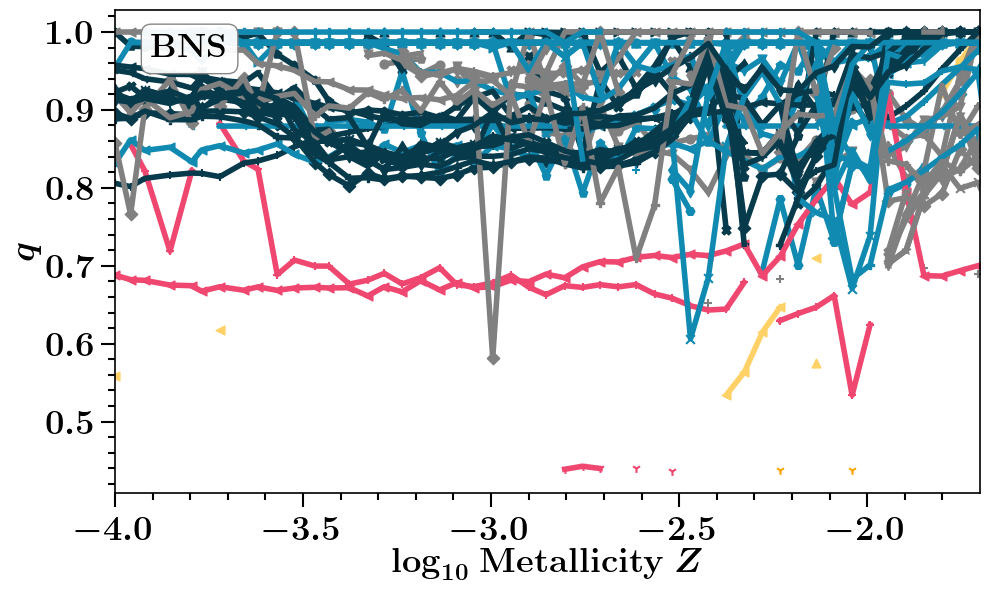


at xparam  mass_1_LVK
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B

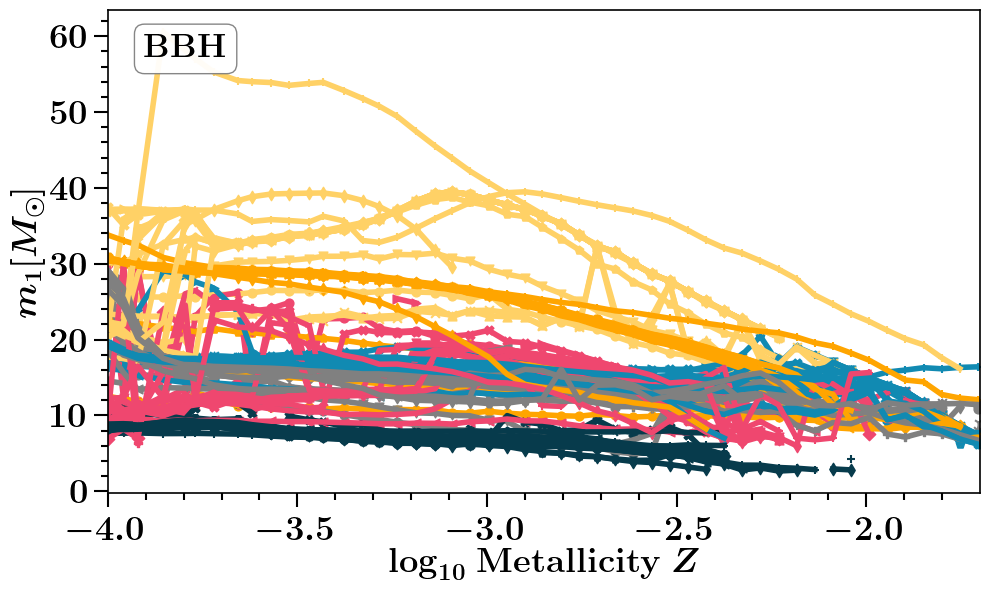


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

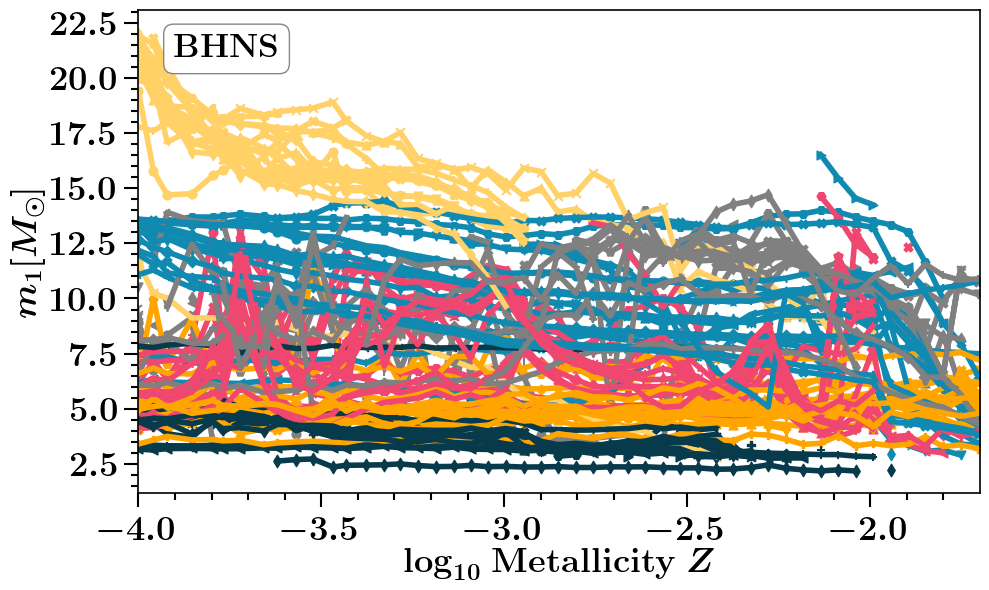


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

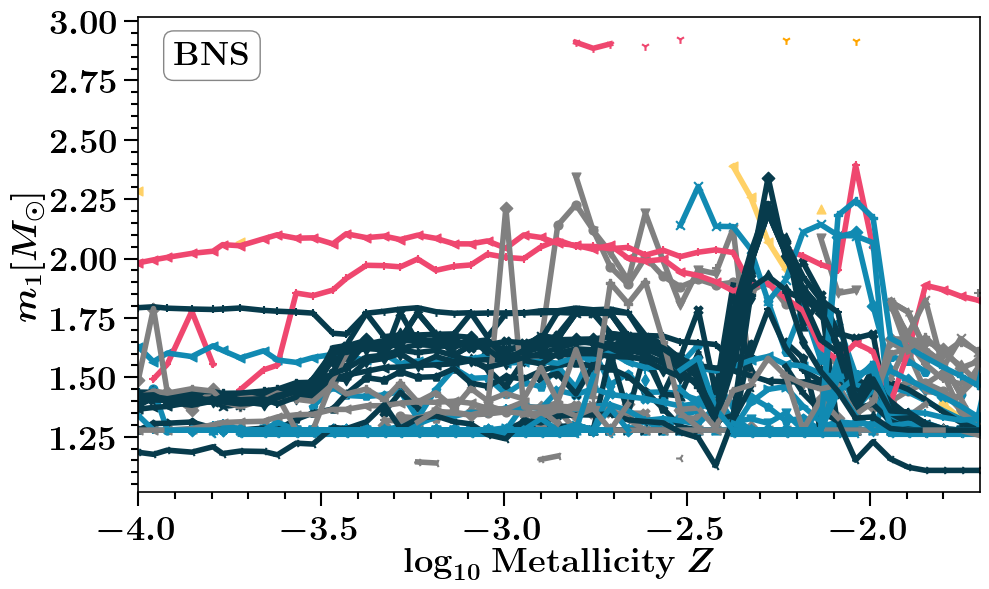


at xparam  mass_2_LVK
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B

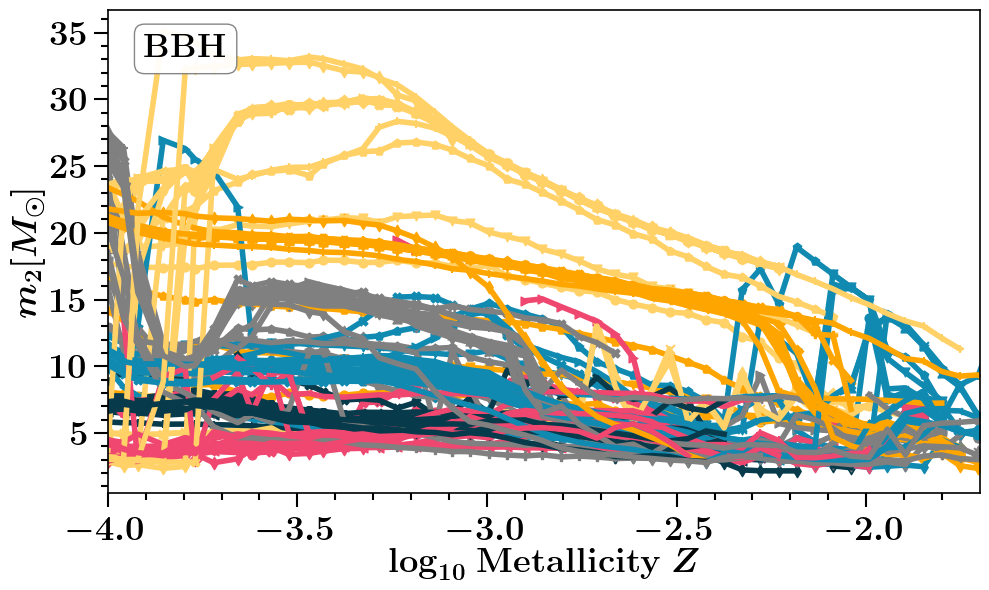


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

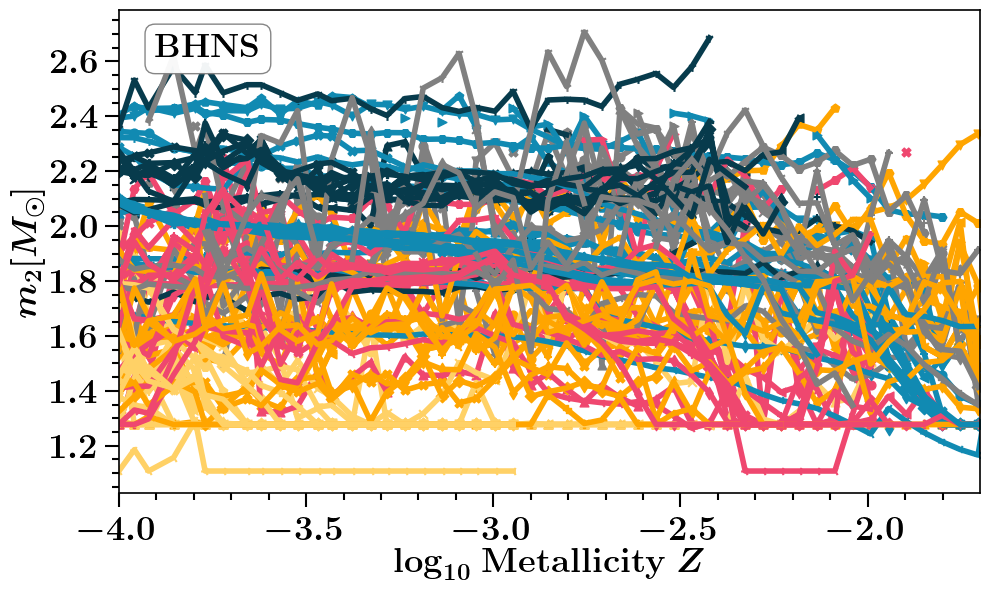


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

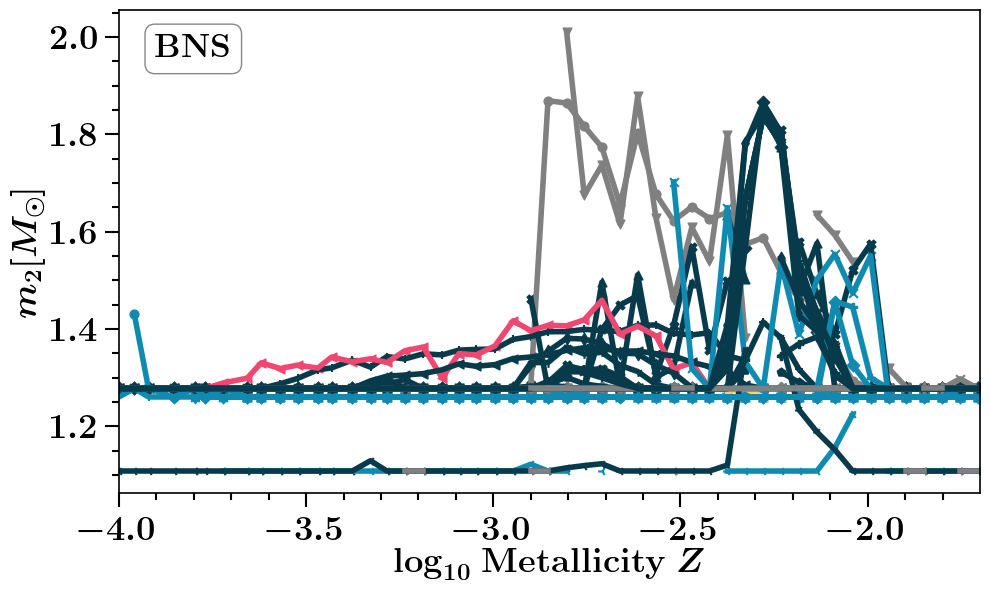


at xparam  chirp_mass_LVK
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stab

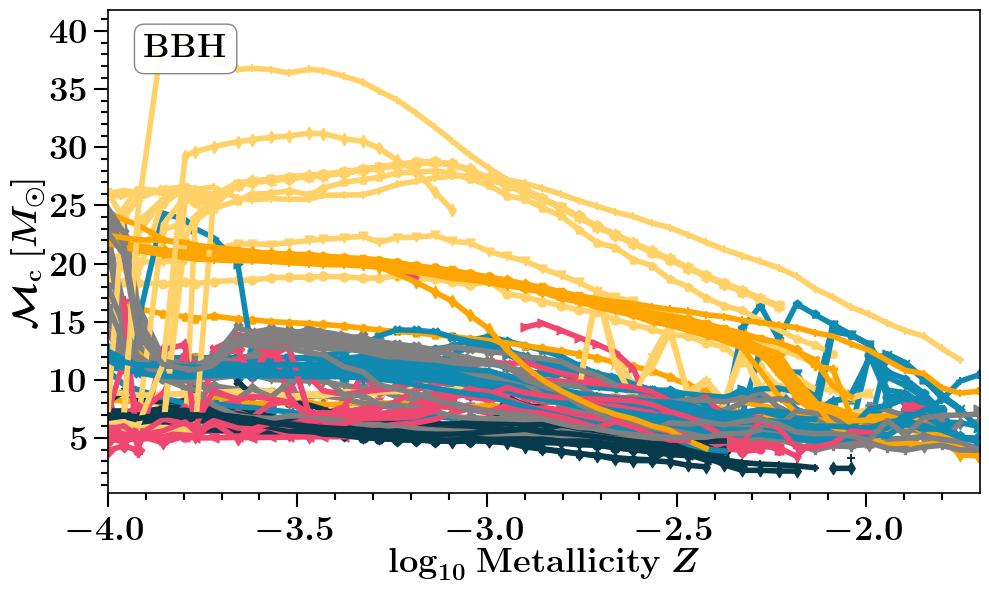


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

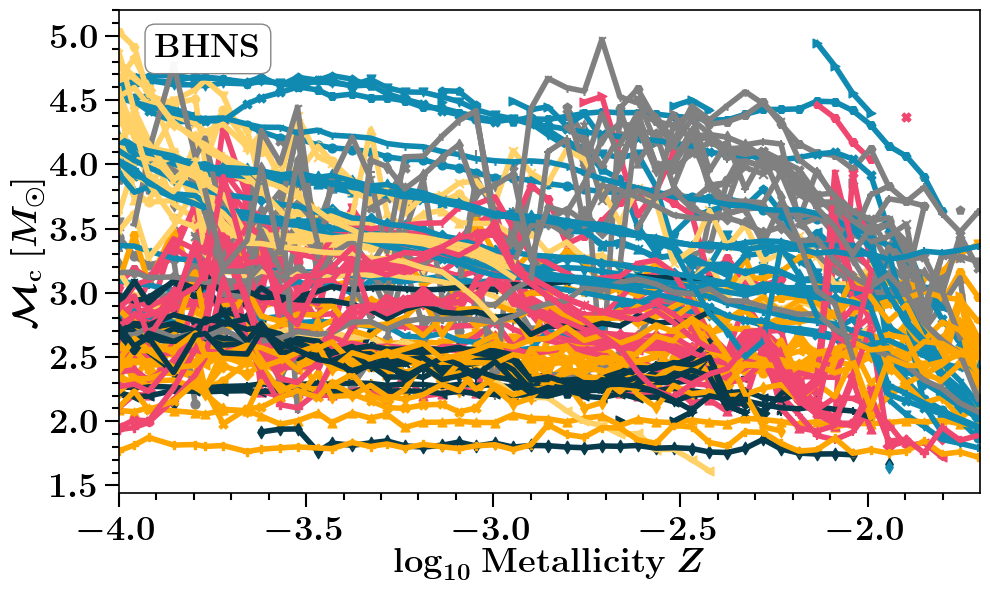


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

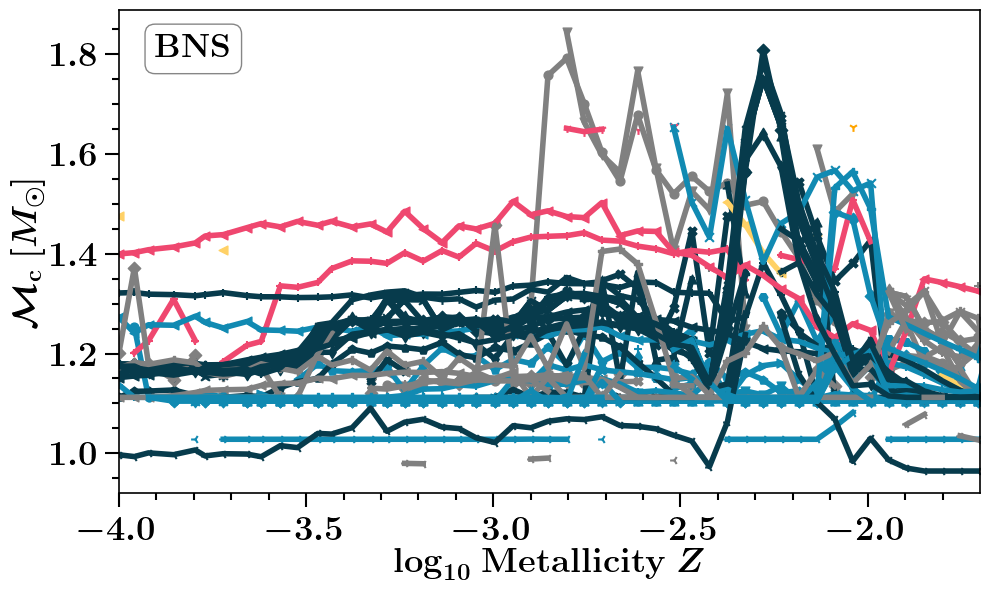


at xparam  qZAMS
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no C

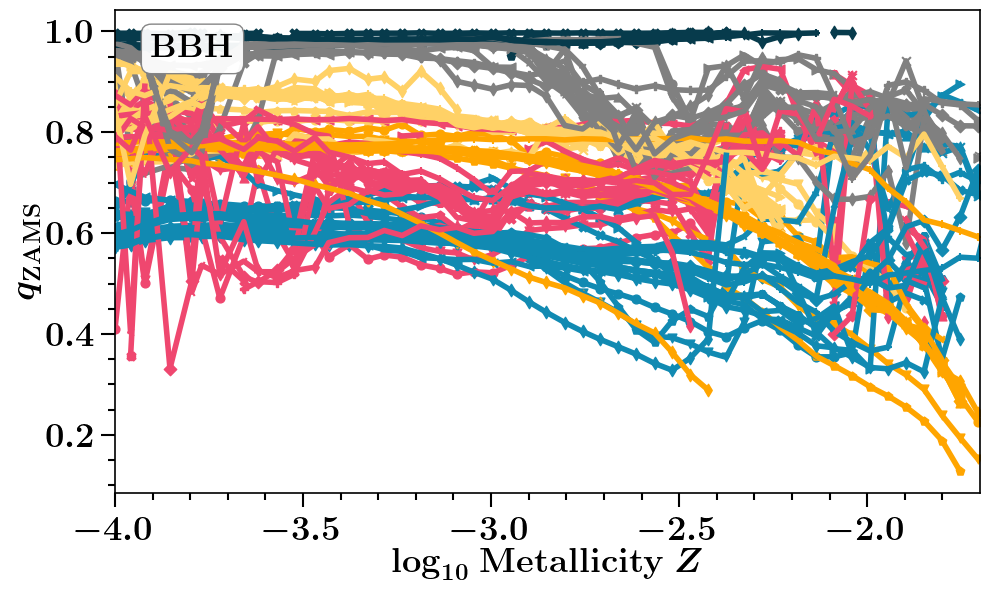


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

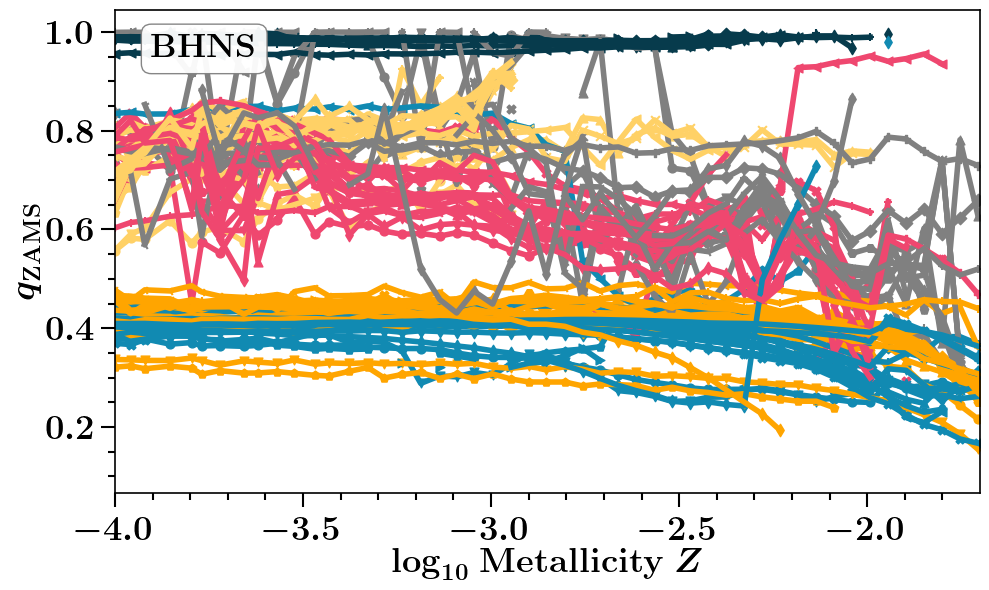


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

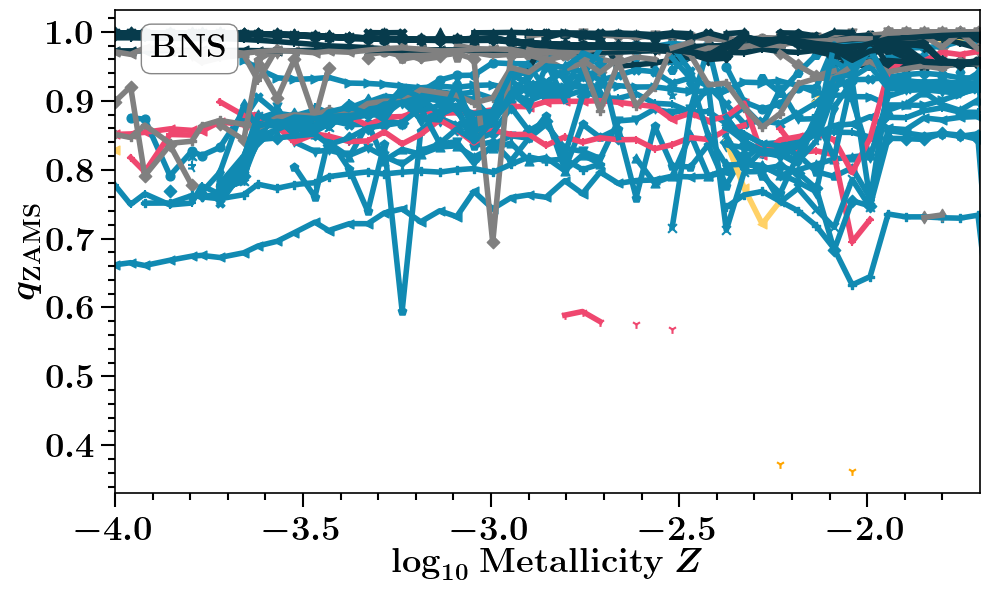


at xparam  separationInitial
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 's

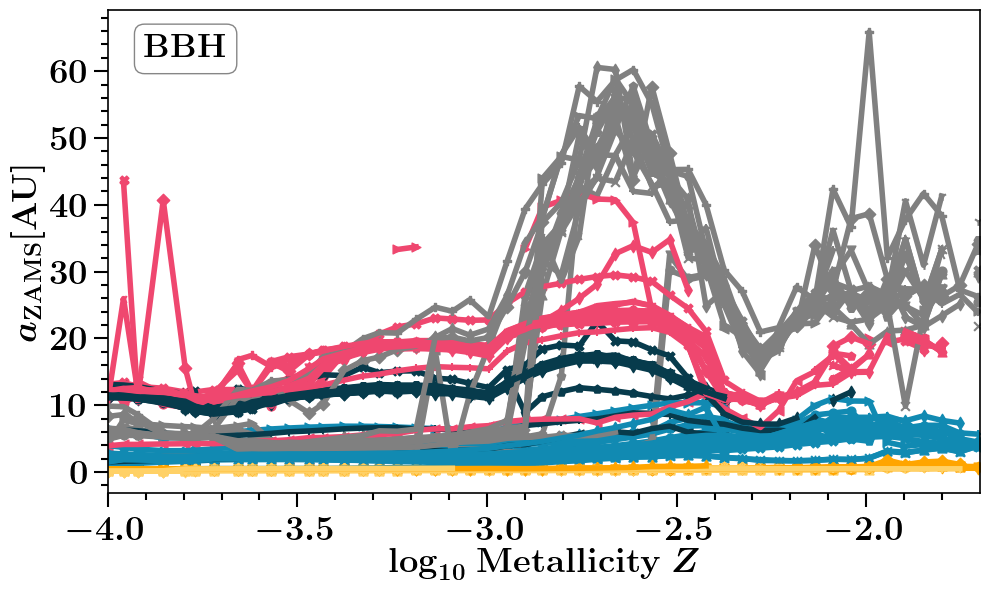


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

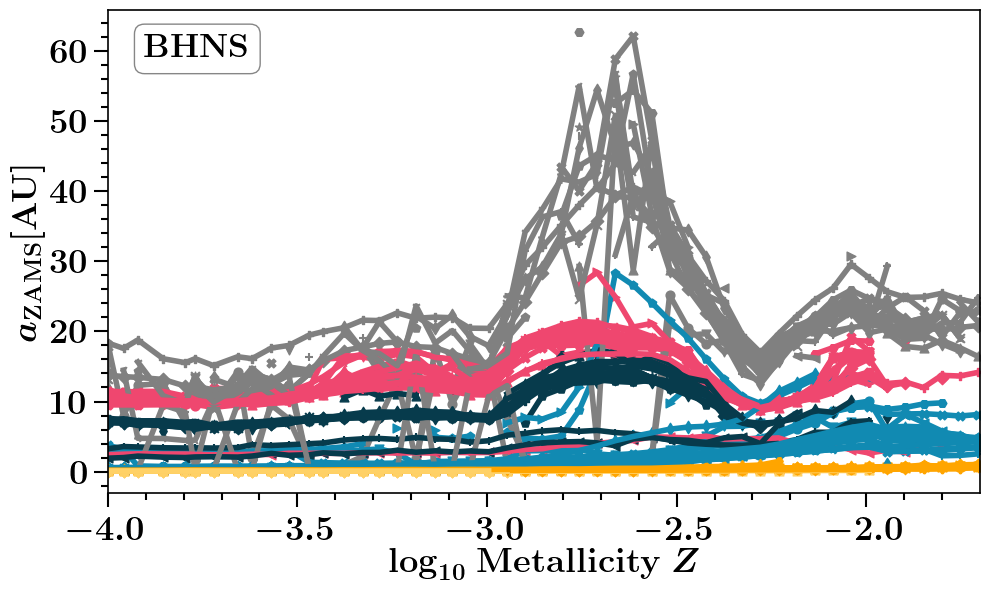


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

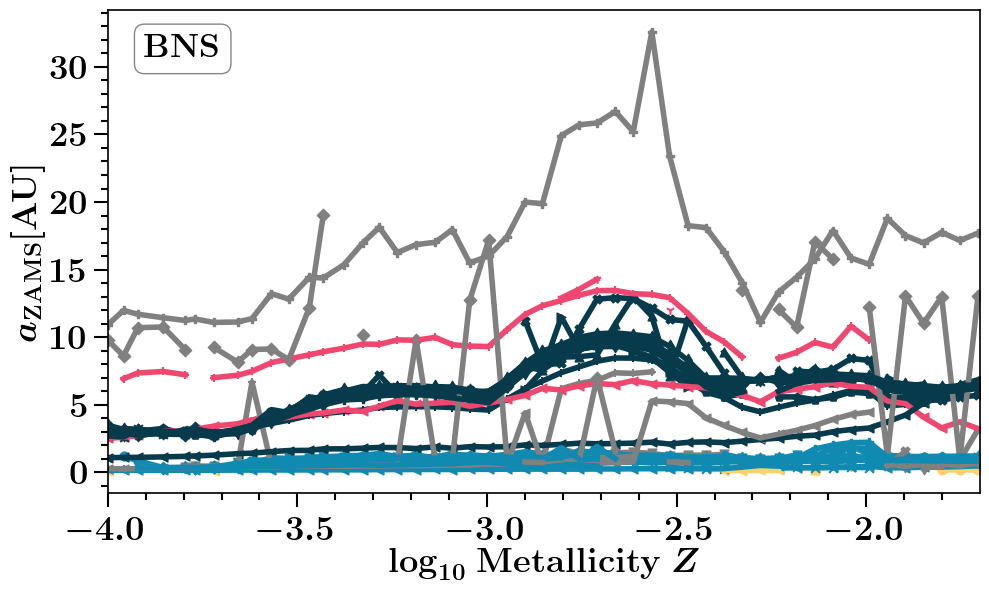


at xparam  M1ZAMS
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no 

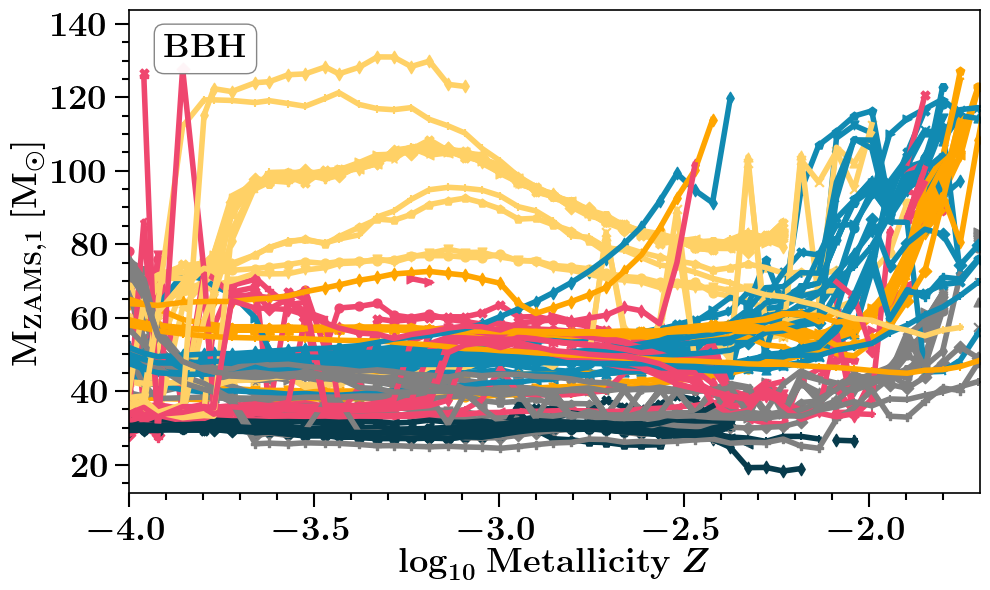


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

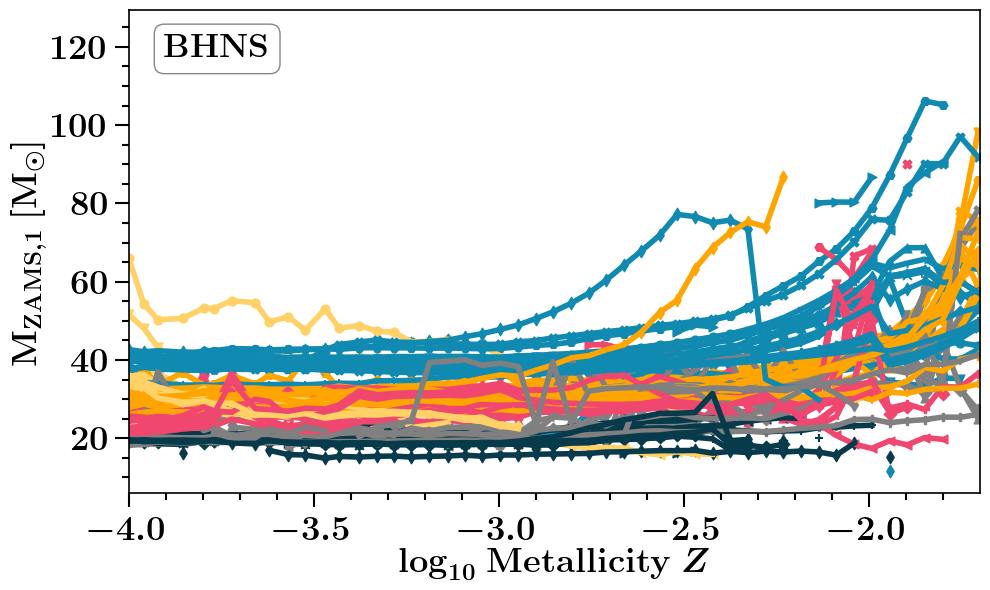


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

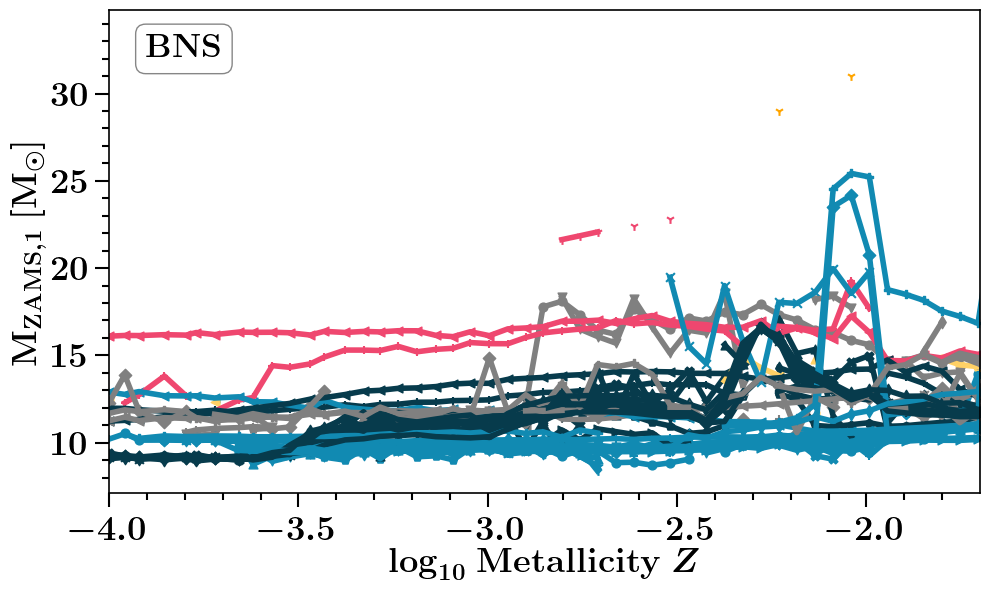


at xparam  M2ZAMS
at DCOtype = BBH
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no 

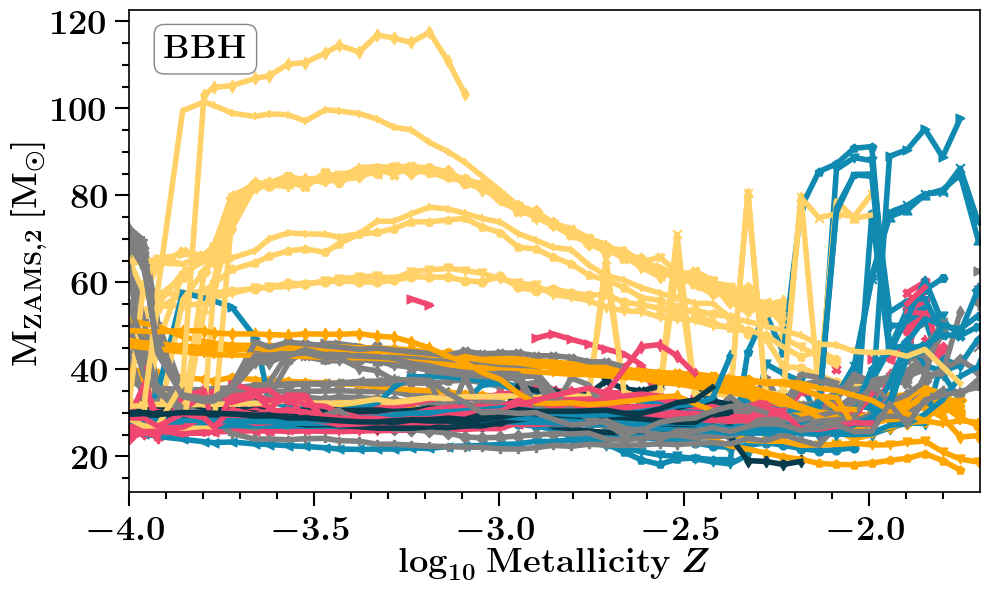


at DCOtype = BHNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imm

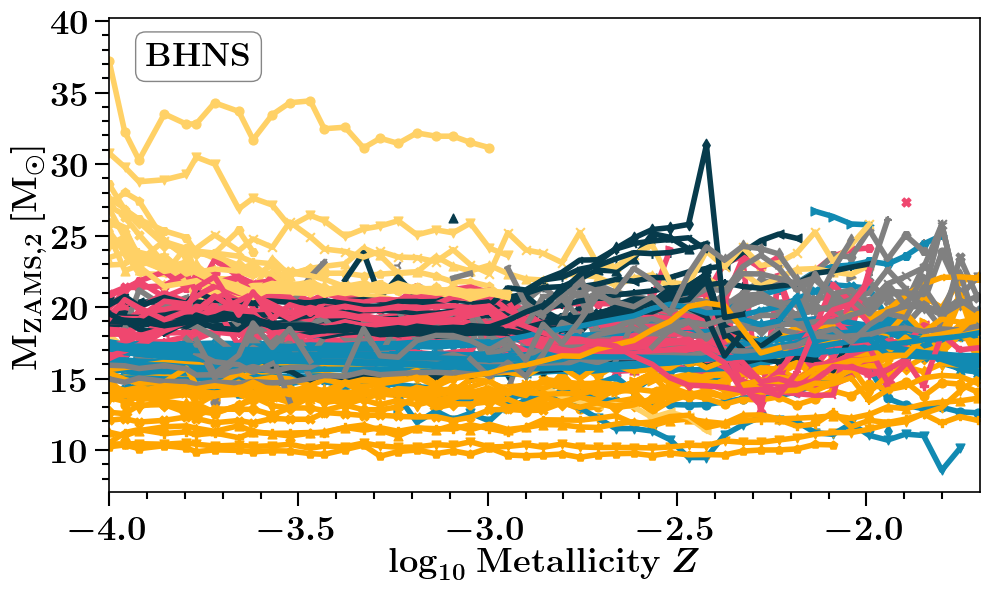


at DCOtype = BNS
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'immediate CE', 'double-core CE', 'other']
running for channels ['classic', 'stable B no CEE', 'vii', 'imme

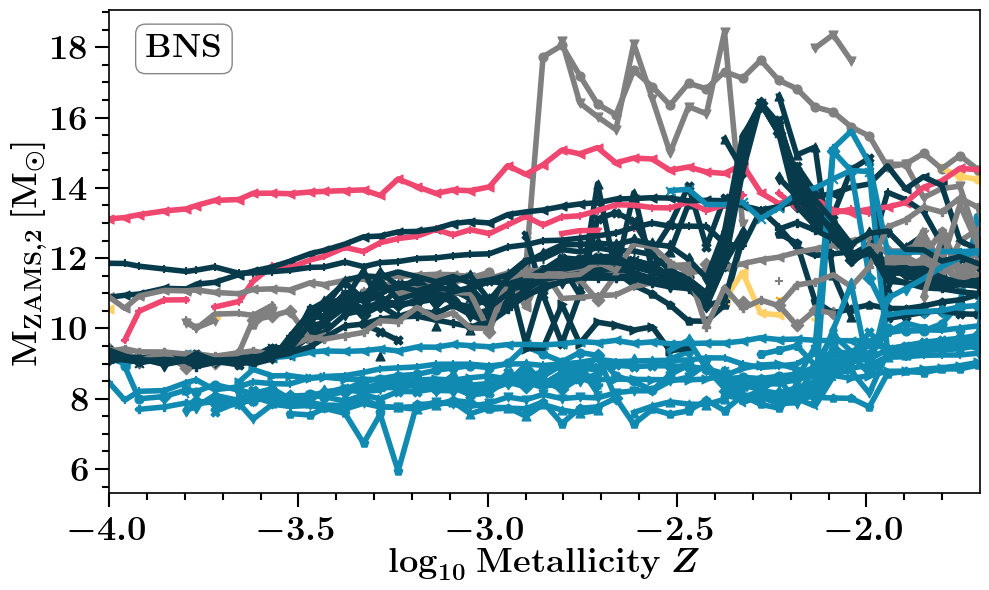

In [7]:
! pwd

/Users/floorbroekgaarden/Projects/GitHub/DCO_FormationChannels/plottingCode/Figure_Redshift_Rates


## ENDS HERE ## 
GO TO other jupyter notebook (in same folder) for the working/most recent version of code below (as z)

In [ ]:
def plot_total_quantiles_redshift(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', xparam='mass_tot', redshifts=[0],\
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                  c_FC=False, mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False, \
                                               weights_type='formation'):
    """
    whichplot='rate', 'ratio'
    
    """

    pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
    redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]

    
    
    for ind_m, BPSmodelName in  enumerate(BPSnameslist[0:]):
        print(BPSmodelName)
        color_m = colorDirDict[BPSmodelName]
    
        # path for files 
        full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

        # read in data 
        fdata = h5.File(full_data_path,'r')

        # get the delay time in Gyr 


        massCO_ZAMSM1 = fdata['doubleCompactObjects']['M1'][...].squeeze()
        massCO_ZAMSM2 = fdata['doubleCompactObjects']['M2'][...].squeeze()
        # M1 will be the most massive, M2 the least massive compact object. 
        massCO_LVKM1, massCO_LVKM2 = obtainM1BHandM2BHassymetric(m1=fdata['doubleCompactObjects']['M1'][...].squeeze(), m2=fdata['doubleCompactObjects']['M2'][...].squeeze()) 
        MassRatioCO_LVK = massCO_LVKM2/massCO_LVKM1

        if xparam=='chirp_mass_LVK':
            param_x = chirpmass(massCO_LVKM1, massCO_LVKM2)
            nameX = r'$\mathcal{M}_{\rm{c}} \ [M_{\odot}]$'
            nameY = r'\textbf{PDF}'
            xx = np.linspace(1,100,1000)
        elif xparam=='mass_tot':
            param_x = massCO_LVKM1 + massCO_LVKM2
            nameX = r'$\rm{M}_{\rm{tot}} \ [M_{\odot}]$'
            nameY = r'\textbf{PDF}'
            xx = np.linspace(1,5,1000)
        elif xparam=='mass_ratio_LVK':
            param_x = MassRatioCO_LVK
            nameX = r'$q$'
            nameY = r'\textbf{PDF}'
            xx = np.linspace(-0.2,1.2,1000)
        elif xparam=='mass_1_LVK':
            param_x = massCO_LVKM1
            nameX = r'$m_1 [M_{\odot}]$'
            nameY = r'\textbf{PDF}'
            if DCOtype=='BBH':
                xx = np.linspace(-1,150,1000) # needs to be a little bit larger
            elif DCOtype=='BHNS':
                xx = np.linspace(-1,50,1000)
            elif DCOtype=='BNS':
                xx = np.linspace(-2,5,500)
        elif xparam=='mass_2_LVK':
            param_x = massCO_LVKM2
            nameX = r'$m_2 [M_{\odot}]$'
            nameY = r'\textbf{PDF}'
            if DCOtype=='BBH':
                xx = np.linspace(-1,150,1000) # needs to be a little bit larger
            elif DCOtype=='BHNS':
                xx = np.linspace(-2,5,1000)
            elif DCOtype=='BNS':
                xx = np.linspace(-2,5,500)

        elif xparam=='log10_t_delay':
            param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
            param_x = np.log10(param_x)
            nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
            nameY = r'\textbf{PDF}'  
            xx = np.linspace(-2.5,2,500)  
            print('obtained params')
        elif xparam=='log10_t_delay':
            param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
            param_x = np.log10(param_x)
            nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
            nameY = r'\textbf{PDF}'  
            xx = np.linspace(-2.5,2,500)  
            print('obtained params')    

        elif xparam=='t_delay':
            param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
            nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
            nameY = r'\textbf{PDF}'  
            xx = np.linspace(-2.5,2,500)     


        channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()


        print('obtained params')   

        for ind_mssfr, mssfr in enumerate(MSSFRnameslist[1:]):

            median_at_redshifts = np.zeros_like(redshifts_runs)

            for z_ind, redshift in enumerate(redshifts_runs[0:]):
                redshift = np.round(redshift,4)

                if weights_type=='merger':
                    fparam_key = 'weights_intrinsicPerRedshift'
                    weightheader = 'w_' + mssfr + '_z_' +  str(redshift)
                    weights_ = fdata[fparam_key][weightheader][...].squeeze()
                elif weights_type=='formation':
                    fparam_key = "weights_intrinsicFormationPerRedshift"
                    weightheader = 'wform_' + mssfr + '_z_' +  str(redshift)
                    weights_ = fdata[fparam_key][weightheader][...].squeeze()



                if whichQuantity=='median':
                    median_at_redshifts[z_ind] = weighted_quantile(values=param_x, quantiles=[0.5], sample_weight=weights_)
                    nameY = r'$<t_{\rm{delay}}> \ [\rm{Gyr}]$'
                elif whichQuantity=='fraction':
                    mask_systems = param_x <= value_for_fraction
                    median_at_redshifts[z_ind] = np.sum(weights_[mask_systems])/np.sum(weights_)
                    nameY = r'$\rm{fraction }  t_{\rm{delay}} < %s \ [\rm{Gyr}]$'%value_for_fraction


            axe.scatter(redshifts[:], median_at_redshifts, color=color_m, marker=dictMarkerShape[BPSmodelName])
            axe.plot(redshifts[:],    median_at_redshifts, color=color_m) #, ls=linestyles_mssfrind[ind_mssfr_zind])



        
        
        # always close the dataset
        fdata.close()


        
        
    xlabel = r'\textbf{redshift} $z$'
    ylabel = nameX
    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)

    
    axe.set_xlim(0,9.6)
    if whichQuantity=='fraction':
        axe.set_ylim(0., 1)
    
    #axe.set_ylim(2,3.8)
#     else:
#         axe.set_ylim(1, 1E4)
    if whichQuantity=='median':
        if xparam in ['t_delay']:
            axe.set_yscale('log')
    
    
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'\textbf{model %s:}'%(BPSmodelName) +'\n' + alphabetPhysicalNameDict[BPSmodelName], xy=(0.042, .95),\
                 xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
                zorder=1E10)

    return axe




In [ ]:
# plot delay times with fraction 

weights_type='formation'
whichQuantity='median'
xparam = 't_delay' #'mass_tot'


for DCOtype in [ 'BNS']:
    print()
    print('at DCOtype =', DCOtype)


    ncols, nrows= 1,1
    f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                  gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



    ax = plot_total_quantiles_redshift(axe=ax, DCOtype=DCOtype, xparam=xparam, BPSmodelName=BPSmodelName,\
                                                          redshifts=redshifts_runs, pathData=pathData,\
                                                        c_FC=color_m, mask_specific_mssfr='x',\
                                                     whichQuantity=whichQuantity, value_for_fraction=0.1,\
                                                    weights_type=weights_type) 


    ##  SAVE FIG  ###
    plt.tight_layout()
    plt.subplots_adjust(wspace=0., hspace=0.18)  
    plt.savefig('./formation_median/'+xparam+'/'+xparam+'_total_ratesz_' +  DCOtype + '_' + weights_type + '_' + whichQuantity + '.png', transparent=False)
    plt.savefig('./formation_median/'+xparam+'/'+xparam+'_total_ratesz_' +  DCOtype + '_' + weights_type + '_' + whichQuantity + '.pdf', transparent=True)
    plt.show()
    plt.close()

                    
                    

In [ ]:
def plot_formation_channels_quantiles_redshift(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', xparam='mass_tot', redshifts=[0],\
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                  c_FC=False, mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False, \
                                               weights_type='formation'):
    """
    whichplot='rate', 'ratio'
    
    """

    pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
    redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

    # read in data 
    fdata = h5.File(full_data_path,'r')
    
    # get the delay time in Gyr 
    

    massCO_ZAMSM1 = fdata['doubleCompactObjects']['M1'][...].squeeze()
    massCO_ZAMSM2 = fdata['doubleCompactObjects']['M2'][...].squeeze()
    # M1 will be the most massive, M2 the least massive compact object. 
    massCO_LVKM1, massCO_LVKM2 = obtainM1BHandM2BHassymetric(m1=fdata['doubleCompactObjects']['M1'][...].squeeze(), m2=fdata['doubleCompactObjects']['M2'][...].squeeze()) 
    MassRatioCO_LVK = massCO_LVKM2/massCO_LVKM1

    if xparam=='chirp_mass_LVK':
        param_x = chirpmass(massCO_LVKM1, massCO_LVKM2)
        nameX = r'$\mathcal{M}_{\rm{c}} \ [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        xx = np.linspace(1,100,1000)
    elif xparam=='mass_tot':
        param_x = massCO_LVKM1 + massCO_LVKM2
        nameX = r'$\rm{M}_{\rm{tot}} \ [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        xx = np.linspace(1,5,1000)
    elif xparam=='mass_ratio_LVK':
        param_x = MassRatioCO_LVK
        nameX = r'$q$'
        nameY = r'\textbf{PDF}'
        xx = np.linspace(-0.2,1.2,1000)
    elif xparam=='mass_1_LVK':
        param_x = massCO_LVKM1
        nameX = r'$m_1 [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        if DCOtype=='BBH':
            xx = np.linspace(-1,150,1000) # needs to be a little bit larger
        elif DCOtype=='BHNS':
            xx = np.linspace(-1,50,1000)
        elif DCOtype=='BNS':
            xx = np.linspace(-2,5,500)
    elif xparam=='mass_2_LVK':
        param_x = massCO_LVKM2
        nameX = r'$m_2 [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        if DCOtype=='BBH':
            xx = np.linspace(-1,150,1000) # needs to be a little bit larger
        elif DCOtype=='BHNS':
            xx = np.linspace(-2,5,1000)
        elif DCOtype=='BNS':
            xx = np.linspace(-2,5,500)
            
    elif xparam=='log10_t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
        param_x = np.log10(param_x)
        nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
        nameY = r'\textbf{PDF}'  
        xx = np.linspace(-2.5,2,500)  
        print('obtained params')
    elif xparam=='log10_t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
        param_x = np.log10(param_x)
        nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
        nameY = r'\textbf{PDF}'  
        xx = np.linspace(-2.5,2,500)  
        print('obtained params')    
    
    elif xparam=='t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
        nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
        nameY = r'\textbf{PDF}'  
        xx = np.linspace(-2.5,2,500)     
    
    
    channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()
    
    #     param_x = np.log10(param_x)
    
#     nameY = r'\textbf{PDF}'  
#     xx = np.linspace(1,100,500)  
    print('obtained params')   
    
    
    
    for nrC, Channel in enumerate(adjustedChannelList): 
#         print('now at channel: ', Channel)
        ind_wanted = dictFormationChannelIndex[Channel]
        # set color         
        c_FC = channelColorDict[Channel]
        colors_lighter_FC =  channelColorDict_lighter[Channel]


        mask_MRR = (channels==ind_wanted)
        
    
        if np.sum(mask_MRR)>10:
            ######## EXTRA FLUFF JUST FOR PLOTTING SOME MSSFR, NOT THE BEST CODE
        #     if mask_specific_mssfr==None:
        #     for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:]):
            for ind_mssfr, mssfr in enumerate(MSSFRnameslist[0:]):

                median_at_redshifts = np.zeros_like(redshifts_runs)

                for z_ind, redshift in enumerate(redshifts_runs[0:]):
                    redshift = np.round(redshift,4)
                    
                    if weights_type=='merger':
                        fparam_key = 'weights_intrinsicPerRedshift'
                        weightheader = 'w_' + mssfr + '_z_' +  str(redshift)
                        weights_ = fdata[fparam_key][weightheader][...].squeeze()
                    elif weights_type=='formation':
                        fparam_key = "weights_intrinsicFormationPerRedshift"
                        weightheader = 'wform_' + mssfr + '_z_' +  str(redshift)
                        weights_ = fdata[fparam_key][weightheader][...].squeeze()
                    
                
#                     fparam_key = "weights_intrinsicFormationPerRedshift"
# #                     fparam_key = 'weights_intrinsicPerRedshift'
#                     weightheader = 'wform_' + mssfr + '_z_' +  str(redshift)
#                     weights_ = fdata[fparam_key][weightheader][...].squeeze()



                    if whichQuantity=='median':
                        median_at_redshifts[z_ind] = weighted_quantile(values=param_x[mask_MRR], quantiles=[0.5], sample_weight=weights_[mask_MRR])
                        nameY = r'$<t_{\rm{delay}}> \ [\rm{Gyr}]$'
                    elif whichQuantity=='fraction':
                        mask_systems = param_x[mask_MRR] <= value_for_fraction
                        median_at_redshifts[z_ind] = np.sum(weights_[mask_MRR][mask_systems])/np.sum(weights_[mask_MRR])
                        nameY = r'$\rm{fraction }  t_{\rm{delay}} < %s \ [\rm{Gyr}]$'%value_for_fraction
                        

                axe.scatter(redshifts[:], median_at_redshifts, color=c_FC, marker=dictMarkerShape[BPSmodelName])
                axe.plot(redshifts[:],    median_at_redshifts, color=c_FC) #, ls=linestyles_mssfrind[ind_mssfr_zind])



        
        
    # always close the dataset
    fdata.close()




#     ylabel = r'\textbf{Rate}'
        
        
    xlabel = r'\textbf{redshift} $z$'
    ylabel = nameX
    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)

    
    axe.set_xlim(0,9.6)
    if whichQuantity=='fraction':
        axe.set_ylim(0., 1)
    if xparam in ['mass_tot']:
        axe.set_ylim(2, 4)
#     else:
#         axe.set_ylim(1, 1E4)
    if whichQuantity=='median':
        if xparam in ['t_delay']:
            axe.set_yscale('log')
    
    
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'\textbf{model %s:}'%(BPSmodelName) +'\n' + alphabetPhysicalNameDict[BPSmodelName], xy=(0.042, .95),\
                 xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
                zorder=1E10)

    return axe




In [ ]:
# ! mkdir ./formation_median/mass_tot

In [ ]:
# plot delay times with fraction 

weights_type='formation'
whichQuantity='median'
xparam = 'mass_tot'

# for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
for ind_m, BPSmodelName in  enumerate(BPSnameslist[0:]):
    color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)

    for DCOtype in [ 'BNS']:
        print()
        print('at DCOtype =', DCOtype)
    #     for nrC, Channel in enumerate(adjustedChannelList): 
    #     for nrC, Channel in enumerate([adjustedChannelList[0]]): 
    #         print('now at Channel', Channel)

        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



        ax = plot_formation_channels_quantiles_redshift(axe=ax, DCOtype=DCOtype, xparam=xparam, BPSmodelName=BPSmodelName,\
                                                              redshifts=redshifts_runs, pathData=pathData,\
                                                            c_FC=color_m, mask_specific_mssfr='x',\
                                                         whichQuantity=whichQuantity, value_for_fraction=0.1,\
                                                        weights_type=weights_type) 


        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
        plt.savefig('./formation_median/'+xparam+'/'+xparam+'_ratesz_' +  DCOtype + '_' + BPSmodelName + '_' + weights_type + '_' + whichQuantity + '.png', transparent=False)
        plt.savefig('./formation_median/'+xparam+'/'+xparam+'_ratesz_' +  DCOtype + '_' + BPSmodelName + '_' + weights_type + '_' + whichQuantity + '.pdf', transparent=True)
        plt.show()
        plt.close()

                    
                    

# as a function of metallicity 

In [ ]:
def plot_formation_channels_metallicity_xparam(axe='None', DCOtype='BHNS', \
                                          xparam='mass_tot', BPSmodelName='A', 
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False):
    """
    whichplot='rate', 'ratio'
    
    """

    pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
    redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
    adjustedChannelList = ['classic', 'stable B no CEE'] #, 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

    # read in data 
    fdata = h5.File(full_data_path,'r')
    
    # get the delay time in Gyr 
#     param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
    
    
    massCO_ZAMSM1 = fdata['doubleCompactObjects']['M1'][...].squeeze()
    massCO_ZAMSM2 = fdata['doubleCompactObjects']['M2'][...].squeeze()
    # M1 will be the most massive, M2 the least massive compact object. 
    massCO_LVKM1, massCO_LVKM2 = obtainM1BHandM2BHassymetric(m1=fdata['doubleCompactObjects']['M1'][...].squeeze(), m2=fdata['doubleCompactObjects']['M2'][...].squeeze()) 
    MassRatioCO_LVK = massCO_LVKM2/massCO_LVKM1

    if xparam=='chirp_mass_LVK':
        param_x = chirpmass(massCO_LVKM1, massCO_LVKM2)
        nameX = r'$\mathcal{M}_{\rm{c}} \ [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        xx = np.linspace(1,100,1000)
    elif xparam=='mass_tot':
        param_x = massCO_LVKM1 + massCO_LVKM2
        nameX = r'$\rm{M}_{\rm{tot}} \ [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        xx = np.linspace(1,5,1000)
    elif xparam=='mass_ratio_LVK':
        param_x = MassRatioCO_LVK
        nameX = r'$q$'
        nameY = r'\textbf{PDF}'
        xx = np.linspace(-0.2,1.2,1000)
    elif xparam=='mass_1_LVK':
        param_x = massCO_LVKM1
        nameX = r'$m_1 [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        if DCOtype=='BBH':
            xx = np.linspace(-1,150,1000) # needs to be a little bit larger
        elif DCOtype=='BHNS':
            xx = np.linspace(-1,50,1000)
        elif DCOtype=='BNS':
            xx = np.linspace(-2,5,500)
    elif xparam=='mass_2_LVK':
        param_x = massCO_LVKM2
        nameX = r'$m_2 [M_{\odot}]$'
        nameY = r'\textbf{PDF}'
        if DCOtype=='BBH':
            xx = np.linspace(-1,150,1000) # needs to be a little bit larger
        elif DCOtype=='BHNS':
            xx = np.linspace(-2,5,1000)
        elif DCOtype=='BNS':
            xx = np.linspace(-2,5,500)
            
    elif xparam=='log10_t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
        param_x = np.log10(param_x)
        nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
        nameY = r'\textbf{PDF}'  
        xx = np.linspace(-2.5,2,500)  
        print('obtained params')
    elif xparam=='log10_t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
        param_x = np.log10(param_x)
        nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
        nameY = r'\textbf{PDF}'  
        xx = np.linspace(-2.5,2,500)  
        print('obtained params')    
    
    elif xparam=='t_delay':
        param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
        nameX = r'$\log_{10} t_{\rm{delay}} \ [\rm{Gyr}]$'
        nameY = r'\textbf{PDF}'  
        xx = np.linspace(-2.5,2,500)         
    
    

    
    channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()
    metallicities = fdata['doubleCompactObjects']['Metallicity1'][...].squeeze()
    weights_ =  fdata['doubleCompactObjects']['weight'][...].squeeze()
    #     param_x = np.log10(param_x)
    

    
    
    for nrC, Channel in enumerate(adjustedChannelList): 
#         print('now at channel: ', Channel)
        ind_wanted = dictFormationChannelIndex[Channel]
        # set color         
        c_FC = channelColorDict[Channel]
        colors_lighter_FC =  channelColorDict_lighter[Channel]


        mask_MRR = (channels==ind_wanted)
        
        
        
        median_at_ZZ = np.zeros_like(np.unique(metallicities))
        
    #     for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:]):
        for ind_Z, Zvalue in enumerate(np.unique(metallicities)):

            mask_ZZ = metallicities[mask_MRR]==Zvalue

            
            
            if len(weights_[mask_MRR][mask_ZZ])>10:
            ######## EXTRA FLUFF JUST FOR PLOTTING SOME MSSFR, NOT THE BEST CODE



                if whichQuantity=='median':
                    median_at_ZZ[ind_Z] = weighted_quantile(values=param_x[mask_MRR][mask_ZZ], quantiles=[0.5], sample_weight=weights_[mask_MRR][mask_ZZ])
                    nameY = r'$<t_{\rm{delay}}> \ [\rm{Gyr}]$'
                elif whichQuantity=='fraction':
                    mask_systems = param_x[mask_MRR][mask_ZZ] <= value_for_fraction
                    median_at_ZZ[ind_Z] = np.sum(weights_[mask_MRR][mask_ZZ][mask_systems])/np.sum(weights_[mask_MRR][mask_ZZ])
                    nameY = r'$\rm{fraction }  t_{\rm{delay}} < %s \ [\rm{Gyr}]$'%value_for_fraction
                        
        mask_not_zero = (median_at_ZZ!=0)
        axe.scatter(np.log10(np.unique(metallicities))[mask_not_zero], median_at_ZZ[mask_not_zero], color=c_FC, marker=dictMarkerShape[BPSmodelName])
        axe.plot(np.log10(np.unique(metallicities))[mask_not_zero],    median_at_ZZ[mask_not_zero], color=c_FC) #, ls=linestyles_mssfrind[ind_mssfr_zind])



        
        
    # always close the dataset
    fdata.close()




    
        




#     ylabel = r'\textbf{Rate}'
        
        
    xlabel = r'\textbf{Metallicity} \ $Z$'
    ylabel = nameX
    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)

    
#     axe.set_xlim(0.001,0.3)
    if whichQuantity=='fraction':
        axe.set_ylim(0., 1)

    if xparam in ['mass_tot']:
        axe.set_ylim(2, 4)        

        
#         axe.set_ylim(1, 1E4)
    if whichQuantity=='median':
        if xparam in ['t_delay']:
            axe.set_yscale('log')
            axe.set_ylim(0.001, 2)
    
    
    
#     axe.set_xscale('log')
    
    
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'\textbf{model %s:}'%(BPSmodelName) +'\n' + alphabetPhysicalNameDict[BPSmodelName], xy=(0.042, .95),\
                 xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
                zorder=1E10)

    return axe




# plot delay times with fraction 




whichQuantity='median'
xparam = 't_delay'

# for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
#     color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)

    for DCOtype in ['BNS']:
        print()
        print('at DCOtype =', DCOtype)
    #     for nrC, Channel in enumerate(adjustedChannelList): 
    #     for nrC, Channel in enumerate([adjustedChannelList[0]]): 
    #         print('now at Channel', Channel)

        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



        ax = plot_formation_channels_metallicity_xparam(axe=ax, DCOtype=DCOtype, xparam=xparam, BPSmodelName=BPSmodelName,\
                                                              pathData=pathData,\
                                                            mask_specific_mssfr=None,\
                                                         whichQuantity=whichQuantity, value_for_fraction=False) 



        
        
        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
        plt.savefig('./formation_median/'+xparam+'/'+xparam+'_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.png', transparent=False, dpi=300)
        plt.savefig('./formation_median/'+xparam+'/'+xparam+'_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.pdf', transparent=True)
        plt.show()
        plt.close()

                    
                    



# WORKING CODE 

In [ ]:
def plot_formation_channels_redshift_rate_mssfr(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', redshifts=[0],\
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                  c_FC=False, mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False, \
                                               weights_type='formation'):
    """
    whichplot='rate', 'ratio'
    
    """

    pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
    redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

    # read in data 
    fdata = h5.File(full_data_path,'r')
    
    # get the delay time in Gyr 
    
    
    param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
    channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()
    
    #     param_x = np.log10(param_x)
    
#     nameY = r'\textbf{PDF}'  
    xx = np.linspace(1,100,500)  
    print('obtained params')   
    
    
    
    for nrC, Channel in enumerate(adjustedChannelList): 
#         print('now at channel: ', Channel)
        ind_wanted = dictFormationChannelIndex[Channel]
        # set color         
        c_FC = channelColorDict[Channel]
        colors_lighter_FC =  channelColorDict_lighter[Channel]


        mask_MRR = (channels==ind_wanted)
        
    
        if np.sum(mask_MRR)>10:
            ######## EXTRA FLUFF JUST FOR PLOTTING SOME MSSFR, NOT THE BEST CODE
        #     if mask_specific_mssfr==None:
        #     for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:]):
            for ind_mssfr, mssfr in enumerate(MSSFRnameslist[0:]):
                print(mssfr)

                median_at_redshifts = np.zeros_like(redshifts_runs)

                for z_ind, redshift in enumerate(redshifts_runs[0:]):
                    redshift = np.round(redshift,4)
                    
                    if weights_type=='merger':
                        fparam_key = 'weights_intrinsicPerRedshift'
                        weightheader = 'w_' + mssfr + '_z_' +  str(redshift)
                        weights_ = fdata[fparam_key][weightheader][...].squeeze()
                    elif weights_type=='formation':
                        fparam_key = "weights_intrinsicFormationPerRedshift"
                        weightheader = 'wform_' + mssfr + '_z_' +  str(redshift)
                        weights_ = fdata[fparam_key][weightheader][...].squeeze()
                    
                
#                     fparam_key = "weights_intrinsicFormationPerRedshift"
# #                     fparam_key = 'weights_intrinsicPerRedshift'
#                     weightheader = 'wform_' + mssfr + '_z_' +  str(redshift)
#                     weights_ = fdata[fparam_key][weightheader][...].squeeze()



                    if whichQuantity=='median':
                        median_at_redshifts[z_ind] = weighted_quantile(values=param_x[mask_MRR], quantiles=[0.5], sample_weight=weights_[mask_MRR])
                        nameY = r'$<t_{\rm{delay}}> \ [\rm{Gyr}]$'
                    elif whichQuantity=='fraction':
                        mask_systems = param_x[mask_MRR] <= value_for_fraction
                        median_at_redshifts[z_ind] = np.sum(weights_[mask_MRR][mask_systems])/np.sum(weights_[mask_MRR])
                        nameY = r'$\rm{fraction }  t_{\rm{delay}} < %s \ [\rm{Gyr}]$'%value_for_fraction
                        

                axe.scatter(redshifts[:], median_at_redshifts, color=c_FC, marker=dictMarkerShape[BPSmodelName])
                axe.plot(redshifts[:],    median_at_redshifts, color=c_FC) #, ls=linestyles_mssfrind[ind_mssfr_zind])



        
        
    # always close the dataset
    fdata.close()




    
        




#     ylabel = r'\textbf{Rate}'
        
    nameY = r'$<t_{\rm{delay}}> \ [\rm{Gyr}]$'    
    xlabel = r'\textbf{redshift} $z$'
    ylabel = nameY
    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)

    
    axe.set_xlim(0,9.6)
    if whichQuantity=='fraction':
        axe.set_ylim(0., 1)
#     else:
#         axe.set_ylim(1, 1E4)
    if whichQuantity=='median':
        axe.set_yscale('log')
    
    
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'\textbf{model %s:}'%(BPSmodelName) +'\n' + alphabetPhysicalNameDict[BPSmodelName], xy=(0.042, .95),\
                 xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
                zorder=1E10)

    return axe




In [ ]:
# plot delay times with fraction 



weights_type='formation'
whichQuantity='median'

# for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
for ind_m, BPSmodelName in  enumerate(BPSnameslist[5:]):
    color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)

    for DCOtype in [ 'BHNS', 'BBH']:
        print()
        print('at DCOtype =', DCOtype)
    #     for nrC, Channel in enumerate(adjustedChannelList): 
    #     for nrC, Channel in enumerate([adjustedChannelList[0]]): 
    #         print('now at Channel', Channel)

        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



        ax = plot_formation_channels_redshift_rate_mssfr(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName,\
                                                              redshifts=redshifts_runs, pathData=pathData,\
                                                            c_FC=color_m, mask_specific_mssfr='x',\
                                                         whichQuantity=whichQuantity, value_for_fraction=0.1,\
                                                        weights_type=weights_type) 


        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
        plt.savefig('./formation_median/delay_time/delay_time_ratesz_' +  DCOtype + '_' + BPSmodelName + '_' + weights_type + '_' + whichQuantity + '.png', transparent=False)
        plt.savefig('./formation_median/delay_time/delay_time_ratesz_' +  DCOtype + '_' + BPSmodelName + '_' + weights_type + '_' + whichQuantity + '.pdf', transparent=True)
        plt.show()
        plt.close()

                    
                    

In [ ]:
# for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
for ind_m, BPSmodelName in  enumerate(BPSnameslist):
    color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)

    for DCOtype in [ 'BNS']:
        print()
        print('at DCOtype =', DCOtype)
    #     for nrC, Channel in enumerate(adjustedChannelList): 
    #     for nrC, Channel in enumerate([adjustedChannelList[0]]): 
    #         print('now at Channel', Channel)

        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



        ax = plot_formation_channels_redshift_rate_mssfr(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName,\
                                                              redshifts=redshifts_runs, pathData=pathData,\
                                                            c_FC=color_m, mask_specific_mssfr='x', whichRate='channeltotal') 


        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
        plt.savefig('./formation_median/delay_time/delay_time_ratesz_' +  DCOtype + '_' + BPSmodelName + '.png', transparent=False)
        plt.savefig('./formation_median/delay_time/delay_time_ratesz_' +  DCOtype + '_' + BPSmodelName + '.pdf', transparent=False)
        plt.show()
        plt.close()


In [ ]:
DCOtype='BNS'



pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
DCOname = DCOname_dict[DCOtype]





for ind_bps, BPSmodelName in enumerate(BPSnameslist):
    
    ncols, nrows= 1,1
    f, axe= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                  gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    fdata = h5.File(full_data_path,'r')

    # get the redshifts
    redshifts = redshifts_runs


    for ind_mssfr, mssfr in enumerate([MSSFRnameslist[1]]):
#     for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:2]):
        print('mssfr', mssfr)

        rates_at_redshifts = np.zeros_like(redshifts_runs)
        rates_at_redshifts_form = np.zeros_like(redshifts_runs)


        for z_ind, redshift in enumerate(redshifts_runs[0:]):
            print(redshift)
            redshift = np.round(redshift,4)
            fparam_key = "weights_intrinsicFormationPerRedshift"

            weightheader = 'wform_' + mssfr + '_z_' +  str(redshift)
            weights_form = fdata[fparam_key][weightheader][...].squeeze()

            fparam_key = 'weights_intrinsicPerRedshift'
            weightheader = 'w_' + mssfr + '_z_' +  str(redshift)
            weights_ = fdata[fparam_key][weightheader][...].squeeze()

            rates_at_redshifts[z_ind] = np.sum(weights_)
            rates_at_redshifts_form[z_ind] = np.sum(weights_form)

        axe.scatter(redshifts[:], rates_at_redshifts, color='blue')
        axe.plot(redshifts[:],    rates_at_redshifts, color='blue') #, ls=linestyles_mssfrind[ind_mssfr_zind])

        axe.scatter(redshifts[:], rates_at_redshifts_form, color='orange')
        axe.plot(redshifts[:],    rates_at_redshifts_form, color='orange') #, ls=linestyles_mssfrind[ind_mssfr_zind])

        
        
        
        
    axe.set_yscale('log')
        
    plt.show()
    fdata.close()


In [ ]:
fdata.close()

In [ ]:
DCOtype='BNS'



pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
DCOname = DCOname_dict[DCOtype]


for BPSmodelName in BPSnameslist[0:3]:


    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    # read in data 
    fdata = h5.File(full_data_path,'r')
    print()
    print('BPS ' , BPSmodelName)
    
    
    print(fdata['weights_intrinsicFormationPerRedshift'].keys())

    fdata.close()







In [ ]:
MassEvolved = [77598406.21327497, 77598095.82151248, 77598483.8112156, 77598018.22357185
, 77598328.61533435, 77598483.8112156, 77598483.8112156, 77598018.22357185
, 77598095.82151248, 77598483.8112156, 77598561.40915622, 77598173.4194531
, 77598328.61533435, 77598561.40915622, 77598483.8112156, 77598406.21327497
, 77598095.82151248, 77598018.22357185, 77598406.21327497, 77598639.00709686
, 77598639.00709686, 77598406.21327497, 77598639.00709686, 77598483.8112156
, 77598483.8112156, 77598095.82151248, 77598251.01739372, 77598483.8112156
, 77598483.8112156, 77598251.01739372, 77598173.4194531, 77597940.62563121
, 77598251.01739372, 77598483.8112156, 77598095.82151248, 77598561.40915622
, 77598173.4194531, 77598328.61533435, 77598561.40915622, 77598406.21327497
, 77598173.4194531, 77598406.21327497, 77598173.4194531, 77598251.01739372
, 77598173.4194531, 77598095.82151248, 77597940.62563121, 77598095.82151248
, 77598406.21327497, 77598561.40915622, 77598639.00709686, 77598173.4194531
, 77598095.82151248]

print(np.mean(MassEvolved))
print(np.median(MassEvolved))

In [ ]:
xx = np.linspace(0,1,10000)

quantiles = weighted_quantile(values=xx, quantiles=[0.5, 0.25, 0.75])
print(quantiles)

In [ ]:


quantiles=[0.5, 0.25, 0.75]
metallicities = np.asarray([0.1, 0.8, 0.3, 0.4])
# del empty_data

print(df)

In [ ]:

A = np.zeros((4, 1))
print(A)
print(A[:,0])
A[:,0] = metallicities
print(A)

In [ ]:
A = np.zeros((3,4))
A[:] = np.nan
print(A)

print(A[0])

## Plot median delay times as a function of metallicity

In [ ]:









def plot_formation_channels_metallicity_xparam_for_quantiles(axe='None', DCOtype='BHNS', BPSmodelNameList=['A'], 
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False, \
                                              add_model_label=True, quantile_values=[0.5, 0.25, 0.75]):
    
    
    for BPSmodelName in enumerate(BPSmodelNameList):
        df = create_pd_metallicity_xparam(quantile_values=quantile_values, BPSmodelName=BPSmodelName, DCOtype=DCOtype)
        metallicities = df["metallicity"]
        
        # plot the channel 
        for nrC, Channel in enumerate(adjustedChannelList): 
            c_FC = channelColorDict[Channel]
            colors_lighter_FC =  channelColorDict_lighter[Channel]
            
            column_names = [Channel + ' q_' + str(quantile_values[i]) for i in range(len(quantile_values))] # creates array with header names 
            qvalues = [df[column_names[i]] for i in range(len(quantile_values))]
            
            axe.scatter(np.log10(metallicities), qvalues[0], color=c_FC, marker=dictMarkerShape[BPSmodelName])
            axe.plot(   np.log10(metallicities), qvalues[0], color=c_FC) #, ls=linestyles_mssfrind[ind_mssfr_zind])

            
    return axe


###
quantile_values=[0.5, 0.25, 0.75]
DCOTypeList = ['BHNS']
whichQuantity = 'median'
###

for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
#     color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)
    BPSmodelNameList=[BPSmodelName_temp]
    for DCOtype in DCOTypeList: #'BNS', 'BHNS', 
        print()
        print('at DCOtype =', DCOtype)


        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



        ax = plot_formation_channels_metallicity_xparam_for_quantiles(axe=ax, DCOtype=DCOtype, BPSmodelNameList=BPSmodelNameList,\
                                                              pathData=pathData,\
                                                            mask_specific_mssfr=None,\
                                                         whichQuantity=whichQuantity, value_for_fraction=False, add_model_label=True, quantile_values=quantile_values) 



        
        
        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
        plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.png', transparent=False, dpi=300)
        plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.pdf', transparent=True)
        plt.show()
        plt.close()



## I am working here :) 

In [ ]:
def plot_formation_channels_metallicity_xparam(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', 
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                mask_specific_mssfr=None,\
                                                whichQuantity='median', value_for_fraction=False, \
                                              add_model_label=True):
    """
    whichplot='rate', 'ratio'
    
    """

    pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
    redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run     
    adjustedChannelList = ['classic', 'stable B no CEE'] #, 'vii', 'immediate CE',  r'double-core CE', 'other'
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

    # read in data 
    fdata = h5.File(full_data_path,'r')
    
    # get the delay time in Gyr 
    param_x = (fdata['doubleCompactObjects']['tform'][...].squeeze() +  fdata['doubleCompactObjects']['tc'][...].squeeze() ) / 1000 # divide by 1000 to make it in [Gyr]
    channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()
    metallicities = fdata['doubleCompactObjects']['Metallicity1'][...].squeeze()
    weights_ =  fdata['doubleCompactObjects']['weight'][...].squeeze()
    #     param_x = np.log10(param_x)
    

    
    
    for nrC, Channel in enumerate(adjustedChannelList): 
#         print('now at channel: ', Channel)
        ind_wanted = dictFormationChannelIndex[Channel]
        # set color         
        c_FC = channelColorDict[Channel]
        colors_lighter_FC =  channelColorDict_lighter[Channel]


        mask_MRR = (channels==ind_wanted)
        
        
        
        median_at_ZZ = np.zeros_like(np.unique(metallicities))
        
    #     for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:]):
        for ind_Z, Zvalue in enumerate(np.unique(metallicities)):

            mask_ZZ = metallicities[mask_MRR]==Zvalue

            
            
            if len(weights_[mask_MRR][mask_ZZ])>10:
            ######## EXTRA FLUFF JUST FOR PLOTTING SOME MSSFR, NOT THE BEST CODE



                if whichQuantity=='median':
                    quantiles = weighted_quantile(values=param_x[mask_MRR][mask_ZZ], quantiles=[0.5, 0.25, 0.75], sample_weight=weights_[mask_MRR][mask_ZZ])
                    median_at_ZZ[ind_Z] = quantiles[0] # first requested value is the median
                    nameY = r'$<t_{\rm{delay}}> \ [\rm{Gyr}]$'
                elif whichQuantity=='fraction':
                    mask_systems = param_x[mask_MRR][mask_ZZ] <= value_for_fraction
                    median_at_ZZ[ind_Z] = np.sum(weights_[mask_MRR][mask_ZZ][mask_systems])/np.sum(weights_[mask_MRR][mask_ZZ])
                    nameY = r'$\rm{fraction }  t_{\rm{delay}} < %s \ [\rm{Gyr}]$'%value_for_fraction
                        

        axe.scatter(np.log10(np.unique(metallicities)), median_at_ZZ, color=c_FC, marker=dictMarkerShape[BPSmodelName])
        axe.plot(np.log10(np.unique(metallicities)),    median_at_ZZ, color=c_FC) #, ls=linestyles_mssfrind[ind_mssfr_zind])



        
        
    # always close the dataset
    fdata.close()




    
        




#     ylabel = r'\textbf{Rate}'
        
        
    xlabel = r'\textbf{Metallicity} \ $Z$'
    ylabel = nameY
    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)

    
#     axe.set_xlim(0.001,0.3)
    if whichQuantity=='fraction':
        axe.set_ylim(0., 1)
#     else:
#         axe.set_ylim(1, 1E4)
    if whichQuantity=='median':
        axe.set_yscale('log')
    
#     axe.set_xscale('log')
    
    if add_model_label==True:
        bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
        axe.annotate(r'\textbf{model %s:}'%(BPSmodelName) +'\n' + alphabetPhysicalNameDict[BPSmodelName], xy=(0.042, .95),\
                     xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props,\
                    zorder=1E10)

    return axe




In [ ]:
# plot delay times with fraction 




whichQuantity='median'

# for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
#     color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)

    for DCOtype in ['BBH']: #'BNS', 'BHNS', 
        print()
        print('at DCOtype =', DCOtype)
    #     for nrC, Channel in enumerate(adjustedChannelList): 
    #     for nrC, Channel in enumerate([adjustedChannelList[0]]): 
    #         print('now at Channel', Channel)

        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})



        ax = plot_formation_channels_metallicity_xparam(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName,\
                                                              pathData=pathData,\
                                                            mask_specific_mssfr=None,\
                                                         whichQuantity=whichQuantity, value_for_fraction=False, add_model_label=True) 



        
        
        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
        plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.png', transparent=False, dpi=300)
        plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + BPSmodelName + '_' + whichQuantity + '.pdf', transparent=True)
        plt.show()
        plt.close()

                    
                    

## all in one figure 

In [ ]:
whichQuantity='median'
ncols, nrows= 1,1
f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
              gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})
# for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
#     color_m = colorDirDict[BPSmodelName]
    print('at BPS model ', BPSmodelName)

    for DCOtype in ['BBH']: #'BNS', 'BHNS', 
        print()
        print('at DCOtype =', DCOtype)
    #     for nrC, Channel in enumerate(adjustedChannelList): 
    #     for nrC, Channel in enumerate([adjustedChannelList[0]]): 
    #         print('now at Channel', Channel)





        ax = plot_formation_channels_metallicity_xparam(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName,\
                                                              pathData=pathData,\
                                                            mask_specific_mssfr=None,\
                                                         whichQuantity=whichQuantity, value_for_fraction=False, add_model_label=False) 



        
        
##  SAVE FIG  ###
plt.tight_layout()
plt.subplots_adjust(wspace=0., hspace=0.18)  
plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + 'combi' + '_' + whichQuantity + '.png', transparent=False, dpi=300)
plt.savefig('./formation_median/delay_time/delay_time_ratesMetallicity_' +  DCOtype + '_' + 'combi' + '_' + whichQuantity + '.pdf', transparent=True)
plt.show()
plt.close()

In [ ]:
Change the above to include and go to zero if metallicity doesnt exist. 